In [50]:
#!pip install janome

import matplotlib.pyplot as plt
import pandas as pd
import torch
import random
from torch import nn, Tensor
import torch.nn.functional as F
#from torchtext.vocab import vocab
#import torchtext.transforms as T
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import numpy as np
import math
import janome
from janome.tokenizer import Tokenizer
#import spacy
from collections import Counter
from torch.utils.data.sampler import SubsetRandomSampler
import time
#from torchtext.vocab import build_vocab_from_iterator
import levenshtein
import json
import pickle
from timm.scheduler import CosineLRScheduler
from nltk import bleu_score

In [51]:
import json

token_list_path = "20240531_ntt_idx_to_wakati_auto.json"
with open( token_list_path, mode="r" , encoding="utf-8" ) as f:
    token_list = json.load( f )

token_list_en_path = "20240531_ntt_idx_to_word_auto.json"
with open( token_list_en_path, mode="r" , encoding="utf-8" ) as f:
    token_list_en = json.load( f )

idx_list_path = "20240531_ntt_wakati_to_idx_auto.json"
with open( idx_list_path, mode="r" , encoding="utf-8" ) as f:
    idx_list = json.load( f )

idx_list_en_path = "20240531_ntt_word_to_idx_auto.json"
with open( idx_list_en_path, mode="r" , encoding="utf-8" ) as f:
    idx_list_en = json.load( f )
    
enc_vocab_size, dec_vocab_size = len(token_list) - 1, len(token_list_en) - 1
print(enc_vocab_size, dec_vocab_size)

184855 181271


In [52]:
a = torch.tensor( [ 0,1,2,3,4,5,6 ])

b = [ token_list[str(i.item())] for i in a ]

print( b )


d = idx_list['<pad>']

print( d )

['<pad>', '<bos>', '<eos>', '<unk>', '鼻', '・', '口']
0


In [53]:
# -*- coding: utf-8 -*-

#
# Pytorchで用いるDatasetの定義
#

# PytorchのDatasetモジュールをインポート
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
import torch
import torch.nn.functional as F

# 数値演算用モジュール(numpy)をインポート
import numpy as np

# sysモジュールをインポート
import sys


class SequenceDataset(Dataset):
    ''' ミニバッチデータを作成するクラス
        torch.utils.data.Datasetクラスを継承し，
        以下の関数を定義する
        __len__: 総サンプル数を出力する関数
        __getitem__: 1サンプルのデータを出力する関数
    feat_scp:  特徴量リストファイル
    label_scp: ラベルファイル
    feat_mean: 特徴量の平均値ベクトル
    feat_std:  特徴量の次元毎の標準偏差を並べたベクトル 
    pad_index: バッチ化の際にフレーム数を合わせる
               ためにpaddingする整数値
    splice:    前後(splice)フレームを特徴量を結合する
               splice=1とすると，前後1フレーム分結合
               するので次元数は3倍になる．
               splice=0の場合は何もしない
    '''
    def __init__(self, 
                 filename,
                 pad_index_j=idx_list['<pad>'],
                 pad_index_e=idx_list_en['<pad>'],
                 ):

        # 特徴量リスト，ラベルを1行ずつ
        # 読み込みながら情報を取得する
        self.pad_index_j = pad_index_j
        self.pad_index_e = pad_index_e
        #self.ens = []
        self.en_list = []
        self.en_lens = []
        #self.jps = []
        self.jp_list = []
        self.jp_lens = []
        self.num_data = 0
        with open(filename, mode='r', encoding="utf-8") as file_f:
            for line in file_f:
                line = line.replace( "\n", "" )
                # 各行をスペースで区切り，
                # リスト型の変数にする
                #print( "line:", line)
                en = line.split("\t")[1]
                #self.ens.append( en )
                #self.ens = self.ens
                en1 = en.split( ' ' )
                self.en_list.append( en1 )
                self.en_lens.append( len( en1 ) )

                jp = line.split("\t")[0]
                #self.jps.append( jp )
                #self.jps = self.jps
                jp1 = jp.split( ' ' )
                self.jp_list.append( jp1 )
                self.jp_lens.append( len( jp1 ) )
                self.num_data += 1

        self.en_lens = np.int64( np.array( self.en_lens ) )
        self.jp_lens = np.int64( np.array( self.jp_lens ) )


        # フレーム数の最大値を得る
        self.max_en_len = np.max(self.en_lens)
        # ラベル長の最大値を得る
        self.max_jp_len = np.max(self.jp_lens)

        # ラベルデータの長さを最大フレーム長に
        # 合わせるため，pad_indexの値で埋める
        for n in range(self.num_data):
            print( "n:", n )
            # 埋めるフレームの数
            # = 最大フレーム数 - 自分のフレーム数
            pad_len = self.max_en_len \
                    - self.en_lens[n]
            # pad_indexの値で埋める
            #print("n:{}".format( n ) )
            #print("len of en_list:{}".format( len( self.en_list ) ) )
            tmp = self.en_list[n]
            self.en_list[n] = np.pad( tmp, (0, pad_len), mode='constant', constant_values=(self.pad_index_e, self.pad_index_e ))
            #print( self.en_list[n][0].dtype )
            #tmp = torch.tensor( self.en_list[n] )
            #tmp = F.pad( tmp, (0, pad_len), 'constant', self.pad_index_e )
            #self.en_list[n] = tmp.to('cpu').detach().numpy().copy()
            #print( self.en_list[n] )
            #tmp = torch.tensor( self.en_list[n] )
            #if torch.any( tmp == 5785 ):
            #    print( "tmp == 5785" )
            pad_len = self.max_jp_len \
                    - self.jp_lens[n]
            # pad_indexの値で埋める
            #print("n:{}".format( n ) )
            #print("len of en_list:{}".format( len( self.en_list ) ) )
            self.jp_list[n] = np.pad(self.jp_list[n],[0, pad_len],mode='constant', constant_values=self.pad_index_j)

        self.en_list = np.int64( np.array( self.en_list ) )
        self.jp_list = np.int64( np.array( self.jp_list ) )
        #print( self.jp_list )

        #max = np.max( self.jp_list, axis =1 )
        #maxmax = np.max( max )
        #print( "maxmax:{}".format(maxmax) )


    def __len__(self):
        ''' 学習データの総サンプル数を返す関数
        本実装では発話単位でバッチを作成するため，
        総サンプル数=発話数である．
        '''
        return self.num_data


    def __getitem__(self, idx):
        ''' サンプルデータを返す関数
        本実装では発話単位でバッチを作成するため，
        idx=発話番号である．
        '''
        # 特徴量系列のフレーム数
        jp_len = self.jp_lens[idx]
        # ラベルの長さ
        en_len = self.en_lens[idx]

        # ラベル
        jp = self.jp_list[idx]
        #print( jp )
        #jp = np.fromfile(self.jp_list[idx],dtype=np.int64)

        # 発話ID
        en = self.en_list[idx]
        #ens = np.fromfile(self.en_list[idx],dtype=np.float32)

        #batch = {}
        #batch['jp'] = jp
        #batch['en'] = en
        #batch['jp_len'] = jp_len
        #batch['en_len'] = en_len


        # 特徴量，ラベル，フレーム数，
        # ラベル長，発話IDを返す
        #return (jps, jp_lens, ens,  en_lens)
        return (jp, en, jp_len, en_len )

In [5]:
BATCH_SIZE = 20
batch_size = BATCH_SIZE

train_dataset = SequenceDataset( "20240531_ntt_ids_train_auto.txt", pad_index_j=idx_list['<pad>'], pad_index_e=idx_list_en['<pad>'] )
#train_dataset = SequenceDataset( "20240531_ntt_ids_dev_auto.txt", pad_index_j=idx_list['<pad>'], pad_index_e=idx_list_en['<pad>']  )
val_dataset = SequenceDataset( "20240531_ntt_ids_dev_auto.txt", pad_index_j=idx_list['<pad>'], pad_index_e=idx_list_en['<pad>']  )
    
# 訓練データのDataLoaderを呼び出す
# 訓練データはシャッフルして用いる
#  (num_workerは大きい程処理が速くなりますが，
#   PCに負担が出ます．PCのスペックに応じて
#   設定してください)

num_workers = 4 if torch.cuda.is_available() else 0

train_loader = DataLoader(train_dataset,
                            batch_size=batch_size,
                            shuffle=True,
                            num_workers=num_workers)
# 開発データのDataLoaderを呼び出す
# 開発データはデータはシャッフルしない
val_loader = DataLoader(val_dataset,
                        batch_size=batch_size,
                        shuffle=False,
                        num_workers=num_workers)

print( len( train_loader ))
print( len( val_loader ))


text, target, text_len, target_len = next(iter(train_loader))
print(text[0], target[0], text_len[0],target_len[0], sep="\n")

n: 0
n: 1
n: 2
n: 3
n: 4
n: 5
n: 6
n: 7
n: 8
n: 9
n: 10
n: 11
n: 12
n: 13
n: 14
n: 15
n: 16
n: 17
n: 18
n: 19
n: 20
n: 21
n: 22
n: 23
n: 24
n: 25
n: 26
n: 27
n: 28
n: 29
n: 30
n: 31
n: 32
n: 33
n: 34
n: 35
n: 36
n: 37
n: 38
n: 39
n: 40
n: 41
n: 42
n: 43
n: 44
n: 45
n: 46
n: 47
n: 48
n: 49
n: 50
n: 51
n: 52
n: 53
n: 54
n: 55
n: 56
n: 57
n: 58
n: 59
n: 60
n: 61
n: 62
n: 63
n: 64
n: 65
n: 66
n: 67
n: 68
n: 69
n: 70
n: 71
n: 72
n: 73
n: 74
n: 75
n: 76
n: 77
n: 78
n: 79
n: 80
n: 81
n: 82
n: 83
n: 84
n: 85
n: 86
n: 87
n: 88
n: 89
n: 90
n: 91
n: 92
n: 93
n: 94
n: 95
n: 96
n: 97
n: 98
n: 99
n: 100
n: 101
n: 102
n: 103
n: 104
n: 105
n: 106
n: 107
n: 108
n: 109
n: 110
n: 111
n: 112
n: 113
n: 114
n: 115
n: 116
n: 117
n: 118
n: 119
n: 120
n: 121
n: 122
n: 123
n: 124
n: 125
n: 126
n: 127
n: 128
n: 129
n: 130
n: 131
n: 132
n: 133
n: 134
n: 135
n: 136
n: 137
n: 138
n: 139
n: 140
n: 141
n: 142
n: 143
n: 144
n: 145
n: 146
n: 147
n: 148
n: 149
n: 150
n: 151
n: 152
n: 153
n: 154
n: 155
n: 156
n: 157
n: 1

n: 5117
n: 5118
n: 5119
n: 5120
n: 5121
n: 5122
n: 5123
n: 5124
n: 5125
n: 5126
n: 5127
n: 5128
n: 5129
n: 5130
n: 5131
n: 5132
n: 5133
n: 5134
n: 5135
n: 5136
n: 5137
n: 5138
n: 5139
n: 5140
n: 5141
n: 5142
n: 5143
n: 5144
n: 5145
n: 5146
n: 5147
n: 5148
n: 5149
n: 5150
n: 5151
n: 5152
n: 5153
n: 5154
n: 5155
n: 5156
n: 5157
n: 5158
n: 5159
n: 5160
n: 5161
n: 5162
n: 5163
n: 5164
n: 5165
n: 5166
n: 5167
n: 5168
n: 5169
n: 5170
n: 5171
n: 5172
n: 5173
n: 5174
n: 5175
n: 5176
n: 5177
n: 5178
n: 5179
n: 5180
n: 5181
n: 5182
n: 5183
n: 5184
n: 5185
n: 5186
n: 5187
n: 5188
n: 5189
n: 5190
n: 5191
n: 5192
n: 5193
n: 5194
n: 5195
n: 5196
n: 5197
n: 5198
n: 5199
n: 5200
n: 5201
n: 5202
n: 5203
n: 5204
n: 5205
n: 5206
n: 5207
n: 5208
n: 5209
n: 5210
n: 5211
n: 5212
n: 5213
n: 5214
n: 5215
n: 5216
n: 5217
n: 5218
n: 5219
n: 5220
n: 5221
n: 5222
n: 5223
n: 5224
n: 5225
n: 5226
n: 5227
n: 5228
n: 5229
n: 5230
n: 5231
n: 5232
n: 5233
n: 5234
n: 5235
n: 5236
n: 5237
n: 5238
n: 5239
n: 5240
n: 5241


n: 9521
n: 9522
n: 9523
n: 9524
n: 9525
n: 9526
n: 9527
n: 9528
n: 9529
n: 9530
n: 9531
n: 9532
n: 9533
n: 9534
n: 9535
n: 9536
n: 9537
n: 9538
n: 9539
n: 9540
n: 9541
n: 9542
n: 9543
n: 9544
n: 9545
n: 9546
n: 9547
n: 9548
n: 9549
n: 9550
n: 9551
n: 9552
n: 9553
n: 9554
n: 9555
n: 9556
n: 9557
n: 9558
n: 9559
n: 9560
n: 9561
n: 9562
n: 9563
n: 9564
n: 9565
n: 9566
n: 9567
n: 9568
n: 9569
n: 9570
n: 9571
n: 9572
n: 9573
n: 9574
n: 9575
n: 9576
n: 9577
n: 9578
n: 9579
n: 9580
n: 9581
n: 9582
n: 9583
n: 9584
n: 9585
n: 9586
n: 9587
n: 9588
n: 9589
n: 9590
n: 9591
n: 9592
n: 9593
n: 9594
n: 9595
n: 9596
n: 9597
n: 9598
n: 9599
n: 9600
n: 9601
n: 9602
n: 9603
n: 9604
n: 9605
n: 9606
n: 9607
n: 9608
n: 9609
n: 9610
n: 9611
n: 9612
n: 9613
n: 9614
n: 9615
n: 9616
n: 9617
n: 9618
n: 9619
n: 9620
n: 9621
n: 9622
n: 9623
n: 9624
n: 9625
n: 9626
n: 9627
n: 9628
n: 9629
n: 9630
n: 9631
n: 9632
n: 9633
n: 9634
n: 9635
n: 9636
n: 9637
n: 9638
n: 9639
n: 9640
n: 9641
n: 9642
n: 9643
n: 9644
n: 9645


n: 13094
n: 13095
n: 13096
n: 13097
n: 13098
n: 13099
n: 13100
n: 13101
n: 13102
n: 13103
n: 13104
n: 13105
n: 13106
n: 13107
n: 13108
n: 13109
n: 13110
n: 13111
n: 13112
n: 13113
n: 13114
n: 13115
n: 13116
n: 13117
n: 13118
n: 13119
n: 13120
n: 13121
n: 13122
n: 13123
n: 13124
n: 13125
n: 13126
n: 13127
n: 13128
n: 13129
n: 13130
n: 13131
n: 13132
n: 13133
n: 13134
n: 13135
n: 13136
n: 13137
n: 13138
n: 13139
n: 13140
n: 13141
n: 13142
n: 13143
n: 13144
n: 13145
n: 13146
n: 13147
n: 13148
n: 13149
n: 13150
n: 13151
n: 13152
n: 13153
n: 13154
n: 13155
n: 13156
n: 13157
n: 13158
n: 13159
n: 13160
n: 13161
n: 13162
n: 13163
n: 13164
n: 13165
n: 13166
n: 13167
n: 13168
n: 13169
n: 13170
n: 13171
n: 13172
n: 13173
n: 13174
n: 13175
n: 13176
n: 13177
n: 13178
n: 13179
n: 13180
n: 13181
n: 13182
n: 13183
n: 13184
n: 13185
n: 13186
n: 13187
n: 13188
n: 13189
n: 13190
n: 13191
n: 13192
n: 13193
n: 13194
n: 13195
n: 13196
n: 13197
n: 13198
n: 13199
n: 13200
n: 13201
n: 13202
n: 13203
n: 13204
n

n: 17265
n: 17266
n: 17267
n: 17268
n: 17269
n: 17270
n: 17271
n: 17272
n: 17273
n: 17274
n: 17275
n: 17276
n: 17277
n: 17278
n: 17279
n: 17280
n: 17281
n: 17282
n: 17283
n: 17284
n: 17285
n: 17286
n: 17287
n: 17288
n: 17289
n: 17290
n: 17291
n: 17292
n: 17293
n: 17294
n: 17295
n: 17296
n: 17297
n: 17298
n: 17299
n: 17300
n: 17301
n: 17302
n: 17303
n: 17304
n: 17305
n: 17306
n: 17307
n: 17308
n: 17309
n: 17310
n: 17311
n: 17312
n: 17313
n: 17314
n: 17315
n: 17316
n: 17317
n: 17318
n: 17319
n: 17320
n: 17321
n: 17322
n: 17323
n: 17324
n: 17325
n: 17326
n: 17327
n: 17328
n: 17329
n: 17330
n: 17331
n: 17332
n: 17333
n: 17334
n: 17335
n: 17336
n: 17337
n: 17338
n: 17339
n: 17340
n: 17341
n: 17342
n: 17343
n: 17344
n: 17345
n: 17346
n: 17347
n: 17348
n: 17349
n: 17350
n: 17351
n: 17352
n: 17353
n: 17354
n: 17355
n: 17356
n: 17357
n: 17358
n: 17359
n: 17360
n: 17361
n: 17362
n: 17363
n: 17364
n: 17365
n: 17366
n: 17367
n: 17368
n: 17369
n: 17370
n: 17371
n: 17372
n: 17373
n: 17374
n: 17375
n

n: 21603
n: 21604
n: 21605
n: 21606
n: 21607
n: 21608
n: 21609
n: 21610
n: 21611
n: 21612
n: 21613
n: 21614
n: 21615
n: 21616
n: 21617
n: 21618
n: 21619
n: 21620
n: 21621
n: 21622
n: 21623
n: 21624
n: 21625
n: 21626
n: 21627
n: 21628
n: 21629
n: 21630
n: 21631
n: 21632
n: 21633
n: 21634
n: 21635
n: 21636
n: 21637
n: 21638
n: 21639
n: 21640
n: 21641
n: 21642
n: 21643
n: 21644
n: 21645
n: 21646
n: 21647
n: 21648
n: 21649
n: 21650
n: 21651
n: 21652
n: 21653
n: 21654
n: 21655
n: 21656
n: 21657
n: 21658
n: 21659
n: 21660
n: 21661
n: 21662
n: 21663
n: 21664
n: 21665
n: 21666
n: 21667
n: 21668
n: 21669
n: 21670
n: 21671
n: 21672
n: 21673
n: 21674
n: 21675
n: 21676
n: 21677
n: 21678
n: 21679
n: 21680
n: 21681
n: 21682
n: 21683
n: 21684
n: 21685
n: 21686
n: 21687
n: 21688
n: 21689
n: 21690
n: 21691
n: 21692
n: 21693
n: 21694
n: 21695
n: 21696
n: 21697
n: 21698
n: 21699
n: 21700
n: 21701
n: 21702
n: 21703
n: 21704
n: 21705
n: 21706
n: 21707
n: 21708
n: 21709
n: 21710
n: 21711
n: 21712
n: 21713
n

n: 25708
n: 25709
n: 25710
n: 25711
n: 25712
n: 25713
n: 25714
n: 25715
n: 25716
n: 25717
n: 25718
n: 25719
n: 25720
n: 25721
n: 25722
n: 25723
n: 25724
n: 25725
n: 25726
n: 25727
n: 25728
n: 25729
n: 25730
n: 25731
n: 25732
n: 25733
n: 25734
n: 25735
n: 25736
n: 25737
n: 25738
n: 25739
n: 25740
n: 25741
n: 25742
n: 25743
n: 25744
n: 25745
n: 25746
n: 25747
n: 25748
n: 25749
n: 25750
n: 25751
n: 25752
n: 25753
n: 25754
n: 25755
n: 25756
n: 25757
n: 25758
n: 25759
n: 25760
n: 25761
n: 25762
n: 25763
n: 25764
n: 25765
n: 25766
n: 25767
n: 25768
n: 25769
n: 25770
n: 25771
n: 25772
n: 25773
n: 25774
n: 25775
n: 25776
n: 25777
n: 25778
n: 25779
n: 25780
n: 25781
n: 25782
n: 25783
n: 25784
n: 25785
n: 25786
n: 25787
n: 25788
n: 25789
n: 25790
n: 25791
n: 25792
n: 25793
n: 25794
n: 25795
n: 25796
n: 25797
n: 25798
n: 25799
n: 25800
n: 25801
n: 25802
n: 25803
n: 25804
n: 25805
n: 25806
n: 25807
n: 25808
n: 25809
n: 25810
n: 25811
n: 25812
n: 25813
n: 25814
n: 25815
n: 25816
n: 25817
n: 25818
n

n: 29980
n: 29981
n: 29982
n: 29983
n: 29984
n: 29985
n: 29986
n: 29987
n: 29988
n: 29989
n: 29990
n: 29991
n: 29992
n: 29993
n: 29994
n: 29995
n: 29996
n: 29997
n: 29998
n: 29999
n: 30000
n: 30001
n: 30002
n: 30003
n: 30004
n: 30005
n: 30006
n: 30007
n: 30008
n: 30009
n: 30010
n: 30011
n: 30012
n: 30013
n: 30014
n: 30015
n: 30016
n: 30017
n: 30018
n: 30019
n: 30020
n: 30021
n: 30022
n: 30023
n: 30024
n: 30025
n: 30026
n: 30027
n: 30028
n: 30029
n: 30030
n: 30031
n: 30032
n: 30033
n: 30034
n: 30035
n: 30036
n: 30037
n: 30038
n: 30039
n: 30040
n: 30041
n: 30042
n: 30043
n: 30044
n: 30045
n: 30046
n: 30047
n: 30048
n: 30049
n: 30050
n: 30051
n: 30052
n: 30053
n: 30054
n: 30055
n: 30056
n: 30057
n: 30058
n: 30059
n: 30060
n: 30061
n: 30062
n: 30063
n: 30064
n: 30065
n: 30066
n: 30067
n: 30068
n: 30069
n: 30070
n: 30071
n: 30072
n: 30073
n: 30074
n: 30075
n: 30076
n: 30077
n: 30078
n: 30079
n: 30080
n: 30081
n: 30082
n: 30083
n: 30084
n: 30085
n: 30086
n: 30087
n: 30088
n: 30089
n: 30090
n

n: 34271
n: 34272
n: 34273
n: 34274
n: 34275
n: 34276
n: 34277
n: 34278
n: 34279
n: 34280
n: 34281
n: 34282
n: 34283
n: 34284
n: 34285
n: 34286
n: 34287
n: 34288
n: 34289
n: 34290
n: 34291
n: 34292
n: 34293
n: 34294
n: 34295
n: 34296
n: 34297
n: 34298
n: 34299
n: 34300
n: 34301
n: 34302
n: 34303
n: 34304
n: 34305
n: 34306
n: 34307
n: 34308
n: 34309
n: 34310
n: 34311
n: 34312
n: 34313
n: 34314
n: 34315
n: 34316
n: 34317
n: 34318
n: 34319
n: 34320
n: 34321
n: 34322
n: 34323
n: 34324
n: 34325
n: 34326
n: 34327
n: 34328
n: 34329
n: 34330
n: 34331
n: 34332
n: 34333
n: 34334
n: 34335
n: 34336
n: 34337
n: 34338
n: 34339
n: 34340
n: 34341
n: 34342
n: 34343
n: 34344
n: 34345
n: 34346
n: 34347
n: 34348
n: 34349
n: 34350
n: 34351
n: 34352
n: 34353
n: 34354
n: 34355
n: 34356
n: 34357
n: 34358
n: 34359
n: 34360
n: 34361
n: 34362
n: 34363
n: 34364
n: 34365
n: 34366
n: 34367
n: 34368
n: 34369
n: 34370
n: 34371
n: 34372
n: 34373
n: 34374
n: 34375
n: 34376
n: 34377
n: 34378
n: 34379
n: 34380
n: 34381
n

n: 38451
n: 38452
n: 38453
n: 38454
n: 38455
n: 38456
n: 38457
n: 38458
n: 38459
n: 38460
n: 38461
n: 38462
n: 38463
n: 38464
n: 38465
n: 38466
n: 38467
n: 38468
n: 38469
n: 38470
n: 38471
n: 38472
n: 38473
n: 38474
n: 38475
n: 38476
n: 38477
n: 38478
n: 38479
n: 38480
n: 38481
n: 38482
n: 38483
n: 38484
n: 38485
n: 38486
n: 38487
n: 38488
n: 38489
n: 38490
n: 38491
n: 38492
n: 38493
n: 38494
n: 38495
n: 38496
n: 38497
n: 38498
n: 38499
n: 38500
n: 38501
n: 38502
n: 38503
n: 38504
n: 38505
n: 38506
n: 38507
n: 38508
n: 38509
n: 38510
n: 38511
n: 38512
n: 38513
n: 38514
n: 38515
n: 38516
n: 38517
n: 38518
n: 38519
n: 38520
n: 38521
n: 38522
n: 38523
n: 38524
n: 38525
n: 38526
n: 38527
n: 38528
n: 38529
n: 38530
n: 38531
n: 38532
n: 38533
n: 38534
n: 38535
n: 38536
n: 38537
n: 38538
n: 38539
n: 38540
n: 38541
n: 38542
n: 38543
n: 38544
n: 38545
n: 38546
n: 38547
n: 38548
n: 38549
n: 38550
n: 38551
n: 38552
n: 38553
n: 38554
n: 38555
n: 38556
n: 38557
n: 38558
n: 38559
n: 38560
n: 38561
n

n: 42482
n: 42483
n: 42484
n: 42485
n: 42486
n: 42487
n: 42488
n: 42489
n: 42490
n: 42491
n: 42492
n: 42493
n: 42494
n: 42495
n: 42496
n: 42497
n: 42498
n: 42499
n: 42500
n: 42501
n: 42502
n: 42503
n: 42504
n: 42505
n: 42506
n: 42507
n: 42508
n: 42509
n: 42510
n: 42511
n: 42512
n: 42513
n: 42514
n: 42515
n: 42516
n: 42517
n: 42518
n: 42519
n: 42520
n: 42521
n: 42522
n: 42523
n: 42524
n: 42525
n: 42526
n: 42527
n: 42528
n: 42529
n: 42530
n: 42531
n: 42532
n: 42533
n: 42534
n: 42535
n: 42536
n: 42537
n: 42538
n: 42539
n: 42540
n: 42541
n: 42542
n: 42543
n: 42544
n: 42545
n: 42546
n: 42547
n: 42548
n: 42549
n: 42550
n: 42551
n: 42552
n: 42553
n: 42554
n: 42555
n: 42556
n: 42557
n: 42558
n: 42559
n: 42560
n: 42561
n: 42562
n: 42563
n: 42564
n: 42565
n: 42566
n: 42567
n: 42568
n: 42569
n: 42570
n: 42571
n: 42572
n: 42573
n: 42574
n: 42575
n: 42576
n: 42577
n: 42578
n: 42579
n: 42580
n: 42581
n: 42582
n: 42583
n: 42584
n: 42585
n: 42586
n: 42587
n: 42588
n: 42589
n: 42590
n: 42591
n: 42592
n

n: 46648
n: 46649
n: 46650
n: 46651
n: 46652
n: 46653
n: 46654
n: 46655
n: 46656
n: 46657
n: 46658
n: 46659
n: 46660
n: 46661
n: 46662
n: 46663
n: 46664
n: 46665
n: 46666
n: 46667
n: 46668
n: 46669
n: 46670
n: 46671
n: 46672
n: 46673
n: 46674
n: 46675
n: 46676
n: 46677
n: 46678
n: 46679
n: 46680
n: 46681
n: 46682
n: 46683
n: 46684
n: 46685
n: 46686
n: 46687
n: 46688
n: 46689
n: 46690
n: 46691
n: 46692
n: 46693
n: 46694
n: 46695
n: 46696
n: 46697
n: 46698
n: 46699
n: 46700
n: 46701
n: 46702
n: 46703
n: 46704
n: 46705
n: 46706
n: 46707
n: 46708
n: 46709
n: 46710
n: 46711
n: 46712
n: 46713
n: 46714
n: 46715
n: 46716
n: 46717
n: 46718
n: 46719
n: 46720
n: 46721
n: 46722
n: 46723
n: 46724
n: 46725
n: 46726
n: 46727
n: 46728
n: 46729
n: 46730
n: 46731
n: 46732
n: 46733
n: 46734
n: 46735
n: 46736
n: 46737
n: 46738
n: 46739
n: 46740
n: 46741
n: 46742
n: 46743
n: 46744
n: 46745
n: 46746
n: 46747
n: 46748
n: 46749
n: 46750
n: 46751
n: 46752
n: 46753
n: 46754
n: 46755
n: 46756
n: 46757
n: 46758
n

n: 50871
n: 50872
n: 50873
n: 50874
n: 50875
n: 50876
n: 50877
n: 50878
n: 50879
n: 50880
n: 50881
n: 50882
n: 50883
n: 50884
n: 50885
n: 50886
n: 50887
n: 50888
n: 50889
n: 50890
n: 50891
n: 50892
n: 50893
n: 50894
n: 50895
n: 50896
n: 50897
n: 50898
n: 50899
n: 50900
n: 50901
n: 50902
n: 50903
n: 50904
n: 50905
n: 50906
n: 50907
n: 50908
n: 50909
n: 50910
n: 50911
n: 50912
n: 50913
n: 50914
n: 50915
n: 50916
n: 50917
n: 50918
n: 50919
n: 50920
n: 50921
n: 50922
n: 50923
n: 50924
n: 50925
n: 50926
n: 50927
n: 50928
n: 50929
n: 50930
n: 50931
n: 50932
n: 50933
n: 50934
n: 50935
n: 50936
n: 50937
n: 50938
n: 50939
n: 50940
n: 50941
n: 50942
n: 50943
n: 50944
n: 50945
n: 50946
n: 50947
n: 50948
n: 50949
n: 50950
n: 50951
n: 50952
n: 50953
n: 50954
n: 50955
n: 50956
n: 50957
n: 50958
n: 50959
n: 50960
n: 50961
n: 50962
n: 50963
n: 50964
n: 50965
n: 50966
n: 50967
n: 50968
n: 50969
n: 50970
n: 50971
n: 50972
n: 50973
n: 50974
n: 50975
n: 50976
n: 50977
n: 50978
n: 50979
n: 50980
n: 50981
n

n: 54977
n: 54978
n: 54979
n: 54980
n: 54981
n: 54982
n: 54983
n: 54984
n: 54985
n: 54986
n: 54987
n: 54988
n: 54989
n: 54990
n: 54991
n: 54992
n: 54993
n: 54994
n: 54995
n: 54996
n: 54997
n: 54998
n: 54999
n: 55000
n: 55001
n: 55002
n: 55003
n: 55004
n: 55005
n: 55006
n: 55007
n: 55008
n: 55009
n: 55010
n: 55011
n: 55012
n: 55013
n: 55014
n: 55015
n: 55016
n: 55017
n: 55018
n: 55019
n: 55020
n: 55021
n: 55022
n: 55023
n: 55024
n: 55025
n: 55026
n: 55027
n: 55028
n: 55029
n: 55030
n: 55031
n: 55032
n: 55033
n: 55034
n: 55035
n: 55036
n: 55037
n: 55038
n: 55039
n: 55040
n: 55041
n: 55042
n: 55043
n: 55044
n: 55045
n: 55046
n: 55047
n: 55048
n: 55049
n: 55050
n: 55051
n: 55052
n: 55053
n: 55054
n: 55055
n: 55056
n: 55057
n: 55058
n: 55059
n: 55060
n: 55061
n: 55062
n: 55063
n: 55064
n: 55065
n: 55066
n: 55067
n: 55068
n: 55069
n: 55070
n: 55071
n: 55072
n: 55073
n: 55074
n: 55075
n: 55076
n: 55077
n: 55078
n: 55079
n: 55080
n: 55081
n: 55082
n: 55083
n: 55084
n: 55085
n: 55086
n: 55087
n

n: 59144
n: 59145
n: 59146
n: 59147
n: 59148
n: 59149
n: 59150
n: 59151
n: 59152
n: 59153
n: 59154
n: 59155
n: 59156
n: 59157
n: 59158
n: 59159
n: 59160
n: 59161
n: 59162
n: 59163
n: 59164
n: 59165
n: 59166
n: 59167
n: 59168
n: 59169
n: 59170
n: 59171
n: 59172
n: 59173
n: 59174
n: 59175
n: 59176
n: 59177
n: 59178
n: 59179
n: 59180
n: 59181
n: 59182
n: 59183
n: 59184
n: 59185
n: 59186
n: 59187
n: 59188
n: 59189
n: 59190
n: 59191
n: 59192
n: 59193
n: 59194
n: 59195
n: 59196
n: 59197
n: 59198
n: 59199
n: 59200
n: 59201
n: 59202
n: 59203
n: 59204
n: 59205
n: 59206
n: 59207
n: 59208
n: 59209
n: 59210
n: 59211
n: 59212
n: 59213
n: 59214
n: 59215
n: 59216
n: 59217
n: 59218
n: 59219
n: 59220
n: 59221
n: 59222
n: 59223
n: 59224
n: 59225
n: 59226
n: 59227
n: 59228
n: 59229
n: 59230
n: 59231
n: 59232
n: 59233
n: 59234
n: 59235
n: 59236
n: 59237
n: 59238
n: 59239
n: 59240
n: 59241
n: 59242
n: 59243
n: 59244
n: 59245
n: 59246
n: 59247
n: 59248
n: 59249
n: 59250
n: 59251
n: 59252
n: 59253
n: 59254
n

n: 62933
n: 62934
n: 62935
n: 62936
n: 62937
n: 62938
n: 62939
n: 62940
n: 62941
n: 62942
n: 62943
n: 62944
n: 62945
n: 62946
n: 62947
n: 62948
n: 62949
n: 62950
n: 62951
n: 62952
n: 62953
n: 62954
n: 62955
n: 62956
n: 62957
n: 62958
n: 62959
n: 62960
n: 62961
n: 62962
n: 62963
n: 62964
n: 62965
n: 62966
n: 62967
n: 62968
n: 62969
n: 62970
n: 62971
n: 62972
n: 62973
n: 62974
n: 62975
n: 62976
n: 62977
n: 62978
n: 62979
n: 62980
n: 62981
n: 62982
n: 62983
n: 62984
n: 62985
n: 62986
n: 62987
n: 62988
n: 62989
n: 62990
n: 62991
n: 62992
n: 62993
n: 62994
n: 62995
n: 62996
n: 62997
n: 62998
n: 62999
n: 63000
n: 63001
n: 63002
n: 63003
n: 63004
n: 63005
n: 63006
n: 63007
n: 63008
n: 63009
n: 63010
n: 63011
n: 63012
n: 63013
n: 63014
n: 63015
n: 63016
n: 63017
n: 63018
n: 63019
n: 63020
n: 63021
n: 63022
n: 63023
n: 63024
n: 63025
n: 63026
n: 63027
n: 63028
n: 63029
n: 63030
n: 63031
n: 63032
n: 63033
n: 63034
n: 63035
n: 63036
n: 63037
n: 63038
n: 63039
n: 63040
n: 63041
n: 63042
n: 63043
n

n: 66797
n: 66798
n: 66799
n: 66800
n: 66801
n: 66802
n: 66803
n: 66804
n: 66805
n: 66806
n: 66807
n: 66808
n: 66809
n: 66810
n: 66811
n: 66812
n: 66813
n: 66814
n: 66815
n: 66816
n: 66817
n: 66818
n: 66819
n: 66820
n: 66821
n: 66822
n: 66823
n: 66824
n: 66825
n: 66826
n: 66827
n: 66828
n: 66829
n: 66830
n: 66831
n: 66832
n: 66833
n: 66834
n: 66835
n: 66836
n: 66837
n: 66838
n: 66839
n: 66840
n: 66841
n: 66842
n: 66843
n: 66844
n: 66845
n: 66846
n: 66847
n: 66848
n: 66849
n: 66850
n: 66851
n: 66852
n: 66853
n: 66854
n: 66855
n: 66856
n: 66857
n: 66858
n: 66859
n: 66860
n: 66861
n: 66862
n: 66863
n: 66864
n: 66865
n: 66866
n: 66867
n: 66868
n: 66869
n: 66870
n: 66871
n: 66872
n: 66873
n: 66874
n: 66875
n: 66876
n: 66877
n: 66878
n: 66879
n: 66880
n: 66881
n: 66882
n: 66883
n: 66884
n: 66885
n: 66886
n: 66887
n: 66888
n: 66889
n: 66890
n: 66891
n: 66892
n: 66893
n: 66894
n: 66895
n: 66896
n: 66897
n: 66898
n: 66899
n: 66900
n: 66901
n: 66902
n: 66903
n: 66904
n: 66905
n: 66906
n: 66907
n

n: 71111
n: 71112
n: 71113
n: 71114
n: 71115
n: 71116
n: 71117
n: 71118
n: 71119
n: 71120
n: 71121
n: 71122
n: 71123
n: 71124
n: 71125
n: 71126
n: 71127
n: 71128
n: 71129
n: 71130
n: 71131
n: 71132
n: 71133
n: 71134
n: 71135
n: 71136
n: 71137
n: 71138
n: 71139
n: 71140
n: 71141
n: 71142
n: 71143
n: 71144
n: 71145
n: 71146
n: 71147
n: 71148
n: 71149
n: 71150
n: 71151
n: 71152
n: 71153
n: 71154
n: 71155
n: 71156
n: 71157
n: 71158
n: 71159
n: 71160
n: 71161
n: 71162
n: 71163
n: 71164
n: 71165
n: 71166
n: 71167
n: 71168
n: 71169
n: 71170
n: 71171
n: 71172
n: 71173
n: 71174
n: 71175
n: 71176
n: 71177
n: 71178
n: 71179
n: 71180
n: 71181
n: 71182
n: 71183
n: 71184
n: 71185
n: 71186
n: 71187
n: 71188
n: 71189
n: 71190
n: 71191
n: 71192
n: 71193
n: 71194
n: 71195
n: 71196
n: 71197
n: 71198
n: 71199
n: 71200
n: 71201
n: 71202
n: 71203
n: 71204
n: 71205
n: 71206
n: 71207
n: 71208
n: 71209
n: 71210
n: 71211
n: 71212
n: 71213
n: 71214
n: 71215
n: 71216
n: 71217
n: 71218
n: 71219
n: 71220
n: 71221
n

n: 75642
n: 75643
n: 75644
n: 75645
n: 75646
n: 75647
n: 75648
n: 75649
n: 75650
n: 75651
n: 75652
n: 75653
n: 75654
n: 75655
n: 75656
n: 75657
n: 75658
n: 75659
n: 75660
n: 75661
n: 75662
n: 75663
n: 75664
n: 75665
n: 75666
n: 75667
n: 75668
n: 75669
n: 75670
n: 75671
n: 75672
n: 75673
n: 75674
n: 75675
n: 75676
n: 75677
n: 75678
n: 75679
n: 75680
n: 75681
n: 75682
n: 75683
n: 75684
n: 75685
n: 75686
n: 75687
n: 75688
n: 75689
n: 75690
n: 75691
n: 75692
n: 75693
n: 75694
n: 75695
n: 75696
n: 75697
n: 75698
n: 75699
n: 75700
n: 75701
n: 75702
n: 75703
n: 75704
n: 75705
n: 75706
n: 75707
n: 75708
n: 75709
n: 75710
n: 75711
n: 75712
n: 75713
n: 75714
n: 75715
n: 75716
n: 75717
n: 75718
n: 75719
n: 75720
n: 75721
n: 75722
n: 75723
n: 75724
n: 75725
n: 75726
n: 75727
n: 75728
n: 75729
n: 75730
n: 75731
n: 75732
n: 75733
n: 75734
n: 75735
n: 75736
n: 75737
n: 75738
n: 75739
n: 75740
n: 75741
n: 75742
n: 75743
n: 75744
n: 75745
n: 75746
n: 75747
n: 75748
n: 75749
n: 75750
n: 75751
n: 75752
n

n: 80340
n: 80341
n: 80342
n: 80343
n: 80344
n: 80345
n: 80346
n: 80347
n: 80348
n: 80349
n: 80350
n: 80351
n: 80352
n: 80353
n: 80354
n: 80355
n: 80356
n: 80357
n: 80358
n: 80359
n: 80360
n: 80361
n: 80362
n: 80363
n: 80364
n: 80365
n: 80366
n: 80367
n: 80368
n: 80369
n: 80370
n: 80371
n: 80372
n: 80373
n: 80374
n: 80375
n: 80376
n: 80377
n: 80378
n: 80379
n: 80380
n: 80381
n: 80382
n: 80383
n: 80384
n: 80385
n: 80386
n: 80387
n: 80388
n: 80389
n: 80390
n: 80391
n: 80392
n: 80393
n: 80394
n: 80395
n: 80396
n: 80397
n: 80398
n: 80399
n: 80400
n: 80401
n: 80402
n: 80403
n: 80404
n: 80405
n: 80406
n: 80407
n: 80408
n: 80409
n: 80410
n: 80411
n: 80412
n: 80413
n: 80414
n: 80415
n: 80416
n: 80417
n: 80418
n: 80419
n: 80420
n: 80421
n: 80422
n: 80423
n: 80424
n: 80425
n: 80426
n: 80427
n: 80428
n: 80429
n: 80430
n: 80431
n: 80432
n: 80433
n: 80434
n: 80435
n: 80436
n: 80437
n: 80438
n: 80439
n: 80440
n: 80441
n: 80442
n: 80443
n: 80444
n: 80445
n: 80446
n: 80447
n: 80448
n: 80449
n: 80450
n

n: 84357
n: 84358
n: 84359
n: 84360
n: 84361
n: 84362
n: 84363
n: 84364
n: 84365
n: 84366
n: 84367
n: 84368
n: 84369
n: 84370
n: 84371
n: 84372
n: 84373
n: 84374
n: 84375
n: 84376
n: 84377
n: 84378
n: 84379
n: 84380
n: 84381
n: 84382
n: 84383
n: 84384
n: 84385
n: 84386
n: 84387
n: 84388
n: 84389
n: 84390
n: 84391
n: 84392
n: 84393
n: 84394
n: 84395
n: 84396
n: 84397
n: 84398
n: 84399
n: 84400
n: 84401
n: 84402
n: 84403
n: 84404
n: 84405
n: 84406
n: 84407
n: 84408
n: 84409
n: 84410
n: 84411
n: 84412
n: 84413
n: 84414
n: 84415
n: 84416
n: 84417
n: 84418
n: 84419
n: 84420
n: 84421
n: 84422
n: 84423
n: 84424
n: 84425
n: 84426
n: 84427
n: 84428
n: 84429
n: 84430
n: 84431
n: 84432
n: 84433
n: 84434
n: 84435
n: 84436
n: 84437
n: 84438
n: 84439
n: 84440
n: 84441
n: 84442
n: 84443
n: 84444
n: 84445
n: 84446
n: 84447
n: 84448
n: 84449
n: 84450
n: 84451
n: 84452
n: 84453
n: 84454
n: 84455
n: 84456
n: 84457
n: 84458
n: 84459
n: 84460
n: 84461
n: 84462
n: 84463
n: 84464
n: 84465
n: 84466
n: 84467
n

n: 88602
n: 88603
n: 88604
n: 88605
n: 88606
n: 88607
n: 88608
n: 88609
n: 88610
n: 88611
n: 88612
n: 88613
n: 88614
n: 88615
n: 88616
n: 88617
n: 88618
n: 88619
n: 88620
n: 88621
n: 88622
n: 88623
n: 88624
n: 88625
n: 88626
n: 88627
n: 88628
n: 88629
n: 88630
n: 88631
n: 88632
n: 88633
n: 88634
n: 88635
n: 88636
n: 88637
n: 88638
n: 88639
n: 88640
n: 88641
n: 88642
n: 88643
n: 88644
n: 88645
n: 88646
n: 88647
n: 88648
n: 88649
n: 88650
n: 88651
n: 88652
n: 88653
n: 88654
n: 88655
n: 88656
n: 88657
n: 88658
n: 88659
n: 88660
n: 88661
n: 88662
n: 88663
n: 88664
n: 88665
n: 88666
n: 88667
n: 88668
n: 88669
n: 88670
n: 88671
n: 88672
n: 88673
n: 88674
n: 88675
n: 88676
n: 88677
n: 88678
n: 88679
n: 88680
n: 88681
n: 88682
n: 88683
n: 88684
n: 88685
n: 88686
n: 88687
n: 88688
n: 88689
n: 88690
n: 88691
n: 88692
n: 88693
n: 88694
n: 88695
n: 88696
n: 88697
n: 88698
n: 88699
n: 88700
n: 88701
n: 88702
n: 88703
n: 88704
n: 88705
n: 88706
n: 88707
n: 88708
n: 88709
n: 88710
n: 88711
n: 88712
n

n: 92765
n: 92766
n: 92767
n: 92768
n: 92769
n: 92770
n: 92771
n: 92772
n: 92773
n: 92774
n: 92775
n: 92776
n: 92777
n: 92778
n: 92779
n: 92780
n: 92781
n: 92782
n: 92783
n: 92784
n: 92785
n: 92786
n: 92787
n: 92788
n: 92789
n: 92790
n: 92791
n: 92792
n: 92793
n: 92794
n: 92795
n: 92796
n: 92797
n: 92798
n: 92799
n: 92800
n: 92801
n: 92802
n: 92803
n: 92804
n: 92805
n: 92806
n: 92807
n: 92808
n: 92809
n: 92810
n: 92811
n: 92812
n: 92813
n: 92814
n: 92815
n: 92816
n: 92817
n: 92818
n: 92819
n: 92820
n: 92821
n: 92822
n: 92823
n: 92824
n: 92825
n: 92826
n: 92827
n: 92828
n: 92829
n: 92830
n: 92831
n: 92832
n: 92833
n: 92834
n: 92835
n: 92836
n: 92837
n: 92838
n: 92839
n: 92840
n: 92841
n: 92842
n: 92843
n: 92844
n: 92845
n: 92846
n: 92847
n: 92848
n: 92849
n: 92850
n: 92851
n: 92852
n: 92853
n: 92854
n: 92855
n: 92856
n: 92857
n: 92858
n: 92859
n: 92860
n: 92861
n: 92862
n: 92863
n: 92864
n: 92865
n: 92866
n: 92867
n: 92868
n: 92869
n: 92870
n: 92871
n: 92872
n: 92873
n: 92874
n: 92875
n

n: 96903
n: 96904
n: 96905
n: 96906
n: 96907
n: 96908
n: 96909
n: 96910
n: 96911
n: 96912
n: 96913
n: 96914
n: 96915
n: 96916
n: 96917
n: 96918
n: 96919
n: 96920
n: 96921
n: 96922
n: 96923
n: 96924
n: 96925
n: 96926
n: 96927
n: 96928
n: 96929
n: 96930
n: 96931
n: 96932
n: 96933
n: 96934
n: 96935
n: 96936
n: 96937
n: 96938
n: 96939
n: 96940
n: 96941
n: 96942
n: 96943
n: 96944
n: 96945
n: 96946
n: 96947
n: 96948
n: 96949
n: 96950
n: 96951
n: 96952
n: 96953
n: 96954
n: 96955
n: 96956
n: 96957
n: 96958
n: 96959
n: 96960
n: 96961
n: 96962
n: 96963
n: 96964
n: 96965
n: 96966
n: 96967
n: 96968
n: 96969
n: 96970
n: 96971
n: 96972
n: 96973
n: 96974
n: 96975
n: 96976
n: 96977
n: 96978
n: 96979
n: 96980
n: 96981
n: 96982
n: 96983
n: 96984
n: 96985
n: 96986
n: 96987
n: 96988
n: 96989
n: 96990
n: 96991
n: 96992
n: 96993
n: 96994
n: 96995
n: 96996
n: 96997
n: 96998
n: 96999
n: 97000
n: 97001
n: 97002
n: 97003
n: 97004
n: 97005
n: 97006
n: 97007
n: 97008
n: 97009
n: 97010
n: 97011
n: 97012
n: 97013
n

n: 100482
n: 100483
n: 100484
n: 100485
n: 100486
n: 100487
n: 100488
n: 100489
n: 100490
n: 100491
n: 100492
n: 100493
n: 100494
n: 100495
n: 100496
n: 100497
n: 100498
n: 100499
n: 100500
n: 100501
n: 100502
n: 100503
n: 100504
n: 100505
n: 100506
n: 100507
n: 100508
n: 100509
n: 100510
n: 100511
n: 100512
n: 100513
n: 100514
n: 100515
n: 100516
n: 100517
n: 100518
n: 100519
n: 100520
n: 100521
n: 100522
n: 100523
n: 100524
n: 100525
n: 100526
n: 100527
n: 100528
n: 100529
n: 100530
n: 100531
n: 100532
n: 100533
n: 100534
n: 100535
n: 100536
n: 100537
n: 100538
n: 100539
n: 100540
n: 100541
n: 100542
n: 100543
n: 100544
n: 100545
n: 100546
n: 100547
n: 100548
n: 100549
n: 100550
n: 100551
n: 100552
n: 100553
n: 100554
n: 100555
n: 100556
n: 100557
n: 100558
n: 100559
n: 100560
n: 100561
n: 100562
n: 100563
n: 100564
n: 100565
n: 100566
n: 100567
n: 100568
n: 100569
n: 100570
n: 100571
n: 100572
n: 100573
n: 100574
n: 100575
n: 100576
n: 100577
n: 100578
n: 100579
n: 100580
n: 100581


n: 104313
n: 104314
n: 104315
n: 104316
n: 104317
n: 104318
n: 104319
n: 104320
n: 104321
n: 104322
n: 104323
n: 104324
n: 104325
n: 104326
n: 104327
n: 104328
n: 104329
n: 104330
n: 104331
n: 104332
n: 104333
n: 104334
n: 104335
n: 104336
n: 104337
n: 104338
n: 104339
n: 104340
n: 104341
n: 104342
n: 104343
n: 104344
n: 104345
n: 104346
n: 104347
n: 104348
n: 104349
n: 104350
n: 104351
n: 104352
n: 104353
n: 104354
n: 104355
n: 104356
n: 104357
n: 104358
n: 104359
n: 104360
n: 104361
n: 104362
n: 104363
n: 104364
n: 104365
n: 104366
n: 104367
n: 104368
n: 104369
n: 104370
n: 104371
n: 104372
n: 104373
n: 104374
n: 104375
n: 104376
n: 104377
n: 104378
n: 104379
n: 104380
n: 104381
n: 104382
n: 104383
n: 104384
n: 104385
n: 104386
n: 104387
n: 104388
n: 104389
n: 104390
n: 104391
n: 104392
n: 104393
n: 104394
n: 104395
n: 104396
n: 104397
n: 104398
n: 104399
n: 104400
n: 104401
n: 104402
n: 104403
n: 104404
n: 104405
n: 104406
n: 104407
n: 104408
n: 104409
n: 104410
n: 104411
n: 104412


n: 107719
n: 107720
n: 107721
n: 107722
n: 107723
n: 107724
n: 107725
n: 107726
n: 107727
n: 107728
n: 107729
n: 107730
n: 107731
n: 107732
n: 107733
n: 107734
n: 107735
n: 107736
n: 107737
n: 107738
n: 107739
n: 107740
n: 107741
n: 107742
n: 107743
n: 107744
n: 107745
n: 107746
n: 107747
n: 107748
n: 107749
n: 107750
n: 107751
n: 107752
n: 107753
n: 107754
n: 107755
n: 107756
n: 107757
n: 107758
n: 107759
n: 107760
n: 107761
n: 107762
n: 107763
n: 107764
n: 107765
n: 107766
n: 107767
n: 107768
n: 107769
n: 107770
n: 107771
n: 107772
n: 107773
n: 107774
n: 107775
n: 107776
n: 107777
n: 107778
n: 107779
n: 107780
n: 107781
n: 107782
n: 107783
n: 107784
n: 107785
n: 107786
n: 107787
n: 107788
n: 107789
n: 107790
n: 107791
n: 107792
n: 107793
n: 107794
n: 107795
n: 107796
n: 107797
n: 107798
n: 107799
n: 107800
n: 107801
n: 107802
n: 107803
n: 107804
n: 107805
n: 107806
n: 107807
n: 107808
n: 107809
n: 107810
n: 107811
n: 107812
n: 107813
n: 107814
n: 107815
n: 107816
n: 107817
n: 107818


n: 111308
n: 111309
n: 111310
n: 111311
n: 111312
n: 111313
n: 111314
n: 111315
n: 111316
n: 111317
n: 111318
n: 111319
n: 111320
n: 111321
n: 111322
n: 111323
n: 111324
n: 111325
n: 111326
n: 111327
n: 111328
n: 111329
n: 111330
n: 111331
n: 111332
n: 111333
n: 111334
n: 111335
n: 111336
n: 111337
n: 111338
n: 111339
n: 111340
n: 111341
n: 111342
n: 111343
n: 111344
n: 111345
n: 111346
n: 111347
n: 111348
n: 111349
n: 111350
n: 111351
n: 111352
n: 111353
n: 111354
n: 111355
n: 111356
n: 111357
n: 111358
n: 111359
n: 111360
n: 111361
n: 111362
n: 111363
n: 111364
n: 111365
n: 111366
n: 111367
n: 111368
n: 111369
n: 111370
n: 111371
n: 111372
n: 111373
n: 111374
n: 111375
n: 111376
n: 111377
n: 111378
n: 111379
n: 111380
n: 111381
n: 111382
n: 111383
n: 111384
n: 111385
n: 111386
n: 111387
n: 111388
n: 111389
n: 111390
n: 111391
n: 111392
n: 111393
n: 111394
n: 111395
n: 111396
n: 111397
n: 111398
n: 111399
n: 111400
n: 111401
n: 111402
n: 111403
n: 111404
n: 111405
n: 111406
n: 111407


n: 115515
n: 115516
n: 115517
n: 115518
n: 115519
n: 115520
n: 115521
n: 115522
n: 115523
n: 115524
n: 115525
n: 115526
n: 115527
n: 115528
n: 115529
n: 115530
n: 115531
n: 115532
n: 115533
n: 115534
n: 115535
n: 115536
n: 115537
n: 115538
n: 115539
n: 115540
n: 115541
n: 115542
n: 115543
n: 115544
n: 115545
n: 115546
n: 115547
n: 115548
n: 115549
n: 115550
n: 115551
n: 115552
n: 115553
n: 115554
n: 115555
n: 115556
n: 115557
n: 115558
n: 115559
n: 115560
n: 115561
n: 115562
n: 115563
n: 115564
n: 115565
n: 115566
n: 115567
n: 115568
n: 115569
n: 115570
n: 115571
n: 115572
n: 115573
n: 115574
n: 115575
n: 115576
n: 115577
n: 115578
n: 115579
n: 115580
n: 115581
n: 115582
n: 115583
n: 115584
n: 115585
n: 115586
n: 115587
n: 115588
n: 115589
n: 115590
n: 115591
n: 115592
n: 115593
n: 115594
n: 115595
n: 115596
n: 115597
n: 115598
n: 115599
n: 115600
n: 115601
n: 115602
n: 115603
n: 115604
n: 115605
n: 115606
n: 115607
n: 115608
n: 115609
n: 115610
n: 115611
n: 115612
n: 115613
n: 115614


n: 119697
n: 119698
n: 119699
n: 119700
n: 119701
n: 119702
n: 119703
n: 119704
n: 119705
n: 119706
n: 119707
n: 119708
n: 119709
n: 119710
n: 119711
n: 119712
n: 119713
n: 119714
n: 119715
n: 119716
n: 119717
n: 119718
n: 119719
n: 119720
n: 119721
n: 119722
n: 119723
n: 119724
n: 119725
n: 119726
n: 119727
n: 119728
n: 119729
n: 119730
n: 119731
n: 119732
n: 119733
n: 119734
n: 119735
n: 119736
n: 119737
n: 119738
n: 119739
n: 119740
n: 119741
n: 119742
n: 119743
n: 119744
n: 119745
n: 119746
n: 119747
n: 119748
n: 119749
n: 119750
n: 119751
n: 119752
n: 119753
n: 119754
n: 119755
n: 119756
n: 119757
n: 119758
n: 119759
n: 119760
n: 119761
n: 119762
n: 119763
n: 119764
n: 119765
n: 119766
n: 119767
n: 119768
n: 119769
n: 119770
n: 119771
n: 119772
n: 119773
n: 119774
n: 119775
n: 119776
n: 119777
n: 119778
n: 119779
n: 119780
n: 119781
n: 119782
n: 119783
n: 119784
n: 119785
n: 119786
n: 119787
n: 119788
n: 119789
n: 119790
n: 119791
n: 119792
n: 119793
n: 119794
n: 119795
n: 119796


n: 124001
n: 124002
n: 124003
n: 124004
n: 124005
n: 124006
n: 124007
n: 124008
n: 124009
n: 124010
n: 124011
n: 124012
n: 124013
n: 124014
n: 124015
n: 124016
n: 124017
n: 124018
n: 124019
n: 124020
n: 124021
n: 124022
n: 124023
n: 124024
n: 124025
n: 124026
n: 124027
n: 124028
n: 124029
n: 124030
n: 124031
n: 124032
n: 124033
n: 124034
n: 124035
n: 124036
n: 124037
n: 124038
n: 124039
n: 124040
n: 124041
n: 124042
n: 124043
n: 124044
n: 124045
n: 124046
n: 124047
n: 124048
n: 124049
n: 124050
n: 124051
n: 124052
n: 124053
n: 124054
n: 124055
n: 124056
n: 124057
n: 124058
n: 124059
n: 124060
n: 124061
n: 124062
n: 124063
n: 124064
n: 124065
n: 124066
n: 124067
n: 124068
n: 124069
n: 124070
n: 124071
n: 124072
n: 124073
n: 124074
n: 124075
n: 124076
n: 124077
n: 124078
n: 124079
n: 124080
n: 124081
n: 124082
n: 124083
n: 124084
n: 124085
n: 124086
n: 124087
n: 124088
n: 124089
n: 124090
n: 124091
n: 124092
n: 124093
n: 124094
n: 124095
n: 124096
n: 124097
n: 124098
n: 124099
n: 124100


n: 128269
n: 128270
n: 128271
n: 128272
n: 128273
n: 128274
n: 128275
n: 128276
n: 128277
n: 128278
n: 128279
n: 128280
n: 128281
n: 128282
n: 128283
n: 128284
n: 128285
n: 128286
n: 128287
n: 128288
n: 128289
n: 128290
n: 128291
n: 128292
n: 128293
n: 128294
n: 128295
n: 128296
n: 128297
n: 128298
n: 128299
n: 128300
n: 128301
n: 128302
n: 128303
n: 128304
n: 128305
n: 128306
n: 128307
n: 128308
n: 128309
n: 128310
n: 128311
n: 128312
n: 128313
n: 128314
n: 128315
n: 128316
n: 128317
n: 128318
n: 128319
n: 128320
n: 128321
n: 128322
n: 128323
n: 128324
n: 128325
n: 128326
n: 128327
n: 128328
n: 128329
n: 128330
n: 128331
n: 128332
n: 128333
n: 128334
n: 128335
n: 128336
n: 128337
n: 128338
n: 128339
n: 128340
n: 128341
n: 128342
n: 128343
n: 128344
n: 128345
n: 128346
n: 128347
n: 128348
n: 128349
n: 128350
n: 128351
n: 128352
n: 128353
n: 128354
n: 128355
n: 128356
n: 128357
n: 128358
n: 128359
n: 128360
n: 128361
n: 128362
n: 128363
n: 128364
n: 128365
n: 128366
n: 128367
n: 128368


n: 132494
n: 132495
n: 132496
n: 132497
n: 132498
n: 132499
n: 132500
n: 132501
n: 132502
n: 132503
n: 132504
n: 132505
n: 132506
n: 132507
n: 132508
n: 132509
n: 132510
n: 132511
n: 132512
n: 132513
n: 132514
n: 132515
n: 132516
n: 132517
n: 132518
n: 132519
n: 132520
n: 132521
n: 132522
n: 132523
n: 132524
n: 132525
n: 132526
n: 132527
n: 132528
n: 132529
n: 132530
n: 132531
n: 132532
n: 132533
n: 132534
n: 132535
n: 132536
n: 132537
n: 132538
n: 132539
n: 132540
n: 132541
n: 132542
n: 132543
n: 132544
n: 132545
n: 132546
n: 132547
n: 132548
n: 132549
n: 132550
n: 132551
n: 132552
n: 132553
n: 132554
n: 132555
n: 132556
n: 132557
n: 132558
n: 132559
n: 132560
n: 132561
n: 132562
n: 132563
n: 132564
n: 132565
n: 132566
n: 132567
n: 132568
n: 132569
n: 132570
n: 132571
n: 132572
n: 132573
n: 132574
n: 132575
n: 132576
n: 132577
n: 132578
n: 132579
n: 132580
n: 132581
n: 132582
n: 132583
n: 132584
n: 132585
n: 132586
n: 132587
n: 132588
n: 132589
n: 132590
n: 132591
n: 132592
n: 132593


n: 136953
n: 136954
n: 136955
n: 136956
n: 136957
n: 136958
n: 136959
n: 136960
n: 136961
n: 136962
n: 136963
n: 136964
n: 136965
n: 136966
n: 136967
n: 136968
n: 136969
n: 136970
n: 136971
n: 136972
n: 136973
n: 136974
n: 136975
n: 136976
n: 136977
n: 136978
n: 136979
n: 136980
n: 136981
n: 136982
n: 136983
n: 136984
n: 136985
n: 136986
n: 136987
n: 136988
n: 136989
n: 136990
n: 136991
n: 136992
n: 136993
n: 136994
n: 136995
n: 136996
n: 136997
n: 136998
n: 136999
n: 137000
n: 137001
n: 137002
n: 137003
n: 137004
n: 137005
n: 137006
n: 137007
n: 137008
n: 137009
n: 137010
n: 137011
n: 137012
n: 137013
n: 137014
n: 137015
n: 137016
n: 137017
n: 137018
n: 137019
n: 137020
n: 137021
n: 137022
n: 137023
n: 137024
n: 137025
n: 137026
n: 137027
n: 137028
n: 137029
n: 137030
n: 137031
n: 137032
n: 137033
n: 137034
n: 137035
n: 137036
n: 137037
n: 137038
n: 137039
n: 137040
n: 137041
n: 137042
n: 137043
n: 137044
n: 137045
n: 137046
n: 137047
n: 137048
n: 137049
n: 137050
n: 137051
n: 137052


n: 141300
n: 141301
n: 141302
n: 141303
n: 141304
n: 141305
n: 141306
n: 141307
n: 141308
n: 141309
n: 141310
n: 141311
n: 141312
n: 141313
n: 141314
n: 141315
n: 141316
n: 141317
n: 141318
n: 141319
n: 141320
n: 141321
n: 141322
n: 141323
n: 141324
n: 141325
n: 141326
n: 141327
n: 141328
n: 141329
n: 141330
n: 141331
n: 141332
n: 141333
n: 141334
n: 141335
n: 141336
n: 141337
n: 141338
n: 141339
n: 141340
n: 141341
n: 141342
n: 141343
n: 141344
n: 141345
n: 141346
n: 141347
n: 141348
n: 141349
n: 141350
n: 141351
n: 141352
n: 141353
n: 141354
n: 141355
n: 141356
n: 141357
n: 141358
n: 141359
n: 141360
n: 141361
n: 141362
n: 141363
n: 141364
n: 141365
n: 141366
n: 141367
n: 141368
n: 141369
n: 141370
n: 141371
n: 141372
n: 141373
n: 141374
n: 141375
n: 141376
n: 141377
n: 141378
n: 141379
n: 141380
n: 141381
n: 141382
n: 141383
n: 141384
n: 141385
n: 141386
n: 141387
n: 141388
n: 141389
n: 141390
n: 141391
n: 141392
n: 141393
n: 141394
n: 141395
n: 141396
n: 141397
n: 141398
n: 141399


n: 145414
n: 145415
n: 145416
n: 145417
n: 145418
n: 145419
n: 145420
n: 145421
n: 145422
n: 145423
n: 145424
n: 145425
n: 145426
n: 145427
n: 145428
n: 145429
n: 145430
n: 145431
n: 145432
n: 145433
n: 145434
n: 145435
n: 145436
n: 145437
n: 145438
n: 145439
n: 145440
n: 145441
n: 145442
n: 145443
n: 145444
n: 145445
n: 145446
n: 145447
n: 145448
n: 145449
n: 145450
n: 145451
n: 145452
n: 145453
n: 145454
n: 145455
n: 145456
n: 145457
n: 145458
n: 145459
n: 145460
n: 145461
n: 145462
n: 145463
n: 145464
n: 145465
n: 145466
n: 145467
n: 145468
n: 145469
n: 145470
n: 145471
n: 145472
n: 145473
n: 145474
n: 145475
n: 145476
n: 145477
n: 145478
n: 145479
n: 145480
n: 145481
n: 145482
n: 145483
n: 145484
n: 145485
n: 145486
n: 145487
n: 145488
n: 145489
n: 145490
n: 145491
n: 145492
n: 145493
n: 145494
n: 145495
n: 145496
n: 145497
n: 145498
n: 145499
n: 145500
n: 145501
n: 145502
n: 145503
n: 145504
n: 145505
n: 145506
n: 145507
n: 145508
n: 145509
n: 145510
n: 145511
n: 145512
n: 145513


n: 149898
n: 149899
n: 149900
n: 149901
n: 149902
n: 149903
n: 149904
n: 149905
n: 149906
n: 149907
n: 149908
n: 149909
n: 149910
n: 149911
n: 149912
n: 149913
n: 149914
n: 149915
n: 149916
n: 149917
n: 149918
n: 149919
n: 149920
n: 149921
n: 149922
n: 149923
n: 149924
n: 149925
n: 149926
n: 149927
n: 149928
n: 149929
n: 149930
n: 149931
n: 149932
n: 149933
n: 149934
n: 149935
n: 149936
n: 149937
n: 149938
n: 149939
n: 149940
n: 149941
n: 149942
n: 149943
n: 149944
n: 149945
n: 149946
n: 149947
n: 149948
n: 149949
n: 149950
n: 149951
n: 149952
n: 149953
n: 149954
n: 149955
n: 149956
n: 149957
n: 149958
n: 149959
n: 149960
n: 149961
n: 149962
n: 149963
n: 149964
n: 149965
n: 149966
n: 149967
n: 149968
n: 149969
n: 149970
n: 149971
n: 149972
n: 149973
n: 149974
n: 149975
n: 149976
n: 149977
n: 149978
n: 149979
n: 149980
n: 149981
n: 149982
n: 149983
n: 149984
n: 149985
n: 149986
n: 149987
n: 149988
n: 149989
n: 149990
n: 149991
n: 149992
n: 149993
n: 149994
n: 149995
n: 149996
n: 149997


n: 154211
n: 154212
n: 154213
n: 154214
n: 154215
n: 154216
n: 154217
n: 154218
n: 154219
n: 154220
n: 154221
n: 154222
n: 154223
n: 154224
n: 154225
n: 154226
n: 154227
n: 154228
n: 154229
n: 154230
n: 154231
n: 154232
n: 154233
n: 154234
n: 154235
n: 154236
n: 154237
n: 154238
n: 154239
n: 154240
n: 154241
n: 154242
n: 154243
n: 154244
n: 154245
n: 154246
n: 154247
n: 154248
n: 154249
n: 154250
n: 154251
n: 154252
n: 154253
n: 154254
n: 154255
n: 154256
n: 154257
n: 154258
n: 154259
n: 154260
n: 154261
n: 154262
n: 154263
n: 154264
n: 154265
n: 154266
n: 154267
n: 154268
n: 154269
n: 154270
n: 154271
n: 154272
n: 154273
n: 154274
n: 154275
n: 154276
n: 154277
n: 154278
n: 154279
n: 154280
n: 154281
n: 154282
n: 154283
n: 154284
n: 154285
n: 154286
n: 154287
n: 154288
n: 154289
n: 154290
n: 154291
n: 154292
n: 154293
n: 154294
n: 154295
n: 154296
n: 154297
n: 154298
n: 154299
n: 154300
n: 154301
n: 154302
n: 154303
n: 154304
n: 154305
n: 154306
n: 154307
n: 154308
n: 154309
n: 154310


n: 158511
n: 158512
n: 158513
n: 158514
n: 158515
n: 158516
n: 158517
n: 158518
n: 158519
n: 158520
n: 158521
n: 158522
n: 158523
n: 158524
n: 158525
n: 158526
n: 158527
n: 158528
n: 158529
n: 158530
n: 158531
n: 158532
n: 158533
n: 158534
n: 158535
n: 158536
n: 158537
n: 158538
n: 158539
n: 158540
n: 158541
n: 158542
n: 158543
n: 158544
n: 158545
n: 158546
n: 158547
n: 158548
n: 158549
n: 158550
n: 158551
n: 158552
n: 158553
n: 158554
n: 158555
n: 158556
n: 158557
n: 158558
n: 158559
n: 158560
n: 158561
n: 158562
n: 158563
n: 158564
n: 158565
n: 158566
n: 158567
n: 158568
n: 158569
n: 158570
n: 158571
n: 158572
n: 158573
n: 158574
n: 158575
n: 158576
n: 158577
n: 158578
n: 158579
n: 158580
n: 158581
n: 158582
n: 158583
n: 158584
n: 158585
n: 158586
n: 158587
n: 158588
n: 158589
n: 158590
n: 158591
n: 158592
n: 158593
n: 158594
n: 158595
n: 158596
n: 158597
n: 158598
n: 158599
n: 158600
n: 158601
n: 158602
n: 158603
n: 158604
n: 158605
n: 158606
n: 158607
n: 158608
n: 158609
n: 158610


n: 162816
n: 162817
n: 162818
n: 162819
n: 162820
n: 162821
n: 162822
n: 162823
n: 162824
n: 162825
n: 162826
n: 162827
n: 162828
n: 162829
n: 162830
n: 162831
n: 162832
n: 162833
n: 162834
n: 162835
n: 162836
n: 162837
n: 162838
n: 162839
n: 162840
n: 162841
n: 162842
n: 162843
n: 162844
n: 162845
n: 162846
n: 162847
n: 162848
n: 162849
n: 162850
n: 162851
n: 162852
n: 162853
n: 162854
n: 162855
n: 162856
n: 162857
n: 162858
n: 162859
n: 162860
n: 162861
n: 162862
n: 162863
n: 162864
n: 162865
n: 162866
n: 162867
n: 162868
n: 162869
n: 162870
n: 162871
n: 162872
n: 162873
n: 162874
n: 162875
n: 162876
n: 162877
n: 162878
n: 162879
n: 162880
n: 162881
n: 162882
n: 162883
n: 162884
n: 162885
n: 162886
n: 162887
n: 162888
n: 162889
n: 162890
n: 162891
n: 162892
n: 162893
n: 162894
n: 162895
n: 162896
n: 162897
n: 162898
n: 162899
n: 162900
n: 162901
n: 162902
n: 162903
n: 162904
n: 162905
n: 162906
n: 162907
n: 162908
n: 162909
n: 162910
n: 162911
n: 162912
n: 162913
n: 162914
n: 162915


n: 167028
n: 167029
n: 167030
n: 167031
n: 167032
n: 167033
n: 167034
n: 167035
n: 167036
n: 167037
n: 167038
n: 167039
n: 167040
n: 167041
n: 167042
n: 167043
n: 167044
n: 167045
n: 167046
n: 167047
n: 167048
n: 167049
n: 167050
n: 167051
n: 167052
n: 167053
n: 167054
n: 167055
n: 167056
n: 167057
n: 167058
n: 167059
n: 167060
n: 167061
n: 167062
n: 167063
n: 167064
n: 167065
n: 167066
n: 167067
n: 167068
n: 167069
n: 167070
n: 167071
n: 167072
n: 167073
n: 167074
n: 167075
n: 167076
n: 167077
n: 167078
n: 167079
n: 167080
n: 167081
n: 167082
n: 167083
n: 167084
n: 167085
n: 167086
n: 167087
n: 167088
n: 167089
n: 167090
n: 167091
n: 167092
n: 167093
n: 167094
n: 167095
n: 167096
n: 167097
n: 167098
n: 167099
n: 167100
n: 167101
n: 167102
n: 167103
n: 167104
n: 167105
n: 167106
n: 167107
n: 167108
n: 167109
n: 167110
n: 167111
n: 167112
n: 167113
n: 167114
n: 167115
n: 167116
n: 167117
n: 167118
n: 167119
n: 167120
n: 167121
n: 167122
n: 167123
n: 167124
n: 167125
n: 167126
n: 167127


n: 171720
n: 171721
n: 171722
n: 171723
n: 171724
n: 171725
n: 171726
n: 171727
n: 171728
n: 171729
n: 171730
n: 171731
n: 171732
n: 171733
n: 171734
n: 171735
n: 171736
n: 171737
n: 171738
n: 171739
n: 171740
n: 171741
n: 171742
n: 171743
n: 171744
n: 171745
n: 171746
n: 171747
n: 171748
n: 171749
n: 171750
n: 171751
n: 171752
n: 171753
n: 171754
n: 171755
n: 171756
n: 171757
n: 171758
n: 171759
n: 171760
n: 171761
n: 171762
n: 171763
n: 171764
n: 171765
n: 171766
n: 171767
n: 171768
n: 171769
n: 171770
n: 171771
n: 171772
n: 171773
n: 171774
n: 171775
n: 171776
n: 171777
n: 171778
n: 171779
n: 171780
n: 171781
n: 171782
n: 171783
n: 171784
n: 171785
n: 171786
n: 171787
n: 171788
n: 171789
n: 171790
n: 171791
n: 171792
n: 171793
n: 171794
n: 171795
n: 171796
n: 171797
n: 171798
n: 171799
n: 171800
n: 171801
n: 171802
n: 171803
n: 171804
n: 171805
n: 171806
n: 171807
n: 171808
n: 171809
n: 171810
n: 171811
n: 171812
n: 171813
n: 171814
n: 171815
n: 171816
n: 171817
n: 171818
n: 171819


n: 175570
n: 175571
n: 175572
n: 175573
n: 175574
n: 175575
n: 175576
n: 175577
n: 175578
n: 175579
n: 175580
n: 175581
n: 175582
n: 175583
n: 175584
n: 175585
n: 175586
n: 175587
n: 175588
n: 175589
n: 175590
n: 175591
n: 175592
n: 175593
n: 175594
n: 175595
n: 175596
n: 175597
n: 175598
n: 175599
n: 175600
n: 175601
n: 175602
n: 175603
n: 175604
n: 175605
n: 175606
n: 175607
n: 175608
n: 175609
n: 175610
n: 175611
n: 175612
n: 175613
n: 175614
n: 175615
n: 175616
n: 175617
n: 175618
n: 175619
n: 175620
n: 175621
n: 175622
n: 175623
n: 175624
n: 175625
n: 175626
n: 175627
n: 175628
n: 175629
n: 175630
n: 175631
n: 175632
n: 175633
n: 175634
n: 175635
n: 175636
n: 175637
n: 175638
n: 175639
n: 175640
n: 175641
n: 175642
n: 175643
n: 175644
n: 175645
n: 175646
n: 175647
n: 175648
n: 175649
n: 175650
n: 175651
n: 175652
n: 175653
n: 175654
n: 175655
n: 175656
n: 175657
n: 175658
n: 175659
n: 175660
n: 175661
n: 175662
n: 175663
n: 175664
n: 175665
n: 175666
n: 175667
n: 175668
n: 175669


n: 179661
n: 179662
n: 179663
n: 179664
n: 179665
n: 179666
n: 179667
n: 179668
n: 179669
n: 179670
n: 179671
n: 179672
n: 179673
n: 179674
n: 179675
n: 179676
n: 179677
n: 179678
n: 179679
n: 179680
n: 179681
n: 179682
n: 179683
n: 179684
n: 179685
n: 179686
n: 179687
n: 179688
n: 179689
n: 179690
n: 179691
n: 179692
n: 179693
n: 179694
n: 179695
n: 179696
n: 179697
n: 179698
n: 179699
n: 179700
n: 179701
n: 179702
n: 179703
n: 179704
n: 179705
n: 179706
n: 179707
n: 179708
n: 179709
n: 179710
n: 179711
n: 179712
n: 179713
n: 179714
n: 179715
n: 179716
n: 179717
n: 179718
n: 179719
n: 179720
n: 179721
n: 179722
n: 179723
n: 179724
n: 179725
n: 179726
n: 179727
n: 179728
n: 179729
n: 179730
n: 179731
n: 179732
n: 179733
n: 179734
n: 179735
n: 179736
n: 179737
n: 179738
n: 179739
n: 179740
n: 179741
n: 179742
n: 179743
n: 179744
n: 179745
n: 179746
n: 179747
n: 179748
n: 179749
n: 179750
n: 179751
n: 179752
n: 179753
n: 179754
n: 179755
n: 179756
n: 179757
n: 179758
n: 179759
n: 179760


n: 184163
n: 184164
n: 184165
n: 184166
n: 184167
n: 184168
n: 184169
n: 184170
n: 184171
n: 184172
n: 184173
n: 184174
n: 184175
n: 184176
n: 184177
n: 184178
n: 184179
n: 184180
n: 184181
n: 184182
n: 184183
n: 184184
n: 184185
n: 184186
n: 184187
n: 184188
n: 184189
n: 184190
n: 184191
n: 184192
n: 184193
n: 184194
n: 184195
n: 184196
n: 184197
n: 184198
n: 184199
n: 184200
n: 184201
n: 184202
n: 184203
n: 184204
n: 184205
n: 184206
n: 184207
n: 184208
n: 184209
n: 184210
n: 184211
n: 184212
n: 184213
n: 184214
n: 184215
n: 184216
n: 184217
n: 184218
n: 184219
n: 184220
n: 184221
n: 184222
n: 184223
n: 184224
n: 184225
n: 184226
n: 184227
n: 184228
n: 184229
n: 184230
n: 184231
n: 184232
n: 184233
n: 184234
n: 184235
n: 184236
n: 184237
n: 184238
n: 184239
n: 184240
n: 184241
n: 184242
n: 184243
n: 184244
n: 184245
n: 184246
n: 184247
n: 184248
n: 184249
n: 184250
n: 184251
n: 184252
n: 184253
n: 184254
n: 184255
n: 184256
n: 184257
n: 184258
n: 184259
n: 184260
n: 184261
n: 184262


n: 188770
n: 188771
n: 188772
n: 188773
n: 188774
n: 188775
n: 188776
n: 188777
n: 188778
n: 188779
n: 188780
n: 188781
n: 188782
n: 188783
n: 188784
n: 188785
n: 188786
n: 188787
n: 188788
n: 188789
n: 188790
n: 188791
n: 188792
n: 188793
n: 188794
n: 188795
n: 188796
n: 188797
n: 188798
n: 188799
n: 188800
n: 188801
n: 188802
n: 188803
n: 188804
n: 188805
n: 188806
n: 188807
n: 188808
n: 188809
n: 188810
n: 188811
n: 188812
n: 188813
n: 188814
n: 188815
n: 188816
n: 188817
n: 188818
n: 188819
n: 188820
n: 188821
n: 188822
n: 188823
n: 188824
n: 188825
n: 188826
n: 188827
n: 188828
n: 188829
n: 188830
n: 188831
n: 188832
n: 188833
n: 188834
n: 188835
n: 188836
n: 188837
n: 188838
n: 188839
n: 188840
n: 188841
n: 188842
n: 188843
n: 188844
n: 188845
n: 188846
n: 188847
n: 188848
n: 188849
n: 188850
n: 188851
n: 188852
n: 188853
n: 188854
n: 188855
n: 188856
n: 188857
n: 188858
n: 188859
n: 188860
n: 188861
n: 188862
n: 188863
n: 188864
n: 188865
n: 188866
n: 188867
n: 188868
n: 188869


n: 193177
n: 193178
n: 193179
n: 193180
n: 193181
n: 193182
n: 193183
n: 193184
n: 193185
n: 193186
n: 193187
n: 193188
n: 193189
n: 193190
n: 193191
n: 193192
n: 193193
n: 193194
n: 193195
n: 193196
n: 193197
n: 193198
n: 193199
n: 193200
n: 193201
n: 193202
n: 193203
n: 193204
n: 193205
n: 193206
n: 193207
n: 193208
n: 193209
n: 193210
n: 193211
n: 193212
n: 193213
n: 193214
n: 193215
n: 193216
n: 193217
n: 193218
n: 193219
n: 193220
n: 193221
n: 193222
n: 193223
n: 193224
n: 193225
n: 193226
n: 193227
n: 193228
n: 193229
n: 193230
n: 193231
n: 193232
n: 193233
n: 193234
n: 193235
n: 193236
n: 193237
n: 193238
n: 193239
n: 193240
n: 193241
n: 193242
n: 193243
n: 193244
n: 193245
n: 193246
n: 193247
n: 193248
n: 193249
n: 193250
n: 193251
n: 193252
n: 193253
n: 193254
n: 193255
n: 193256
n: 193257
n: 193258
n: 193259
n: 193260
n: 193261
n: 193262
n: 193263
n: 193264
n: 193265
n: 193266
n: 193267
n: 193268
n: 193269
n: 193270
n: 193271
n: 193272
n: 193273
n: 193274
n: 193275
n: 193276


n: 197643
n: 197644
n: 197645
n: 197646
n: 197647
n: 197648
n: 197649
n: 197650
n: 197651
n: 197652
n: 197653
n: 197654
n: 197655
n: 197656
n: 197657
n: 197658
n: 197659
n: 197660
n: 197661
n: 197662
n: 197663
n: 197664
n: 197665
n: 197666
n: 197667
n: 197668
n: 197669
n: 197670
n: 197671
n: 197672
n: 197673
n: 197674
n: 197675
n: 197676
n: 197677
n: 197678
n: 197679
n: 197680
n: 197681
n: 197682
n: 197683
n: 197684
n: 197685
n: 197686
n: 197687
n: 197688
n: 197689
n: 197690
n: 197691
n: 197692
n: 197693
n: 197694
n: 197695
n: 197696
n: 197697
n: 197698
n: 197699
n: 197700
n: 197701
n: 197702
n: 197703
n: 197704
n: 197705
n: 197706
n: 197707
n: 197708
n: 197709
n: 197710
n: 197711
n: 197712
n: 197713
n: 197714
n: 197715
n: 197716
n: 197717
n: 197718
n: 197719
n: 197720
n: 197721
n: 197722
n: 197723
n: 197724
n: 197725
n: 197726
n: 197727
n: 197728
n: 197729
n: 197730
n: 197731
n: 197732
n: 197733
n: 197734
n: 197735
n: 197736
n: 197737
n: 197738
n: 197739
n: 197740
n: 197741
n: 197742


n: 202110
n: 202111
n: 202112
n: 202113
n: 202114
n: 202115
n: 202116
n: 202117
n: 202118
n: 202119
n: 202120
n: 202121
n: 202122
n: 202123
n: 202124
n: 202125
n: 202126
n: 202127
n: 202128
n: 202129
n: 202130
n: 202131
n: 202132
n: 202133
n: 202134
n: 202135
n: 202136
n: 202137
n: 202138
n: 202139
n: 202140
n: 202141
n: 202142
n: 202143
n: 202144
n: 202145
n: 202146
n: 202147
n: 202148
n: 202149
n: 202150
n: 202151
n: 202152
n: 202153
n: 202154
n: 202155
n: 202156
n: 202157
n: 202158
n: 202159
n: 202160
n: 202161
n: 202162
n: 202163
n: 202164
n: 202165
n: 202166
n: 202167
n: 202168
n: 202169
n: 202170
n: 202171
n: 202172
n: 202173
n: 202174
n: 202175
n: 202176
n: 202177
n: 202178
n: 202179
n: 202180
n: 202181
n: 202182
n: 202183
n: 202184
n: 202185
n: 202186
n: 202187
n: 202188
n: 202189
n: 202190
n: 202191
n: 202192
n: 202193
n: 202194
n: 202195
n: 202196
n: 202197
n: 202198
n: 202199
n: 202200
n: 202201
n: 202202
n: 202203
n: 202204
n: 202205
n: 202206
n: 202207
n: 202208
n: 202209


n: 206675
n: 206676
n: 206677
n: 206678
n: 206679
n: 206680
n: 206681
n: 206682
n: 206683
n: 206684
n: 206685
n: 206686
n: 206687
n: 206688
n: 206689
n: 206690
n: 206691
n: 206692
n: 206693
n: 206694
n: 206695
n: 206696
n: 206697
n: 206698
n: 206699
n: 206700
n: 206701
n: 206702
n: 206703
n: 206704
n: 206705
n: 206706
n: 206707
n: 206708
n: 206709
n: 206710
n: 206711
n: 206712
n: 206713
n: 206714
n: 206715
n: 206716
n: 206717
n: 206718
n: 206719
n: 206720
n: 206721
n: 206722
n: 206723
n: 206724
n: 206725
n: 206726
n: 206727
n: 206728
n: 206729
n: 206730
n: 206731
n: 206732
n: 206733
n: 206734
n: 206735
n: 206736
n: 206737
n: 206738
n: 206739
n: 206740
n: 206741
n: 206742
n: 206743
n: 206744
n: 206745
n: 206746
n: 206747
n: 206748
n: 206749
n: 206750
n: 206751
n: 206752
n: 206753
n: 206754
n: 206755
n: 206756
n: 206757
n: 206758
n: 206759
n: 206760
n: 206761
n: 206762
n: 206763
n: 206764
n: 206765
n: 206766
n: 206767
n: 206768
n: 206769
n: 206770
n: 206771
n: 206772
n: 206773
n: 206774


n: 211136
n: 211137
n: 211138
n: 211139
n: 211140
n: 211141
n: 211142
n: 211143
n: 211144
n: 211145
n: 211146
n: 211147
n: 211148
n: 211149
n: 211150
n: 211151
n: 211152
n: 211153
n: 211154
n: 211155
n: 211156
n: 211157
n: 211158
n: 211159
n: 211160
n: 211161
n: 211162
n: 211163
n: 211164
n: 211165
n: 211166
n: 211167
n: 211168
n: 211169
n: 211170
n: 211171
n: 211172
n: 211173
n: 211174
n: 211175
n: 211176
n: 211177
n: 211178
n: 211179
n: 211180
n: 211181
n: 211182
n: 211183
n: 211184
n: 211185
n: 211186
n: 211187
n: 211188
n: 211189
n: 211190
n: 211191
n: 211192
n: 211193
n: 211194
n: 211195
n: 211196
n: 211197
n: 211198
n: 211199
n: 211200
n: 211201
n: 211202
n: 211203
n: 211204
n: 211205
n: 211206
n: 211207
n: 211208
n: 211209
n: 211210
n: 211211
n: 211212
n: 211213
n: 211214
n: 211215
n: 211216
n: 211217
n: 211218
n: 211219
n: 211220
n: 211221
n: 211222
n: 211223
n: 211224
n: 211225
n: 211226
n: 211227
n: 211228
n: 211229
n: 211230
n: 211231
n: 211232
n: 211233
n: 211234
n: 211235


n: 215656
n: 215657
n: 215658
n: 215659
n: 215660
n: 215661
n: 215662
n: 215663
n: 215664
n: 215665
n: 215666
n: 215667
n: 215668
n: 215669
n: 215670
n: 215671
n: 215672
n: 215673
n: 215674
n: 215675
n: 215676
n: 215677
n: 215678
n: 215679
n: 215680
n: 215681
n: 215682
n: 215683
n: 215684
n: 215685
n: 215686
n: 215687
n: 215688
n: 215689
n: 215690
n: 215691
n: 215692
n: 215693
n: 215694
n: 215695
n: 215696
n: 215697
n: 215698
n: 215699
n: 215700
n: 215701
n: 215702
n: 215703
n: 215704
n: 215705
n: 215706
n: 215707
n: 215708
n: 215709
n: 215710
n: 215711
n: 215712
n: 215713
n: 215714
n: 215715
n: 215716
n: 215717
n: 215718
n: 215719
n: 215720
n: 215721
n: 215722
n: 215723
n: 215724
n: 215725
n: 215726
n: 215727
n: 215728
n: 215729
n: 215730
n: 215731
n: 215732
n: 215733
n: 215734
n: 215735
n: 215736
n: 215737
n: 215738
n: 215739
n: 215740
n: 215741
n: 215742
n: 215743
n: 215744
n: 215745
n: 215746
n: 215747
n: 215748
n: 215749
n: 215750
n: 215751
n: 215752
n: 215753
n: 215754
n: 215755


n: 220186
n: 220187
n: 220188
n: 220189
n: 220190
n: 220191
n: 220192
n: 220193
n: 220194
n: 220195
n: 220196
n: 220197
n: 220198
n: 220199
n: 220200
n: 220201
n: 220202
n: 220203
n: 220204
n: 220205
n: 220206
n: 220207
n: 220208
n: 220209
n: 220210
n: 220211
n: 220212
n: 220213
n: 220214
n: 220215
n: 220216
n: 220217
n: 220218
n: 220219
n: 220220
n: 220221
n: 220222
n: 220223
n: 220224
n: 220225
n: 220226
n: 220227
n: 220228
n: 220229
n: 220230
n: 220231
n: 220232
n: 220233
n: 220234
n: 220235
n: 220236
n: 220237
n: 220238
n: 220239
n: 220240
n: 220241
n: 220242
n: 220243
n: 220244
n: 220245
n: 220246
n: 220247
n: 220248
n: 220249
n: 220250
n: 220251
n: 220252
n: 220253
n: 220254
n: 220255
n: 220256
n: 220257
n: 220258
n: 220259
n: 220260
n: 220261
n: 220262
n: 220263
n: 220264
n: 220265
n: 220266
n: 220267
n: 220268
n: 220269
n: 220270
n: 220271
n: 220272
n: 220273
n: 220274
n: 220275
n: 220276
n: 220277
n: 220278
n: 220279
n: 220280
n: 220281
n: 220282
n: 220283
n: 220284
n: 220285


n: 224739
n: 224740
n: 224741
n: 224742
n: 224743
n: 224744
n: 224745
n: 224746
n: 224747
n: 224748
n: 224749
n: 224750
n: 224751
n: 224752
n: 224753
n: 224754
n: 224755
n: 224756
n: 224757
n: 224758
n: 224759
n: 224760
n: 224761
n: 224762
n: 224763
n: 224764
n: 224765
n: 224766
n: 224767
n: 224768
n: 224769
n: 224770
n: 224771
n: 224772
n: 224773
n: 224774
n: 224775
n: 224776
n: 224777
n: 224778
n: 224779
n: 224780
n: 224781
n: 224782
n: 224783
n: 224784
n: 224785
n: 224786
n: 224787
n: 224788
n: 224789
n: 224790
n: 224791
n: 224792
n: 224793
n: 224794
n: 224795
n: 224796
n: 224797
n: 224798
n: 224799
n: 224800
n: 224801
n: 224802
n: 224803
n: 224804
n: 224805
n: 224806
n: 224807
n: 224808
n: 224809
n: 224810
n: 224811
n: 224812
n: 224813
n: 224814
n: 224815
n: 224816
n: 224817
n: 224818
n: 224819
n: 224820
n: 224821
n: 224822
n: 224823
n: 224824
n: 224825
n: 224826
n: 224827
n: 224828
n: 224829
n: 224830
n: 224831
n: 224832
n: 224833
n: 224834
n: 224835
n: 224836
n: 224837
n: 224838


n: 229622
n: 229623
n: 229624
n: 229625
n: 229626
n: 229627
n: 229628
n: 229629
n: 229630
n: 229631
n: 229632
n: 229633
n: 229634
n: 229635
n: 229636
n: 229637
n: 229638
n: 229639
n: 229640
n: 229641
n: 229642
n: 229643
n: 229644
n: 229645
n: 229646
n: 229647
n: 229648
n: 229649
n: 229650
n: 229651
n: 229652
n: 229653
n: 229654
n: 229655
n: 229656
n: 229657
n: 229658
n: 229659
n: 229660
n: 229661
n: 229662
n: 229663
n: 229664
n: 229665
n: 229666
n: 229667
n: 229668
n: 229669
n: 229670
n: 229671
n: 229672
n: 229673
n: 229674
n: 229675
n: 229676
n: 229677
n: 229678
n: 229679
n: 229680
n: 229681
n: 229682
n: 229683
n: 229684
n: 229685
n: 229686
n: 229687
n: 229688
n: 229689
n: 229690
n: 229691
n: 229692
n: 229693
n: 229694
n: 229695
n: 229696
n: 229697
n: 229698
n: 229699
n: 229700
n: 229701
n: 229702
n: 229703
n: 229704
n: 229705
n: 229706
n: 229707
n: 229708
n: 229709
n: 229710
n: 229711
n: 229712
n: 229713
n: 229714
n: 229715
n: 229716
n: 229717
n: 229718
n: 229719
n: 229720
n: 229721


n: 234390
n: 234391
n: 234392
n: 234393
n: 234394
n: 234395
n: 234396
n: 234397
n: 234398
n: 234399
n: 234400
n: 234401
n: 234402
n: 234403
n: 234404
n: 234405
n: 234406
n: 234407
n: 234408
n: 234409
n: 234410
n: 234411
n: 234412
n: 234413
n: 234414
n: 234415
n: 234416
n: 234417
n: 234418
n: 234419
n: 234420
n: 234421
n: 234422
n: 234423
n: 234424
n: 234425
n: 234426
n: 234427
n: 234428
n: 234429
n: 234430
n: 234431
n: 234432
n: 234433
n: 234434
n: 234435
n: 234436
n: 234437
n: 234438
n: 234439
n: 234440
n: 234441
n: 234442
n: 234443
n: 234444
n: 234445
n: 234446
n: 234447
n: 234448
n: 234449
n: 234450
n: 234451
n: 234452
n: 234453
n: 234454
n: 234455
n: 234456
n: 234457
n: 234458
n: 234459
n: 234460
n: 234461
n: 234462
n: 234463
n: 234464
n: 234465
n: 234466
n: 234467
n: 234468
n: 234469
n: 234470
n: 234471
n: 234472
n: 234473
n: 234474
n: 234475
n: 234476
n: 234477
n: 234478
n: 234479
n: 234480
n: 234481
n: 234482
n: 234483
n: 234484
n: 234485
n: 234486
n: 234487
n: 234488
n: 234489


n: 239002
n: 239003
n: 239004
n: 239005
n: 239006
n: 239007
n: 239008
n: 239009
n: 239010
n: 239011
n: 239012
n: 239013
n: 239014
n: 239015
n: 239016
n: 239017
n: 239018
n: 239019
n: 239020
n: 239021
n: 239022
n: 239023
n: 239024
n: 239025
n: 239026
n: 239027
n: 239028
n: 239029
n: 239030
n: 239031
n: 239032
n: 239033
n: 239034
n: 239035
n: 239036
n: 239037
n: 239038
n: 239039
n: 239040
n: 239041
n: 239042
n: 239043
n: 239044
n: 239045
n: 239046
n: 239047
n: 239048
n: 239049
n: 239050
n: 239051
n: 239052
n: 239053
n: 239054
n: 239055
n: 239056
n: 239057
n: 239058
n: 239059
n: 239060
n: 239061
n: 239062
n: 239063
n: 239064
n: 239065
n: 239066
n: 239067
n: 239068
n: 239069
n: 239070
n: 239071
n: 239072
n: 239073
n: 239074
n: 239075
n: 239076
n: 239077
n: 239078
n: 239079
n: 239080
n: 239081
n: 239082
n: 239083
n: 239084
n: 239085
n: 239086
n: 239087
n: 239088
n: 239089
n: 239090
n: 239091
n: 239092
n: 239093
n: 239094
n: 239095
n: 239096
n: 239097
n: 239098
n: 239099
n: 239100
n: 239101


n: 243517
n: 243518
n: 243519
n: 243520
n: 243521
n: 243522
n: 243523
n: 243524
n: 243525
n: 243526
n: 243527
n: 243528
n: 243529
n: 243530
n: 243531
n: 243532
n: 243533
n: 243534
n: 243535
n: 243536
n: 243537
n: 243538
n: 243539
n: 243540
n: 243541
n: 243542
n: 243543
n: 243544
n: 243545
n: 243546
n: 243547
n: 243548
n: 243549
n: 243550
n: 243551
n: 243552
n: 243553
n: 243554
n: 243555
n: 243556
n: 243557
n: 243558
n: 243559
n: 243560
n: 243561
n: 243562
n: 243563
n: 243564
n: 243565
n: 243566
n: 243567
n: 243568
n: 243569
n: 243570
n: 243571
n: 243572
n: 243573
n: 243574
n: 243575
n: 243576
n: 243577
n: 243578
n: 243579
n: 243580
n: 243581
n: 243582
n: 243583
n: 243584
n: 243585
n: 243586
n: 243587
n: 243588
n: 243589
n: 243590
n: 243591
n: 243592
n: 243593
n: 243594
n: 243595
n: 243596
n: 243597
n: 243598
n: 243599
n: 243600
n: 243601
n: 243602
n: 243603
n: 243604
n: 243605
n: 243606
n: 243607
n: 243608
n: 243609
n: 243610
n: 243611
n: 243612
n: 243613
n: 243614
n: 243615
n: 243616


n: 249520
n: 249521
n: 249522
n: 249523
n: 249524
n: 249525
n: 249526
n: 249527
n: 249528
n: 249529
n: 249530
n: 249531
n: 249532
n: 249533
n: 249534
n: 249535
n: 249536
n: 249537
n: 249538
n: 249539
n: 249540
n: 249541
n: 249542
n: 249543
n: 249544
n: 249545
n: 249546
n: 249547
n: 249548
n: 249549
n: 249550
n: 249551
n: 249552
n: 249553
n: 249554
n: 249555
n: 249556
n: 249557
n: 249558
n: 249559
n: 249560
n: 249561
n: 249562
n: 249563
n: 249564
n: 249565
n: 249566
n: 249567
n: 249568
n: 249569
n: 249570
n: 249571
n: 249572
n: 249573
n: 249574
n: 249575
n: 249576
n: 249577
n: 249578
n: 249579
n: 249580
n: 249581
n: 249582
n: 249583
n: 249584
n: 249585
n: 249586
n: 249587
n: 249588
n: 249589
n: 249590
n: 249591
n: 249592
n: 249593
n: 249594
n: 249595
n: 249596
n: 249597
n: 249598
n: 249599
n: 249600
n: 249601
n: 249602
n: 249603
n: 249604
n: 249605
n: 249606
n: 249607
n: 249608
n: 249609
n: 249610
n: 249611
n: 249612
n: 249613
n: 249614
n: 249615
n: 249616
n: 249617
n: 249618
n: 249619


n: 253962
n: 253963
n: 253964
n: 253965
n: 253966
n: 253967
n: 253968
n: 253969
n: 253970
n: 253971
n: 253972
n: 253973
n: 253974
n: 253975
n: 253976
n: 253977
n: 253978
n: 253979
n: 253980
n: 253981
n: 253982
n: 253983
n: 253984
n: 253985
n: 253986
n: 253987
n: 253988
n: 253989
n: 253990
n: 253991
n: 253992
n: 253993
n: 253994
n: 253995
n: 253996
n: 253997
n: 253998
n: 253999
n: 254000
n: 254001
n: 254002
n: 254003
n: 254004
n: 254005
n: 254006
n: 254007
n: 254008
n: 254009
n: 254010
n: 254011
n: 254012
n: 254013
n: 254014
n: 254015
n: 254016
n: 254017
n: 254018
n: 254019
n: 254020
n: 254021
n: 254022
n: 254023
n: 254024
n: 254025
n: 254026
n: 254027
n: 254028
n: 254029
n: 254030
n: 254031
n: 254032
n: 254033
n: 254034
n: 254035
n: 254036
n: 254037
n: 254038
n: 254039
n: 254040
n: 254041
n: 254042
n: 254043
n: 254044
n: 254045
n: 254046
n: 254047
n: 254048
n: 254049
n: 254050
n: 254051
n: 254052
n: 254053
n: 254054
n: 254055
n: 254056
n: 254057
n: 254058
n: 254059
n: 254060
n: 254061


n: 258715
n: 258716
n: 258717
n: 258718
n: 258719
n: 258720
n: 258721
n: 258722
n: 258723
n: 258724
n: 258725
n: 258726
n: 258727
n: 258728
n: 258729
n: 258730
n: 258731
n: 258732
n: 258733
n: 258734
n: 258735
n: 258736
n: 258737
n: 258738
n: 258739
n: 258740
n: 258741
n: 258742
n: 258743
n: 258744
n: 258745
n: 258746
n: 258747
n: 258748
n: 258749
n: 258750
n: 258751
n: 258752
n: 258753
n: 258754
n: 258755
n: 258756
n: 258757
n: 258758
n: 258759
n: 258760
n: 258761
n: 258762
n: 258763
n: 258764
n: 258765
n: 258766
n: 258767
n: 258768
n: 258769
n: 258770
n: 258771
n: 258772
n: 258773
n: 258774
n: 258775
n: 258776
n: 258777
n: 258778
n: 258779
n: 258780
n: 258781
n: 258782
n: 258783
n: 258784
n: 258785
n: 258786
n: 258787
n: 258788
n: 258789
n: 258790
n: 258791
n: 258792
n: 258793
n: 258794
n: 258795
n: 258796
n: 258797
n: 258798
n: 258799
n: 258800
n: 258801
n: 258802
n: 258803
n: 258804
n: 258805
n: 258806
n: 258807
n: 258808
n: 258809
n: 258810
n: 258811
n: 258812
n: 258813
n: 258814


n: 261956
n: 261957
n: 261958
n: 261959
n: 261960
n: 261961
n: 261962
n: 261963
n: 261964
n: 261965
n: 261966
n: 261967
n: 261968
n: 261969
n: 261970
n: 261971
n: 261972
n: 261973
n: 261974
n: 261975
n: 261976
n: 261977
n: 261978
n: 261979
n: 261980
n: 261981
n: 261982
n: 261983
n: 261984
n: 261985
n: 261986
n: 261987
n: 261988
n: 261989
n: 261990
n: 261991
n: 261992
n: 261993
n: 261994
n: 261995
n: 261996
n: 261997
n: 261998
n: 261999
n: 262000
n: 262001
n: 262002
n: 262003
n: 262004
n: 262005
n: 262006
n: 262007
n: 262008
n: 262009
n: 262010
n: 262011
n: 262012
n: 262013
n: 262014
n: 262015
n: 262016
n: 262017
n: 262018
n: 262019
n: 262020
n: 262021
n: 262022
n: 262023
n: 262024
n: 262025
n: 262026
n: 262027
n: 262028
n: 262029
n: 262030
n: 262031
n: 262032
n: 262033
n: 262034
n: 262035
n: 262036
n: 262037
n: 262038
n: 262039
n: 262040
n: 262041
n: 262042
n: 262043
n: 262044
n: 262045
n: 262046
n: 262047
n: 262048
n: 262049
n: 262050
n: 262051
n: 262052
n: 262053
n: 262054
n: 262055


n: 266146
n: 266147
n: 266148
n: 266149
n: 266150
n: 266151
n: 266152
n: 266153
n: 266154
n: 266155
n: 266156
n: 266157
n: 266158
n: 266159
n: 266160
n: 266161
n: 266162
n: 266163
n: 266164
n: 266165
n: 266166
n: 266167
n: 266168
n: 266169
n: 266170
n: 266171
n: 266172
n: 266173
n: 266174
n: 266175
n: 266176
n: 266177
n: 266178
n: 266179
n: 266180
n: 266181
n: 266182
n: 266183
n: 266184
n: 266185
n: 266186
n: 266187
n: 266188
n: 266189
n: 266190
n: 266191
n: 266192
n: 266193
n: 266194
n: 266195
n: 266196
n: 266197
n: 266198
n: 266199
n: 266200
n: 266201
n: 266202
n: 266203
n: 266204
n: 266205
n: 266206
n: 266207
n: 266208
n: 266209
n: 266210
n: 266211
n: 266212
n: 266213
n: 266214
n: 266215
n: 266216
n: 266217
n: 266218
n: 266219
n: 266220
n: 266221
n: 266222
n: 266223
n: 266224
n: 266225
n: 266226
n: 266227
n: 266228
n: 266229
n: 266230
n: 266231
n: 266232
n: 266233
n: 266234
n: 266235
n: 266236
n: 266237
n: 266238
n: 266239
n: 266240
n: 266241
n: 266242
n: 266243
n: 266244
n: 266245


n: 270790
n: 270791
n: 270792
n: 270793
n: 270794
n: 270795
n: 270796
n: 270797
n: 270798
n: 270799
n: 270800
n: 270801
n: 270802
n: 270803
n: 270804
n: 270805
n: 270806
n: 270807
n: 270808
n: 270809
n: 270810
n: 270811
n: 270812
n: 270813
n: 270814
n: 270815
n: 270816
n: 270817
n: 270818
n: 270819
n: 270820
n: 270821
n: 270822
n: 270823
n: 270824
n: 270825
n: 270826
n: 270827
n: 270828
n: 270829
n: 270830
n: 270831
n: 270832
n: 270833
n: 270834
n: 270835
n: 270836
n: 270837
n: 270838
n: 270839
n: 270840
n: 270841
n: 270842
n: 270843
n: 270844
n: 270845
n: 270846
n: 270847
n: 270848
n: 270849
n: 270850
n: 270851
n: 270852
n: 270853
n: 270854
n: 270855
n: 270856
n: 270857
n: 270858
n: 270859
n: 270860
n: 270861
n: 270862
n: 270863
n: 270864
n: 270865
n: 270866
n: 270867
n: 270868
n: 270869
n: 270870
n: 270871
n: 270872
n: 270873
n: 270874
n: 270875
n: 270876
n: 270877
n: 270878
n: 270879
n: 270880
n: 270881
n: 270882
n: 270883
n: 270884
n: 270885
n: 270886
n: 270887
n: 270888
n: 270889


n: 276139
n: 276140
n: 276141
n: 276142
n: 276143
n: 276144
n: 276145
n: 276146
n: 276147
n: 276148
n: 276149
n: 276150
n: 276151
n: 276152
n: 276153
n: 276154
n: 276155
n: 276156
n: 276157
n: 276158
n: 276159
n: 276160
n: 276161
n: 276162
n: 276163
n: 276164
n: 276165
n: 276166
n: 276167
n: 276168
n: 276169
n: 276170
n: 276171
n: 276172
n: 276173
n: 276174
n: 276175
n: 276176
n: 276177
n: 276178
n: 276179
n: 276180
n: 276181
n: 276182
n: 276183
n: 276184
n: 276185
n: 276186
n: 276187
n: 276188
n: 276189
n: 276190
n: 276191
n: 276192
n: 276193
n: 276194
n: 276195
n: 276196
n: 276197
n: 276198
n: 276199
n: 276200
n: 276201
n: 276202
n: 276203
n: 276204
n: 276205
n: 276206
n: 276207
n: 276208
n: 276209
n: 276210
n: 276211
n: 276212
n: 276213
n: 276214
n: 276215
n: 276216
n: 276217
n: 276218
n: 276219
n: 276220
n: 276221
n: 276222
n: 276223
n: 276224
n: 276225
n: 276226
n: 276227
n: 276228
n: 276229
n: 276230
n: 276231
n: 276232
n: 276233
n: 276234
n: 276235
n: 276236
n: 276237
n: 276238


n: 280996
n: 280997
n: 280998
n: 280999
n: 281000
n: 281001
n: 281002
n: 281003
n: 281004
n: 281005
n: 281006
n: 281007
n: 281008
n: 281009
n: 281010
n: 281011
n: 281012
n: 281013
n: 281014
n: 281015
n: 281016
n: 281017
n: 281018
n: 281019
n: 281020
n: 281021
n: 281022
n: 281023
n: 281024
n: 281025
n: 281026
n: 281027
n: 281028
n: 281029
n: 281030
n: 281031
n: 281032
n: 281033
n: 281034
n: 281035
n: 281036
n: 281037
n: 281038
n: 281039
n: 281040
n: 281041
n: 281042
n: 281043
n: 281044
n: 281045
n: 281046
n: 281047
n: 281048
n: 281049
n: 281050
n: 281051
n: 281052
n: 281053
n: 281054
n: 281055
n: 281056
n: 281057
n: 281058
n: 281059
n: 281060
n: 281061
n: 281062
n: 281063
n: 281064
n: 281065
n: 281066
n: 281067
n: 281068
n: 281069
n: 281070
n: 281071
n: 281072
n: 281073
n: 281074
n: 281075
n: 281076
n: 281077
n: 281078
n: 281079
n: 281080
n: 281081
n: 281082
n: 281083
n: 281084
n: 281085
n: 281086
n: 281087
n: 281088
n: 281089
n: 281090
n: 281091
n: 281092
n: 281093
n: 281094
n: 281095


n: 286231
n: 286232
n: 286233
n: 286234
n: 286235
n: 286236
n: 286237
n: 286238
n: 286239
n: 286240
n: 286241
n: 286242
n: 286243
n: 286244
n: 286245
n: 286246
n: 286247
n: 286248
n: 286249
n: 286250
n: 286251
n: 286252
n: 286253
n: 286254
n: 286255
n: 286256
n: 286257
n: 286258
n: 286259
n: 286260
n: 286261
n: 286262
n: 286263
n: 286264
n: 286265
n: 286266
n: 286267
n: 286268
n: 286269
n: 286270
n: 286271
n: 286272
n: 286273
n: 286274
n: 286275
n: 286276
n: 286277
n: 286278
n: 286279
n: 286280
n: 286281
n: 286282
n: 286283
n: 286284
n: 286285
n: 286286
n: 286287
n: 286288
n: 286289
n: 286290
n: 286291
n: 286292
n: 286293
n: 286294
n: 286295
n: 286296
n: 286297
n: 286298
n: 286299
n: 286300
n: 286301
n: 286302
n: 286303
n: 286304
n: 286305
n: 286306
n: 286307
n: 286308
n: 286309
n: 286310
n: 286311
n: 286312
n: 286313
n: 286314
n: 286315
n: 286316
n: 286317
n: 286318
n: 286319
n: 286320
n: 286321
n: 286322
n: 286323
n: 286324
n: 286325
n: 286326
n: 286327
n: 286328
n: 286329
n: 286330


n: 290891
n: 290892
n: 290893
n: 290894
n: 290895
n: 290896
n: 290897
n: 290898
n: 290899
n: 290900
n: 290901
n: 290902
n: 290903
n: 290904
n: 290905
n: 290906
n: 290907
n: 290908
n: 290909
n: 290910
n: 290911
n: 290912
n: 290913
n: 290914
n: 290915
n: 290916
n: 290917
n: 290918
n: 290919
n: 290920
n: 290921
n: 290922
n: 290923
n: 290924
n: 290925
n: 290926
n: 290927
n: 290928
n: 290929
n: 290930
n: 290931
n: 290932
n: 290933
n: 290934
n: 290935
n: 290936
n: 290937
n: 290938
n: 290939
n: 290940
n: 290941
n: 290942
n: 290943
n: 290944
n: 290945
n: 290946
n: 290947
n: 290948
n: 290949
n: 290950
n: 290951
n: 290952
n: 290953
n: 290954
n: 290955
n: 290956
n: 290957
n: 290958
n: 290959
n: 290960
n: 290961
n: 290962
n: 290963
n: 290964
n: 290965
n: 290966
n: 290967
n: 290968
n: 290969
n: 290970
n: 290971
n: 290972
n: 290973
n: 290974
n: 290975
n: 290976
n: 290977
n: 290978
n: 290979
n: 290980
n: 290981
n: 290982
n: 290983
n: 290984
n: 290985
n: 290986
n: 290987
n: 290988
n: 290989
n: 290990


n: 295560
n: 295561
n: 295562
n: 295563
n: 295564
n: 295565
n: 295566
n: 295567
n: 295568
n: 295569
n: 295570
n: 295571
n: 295572
n: 295573
n: 295574
n: 295575
n: 295576
n: 295577
n: 295578
n: 295579
n: 295580
n: 295581
n: 295582
n: 295583
n: 295584
n: 295585
n: 295586
n: 295587
n: 295588
n: 295589
n: 295590
n: 295591
n: 295592
n: 295593
n: 295594
n: 295595
n: 295596
n: 295597
n: 295598
n: 295599
n: 295600
n: 295601
n: 295602
n: 295603
n: 295604
n: 295605
n: 295606
n: 295607
n: 295608
n: 295609
n: 295610
n: 295611
n: 295612
n: 295613
n: 295614
n: 295615
n: 295616
n: 295617
n: 295618
n: 295619
n: 295620
n: 295621
n: 295622
n: 295623
n: 295624
n: 295625
n: 295626
n: 295627
n: 295628
n: 295629
n: 295630
n: 295631
n: 295632
n: 295633
n: 295634
n: 295635
n: 295636
n: 295637
n: 295638
n: 295639
n: 295640
n: 295641
n: 295642
n: 295643
n: 295644
n: 295645
n: 295646
n: 295647
n: 295648
n: 295649
n: 295650
n: 295651
n: 295652
n: 295653
n: 295654
n: 295655
n: 295656
n: 295657
n: 295658
n: 295659


n: 300658
n: 300659
n: 300660
n: 300661
n: 300662
n: 300663
n: 300664
n: 300665
n: 300666
n: 300667
n: 300668
n: 300669
n: 300670
n: 300671
n: 300672
n: 300673
n: 300674
n: 300675
n: 300676
n: 300677
n: 300678
n: 300679
n: 300680
n: 300681
n: 300682
n: 300683
n: 300684
n: 300685
n: 300686
n: 300687
n: 300688
n: 300689
n: 300690
n: 300691
n: 300692
n: 300693
n: 300694
n: 300695
n: 300696
n: 300697
n: 300698
n: 300699
n: 300700
n: 300701
n: 300702
n: 300703
n: 300704
n: 300705
n: 300706
n: 300707
n: 300708
n: 300709
n: 300710
n: 300711
n: 300712
n: 300713
n: 300714
n: 300715
n: 300716
n: 300717
n: 300718
n: 300719
n: 300720
n: 300721
n: 300722
n: 300723
n: 300724
n: 300725
n: 300726
n: 300727
n: 300728
n: 300729
n: 300730
n: 300731
n: 300732
n: 300733
n: 300734
n: 300735
n: 300736
n: 300737
n: 300738
n: 300739
n: 300740
n: 300741
n: 300742
n: 300743
n: 300744
n: 300745
n: 300746
n: 300747
n: 300748
n: 300749
n: 300750
n: 300751
n: 300752
n: 300753
n: 300754
n: 300755
n: 300756
n: 300757


n: 304914
n: 304915
n: 304916
n: 304917
n: 304918
n: 304919
n: 304920
n: 304921
n: 304922
n: 304923
n: 304924
n: 304925
n: 304926
n: 304927
n: 304928
n: 304929
n: 304930
n: 304931
n: 304932
n: 304933
n: 304934
n: 304935
n: 304936
n: 304937
n: 304938
n: 304939
n: 304940
n: 304941
n: 304942
n: 304943
n: 304944
n: 304945
n: 304946
n: 304947
n: 304948
n: 304949
n: 304950
n: 304951
n: 304952
n: 304953
n: 304954
n: 304955
n: 304956
n: 304957
n: 304958
n: 304959
n: 304960
n: 304961
n: 304962
n: 304963
n: 304964
n: 304965
n: 304966
n: 304967
n: 304968
n: 304969
n: 304970
n: 304971
n: 304972
n: 304973
n: 304974
n: 304975
n: 304976
n: 304977
n: 304978
n: 304979
n: 304980
n: 304981
n: 304982
n: 304983
n: 304984
n: 304985
n: 304986
n: 304987
n: 304988
n: 304989
n: 304990
n: 304991
n: 304992
n: 304993
n: 304994
n: 304995
n: 304996
n: 304997
n: 304998
n: 304999
n: 305000
n: 305001
n: 305002
n: 305003
n: 305004
n: 305005
n: 305006
n: 305007
n: 305008
n: 305009
n: 305010
n: 305011
n: 305012
n: 305013


n: 308994
n: 308995
n: 308996
n: 308997
n: 308998
n: 308999
n: 309000
n: 309001
n: 309002
n: 309003
n: 309004
n: 309005
n: 309006
n: 309007
n: 309008
n: 309009
n: 309010
n: 309011
n: 309012
n: 309013
n: 309014
n: 309015
n: 309016
n: 309017
n: 309018
n: 309019
n: 309020
n: 309021
n: 309022
n: 309023
n: 309024
n: 309025
n: 309026
n: 309027
n: 309028
n: 309029
n: 309030
n: 309031
n: 309032
n: 309033
n: 309034
n: 309035
n: 309036
n: 309037
n: 309038
n: 309039
n: 309040
n: 309041
n: 309042
n: 309043
n: 309044
n: 309045
n: 309046
n: 309047
n: 309048
n: 309049
n: 309050
n: 309051
n: 309052
n: 309053
n: 309054
n: 309055
n: 309056
n: 309057
n: 309058
n: 309059
n: 309060
n: 309061
n: 309062
n: 309063
n: 309064
n: 309065
n: 309066
n: 309067
n: 309068
n: 309069
n: 309070
n: 309071
n: 309072
n: 309073
n: 309074
n: 309075
n: 309076
n: 309077
n: 309078
n: 309079
n: 309080
n: 309081
n: 309082
n: 309083
n: 309084
n: 309085
n: 309086
n: 309087
n: 309088
n: 309089
n: 309090
n: 309091
n: 309092
n: 309093


n: 313418
n: 313419
n: 313420
n: 313421
n: 313422
n: 313423
n: 313424
n: 313425
n: 313426
n: 313427
n: 313428
n: 313429
n: 313430
n: 313431
n: 313432
n: 313433
n: 313434
n: 313435
n: 313436
n: 313437
n: 313438
n: 313439
n: 313440
n: 313441
n: 313442
n: 313443
n: 313444
n: 313445
n: 313446
n: 313447
n: 313448
n: 313449
n: 313450
n: 313451
n: 313452
n: 313453
n: 313454
n: 313455
n: 313456
n: 313457
n: 313458
n: 313459
n: 313460
n: 313461
n: 313462
n: 313463
n: 313464
n: 313465
n: 313466
n: 313467
n: 313468
n: 313469
n: 313470
n: 313471
n: 313472
n: 313473
n: 313474
n: 313475
n: 313476
n: 313477
n: 313478
n: 313479
n: 313480
n: 313481
n: 313482
n: 313483
n: 313484
n: 313485
n: 313486
n: 313487
n: 313488
n: 313489
n: 313490
n: 313491
n: 313492
n: 313493
n: 313494
n: 313495
n: 313496
n: 313497
n: 313498
n: 313499
n: 313500
n: 313501
n: 313502
n: 313503
n: 313504
n: 313505
n: 313506
n: 313507
n: 313508
n: 313509
n: 313510
n: 313511
n: 313512
n: 313513
n: 313514
n: 313515
n: 313516
n: 313517


n: 317020
n: 317021
n: 317022
n: 317023
n: 317024
n: 317025
n: 317026
n: 317027
n: 317028
n: 317029
n: 317030
n: 317031
n: 317032
n: 317033
n: 317034
n: 317035
n: 317036
n: 317037
n: 317038
n: 317039
n: 317040
n: 317041
n: 317042
n: 317043
n: 317044
n: 317045
n: 317046
n: 317047
n: 317048
n: 317049
n: 317050
n: 317051
n: 317052
n: 317053
n: 317054
n: 317055
n: 317056
n: 317057
n: 317058
n: 317059
n: 317060
n: 317061
n: 317062
n: 317063
n: 317064
n: 317065
n: 317066
n: 317067
n: 317068
n: 317069
n: 317070
n: 317071
n: 317072
n: 317073
n: 317074
n: 317075
n: 317076
n: 317077
n: 317078
n: 317079
n: 317080
n: 317081
n: 317082
n: 317083
n: 317084
n: 317085
n: 317086
n: 317087
n: 317088
n: 317089
n: 317090
n: 317091
n: 317092
n: 317093
n: 317094
n: 317095
n: 317096
n: 317097
n: 317098
n: 317099
n: 317100
n: 317101
n: 317102
n: 317103
n: 317104
n: 317105
n: 317106
n: 317107
n: 317108
n: 317109
n: 317110
n: 317111
n: 317112
n: 317113
n: 317114
n: 317115
n: 317116
n: 317117
n: 317118
n: 317119


n: 320637
n: 320638
n: 320639
n: 320640
n: 320641
n: 320642
n: 320643
n: 320644
n: 320645
n: 320646
n: 320647
n: 320648
n: 320649
n: 320650
n: 320651
n: 320652
n: 320653
n: 320654
n: 320655
n: 320656
n: 320657
n: 320658
n: 320659
n: 320660
n: 320661
n: 320662
n: 320663
n: 320664
n: 320665
n: 320666
n: 320667
n: 320668
n: 320669
n: 320670
n: 320671
n: 320672
n: 320673
n: 320674
n: 320675
n: 320676
n: 320677
n: 320678
n: 320679
n: 320680
n: 320681
n: 320682
n: 320683
n: 320684
n: 320685
n: 320686
n: 320687
n: 320688
n: 320689
n: 320690
n: 320691
n: 320692
n: 320693
n: 320694
n: 320695
n: 320696
n: 320697
n: 320698
n: 320699
n: 320700
n: 320701
n: 320702
n: 320703
n: 320704
n: 320705
n: 320706
n: 320707
n: 320708
n: 320709
n: 320710
n: 320711
n: 320712
n: 320713
n: 320714
n: 320715
n: 320716
n: 320717
n: 320718
n: 320719
n: 320720
n: 320721
n: 320722
n: 320723
n: 320724
n: 320725
n: 320726
n: 320727
n: 320728
n: 320729
n: 320730
n: 320731
n: 320732
n: 320733
n: 320734
n: 320735
n: 320736


n: 324888
n: 324889
n: 324890
n: 324891
n: 324892
n: 324893
n: 324894
n: 324895
n: 324896
n: 324897
n: 324898
n: 324899
n: 324900
n: 324901
n: 324902
n: 324903
n: 324904
n: 324905
n: 324906
n: 324907
n: 324908
n: 324909
n: 324910
n: 324911
n: 324912
n: 324913
n: 324914
n: 324915
n: 324916
n: 324917
n: 324918
n: 324919
n: 324920
n: 324921
n: 324922
n: 324923
n: 324924
n: 324925
n: 324926
n: 324927
n: 324928
n: 324929
n: 324930
n: 324931
n: 324932
n: 324933
n: 324934
n: 324935
n: 324936
n: 324937
n: 324938
n: 324939
n: 324940
n: 324941
n: 324942
n: 324943
n: 324944
n: 324945
n: 324946
n: 324947
n: 324948
n: 324949
n: 324950
n: 324951
n: 324952
n: 324953
n: 324954
n: 324955
n: 324956
n: 324957
n: 324958
n: 324959
n: 324960
n: 324961
n: 324962
n: 324963
n: 324964
n: 324965
n: 324966
n: 324967
n: 324968
n: 324969
n: 324970
n: 324971
n: 324972
n: 324973
n: 324974
n: 324975
n: 324976
n: 324977
n: 324978
n: 324979
n: 324980
n: 324981
n: 324982
n: 324983
n: 324984
n: 324985
n: 324986
n: 324987


n: 328995
n: 328996
n: 328997
n: 328998
n: 328999
n: 329000
n: 329001
n: 329002
n: 329003
n: 329004
n: 329005
n: 329006
n: 329007
n: 329008
n: 329009
n: 329010
n: 329011
n: 329012
n: 329013
n: 329014
n: 329015
n: 329016
n: 329017
n: 329018
n: 329019
n: 329020
n: 329021
n: 329022
n: 329023
n: 329024
n: 329025
n: 329026
n: 329027
n: 329028
n: 329029
n: 329030
n: 329031
n: 329032
n: 329033
n: 329034
n: 329035
n: 329036
n: 329037
n: 329038
n: 329039
n: 329040
n: 329041
n: 329042
n: 329043
n: 329044
n: 329045
n: 329046
n: 329047
n: 329048
n: 329049
n: 329050
n: 329051
n: 329052
n: 329053
n: 329054
n: 329055
n: 329056
n: 329057
n: 329058
n: 329059
n: 329060
n: 329061
n: 329062
n: 329063
n: 329064
n: 329065
n: 329066
n: 329067
n: 329068
n: 329069
n: 329070
n: 329071
n: 329072
n: 329073
n: 329074
n: 329075
n: 329076
n: 329077
n: 329078
n: 329079
n: 329080
n: 329081
n: 329082
n: 329083
n: 329084
n: 329085
n: 329086
n: 329087
n: 329088
n: 329089
n: 329090
n: 329091
n: 329092
n: 329093
n: 329094


n: 333146
n: 333147
n: 333148
n: 333149
n: 333150
n: 333151
n: 333152
n: 333153
n: 333154
n: 333155
n: 333156
n: 333157
n: 333158
n: 333159
n: 333160
n: 333161
n: 333162
n: 333163
n: 333164
n: 333165
n: 333166
n: 333167
n: 333168
n: 333169
n: 333170
n: 333171
n: 333172
n: 333173
n: 333174
n: 333175
n: 333176
n: 333177
n: 333178
n: 333179
n: 333180
n: 333181
n: 333182
n: 333183
n: 333184
n: 333185
n: 333186
n: 333187
n: 333188
n: 333189
n: 333190
n: 333191
n: 333192
n: 333193
n: 333194
n: 333195
n: 333196
n: 333197
n: 333198
n: 333199
n: 333200
n: 333201
n: 333202
n: 333203
n: 333204
n: 333205
n: 333206
n: 333207
n: 333208
n: 333209
n: 333210
n: 333211
n: 333212
n: 333213
n: 333214
n: 333215
n: 333216
n: 333217
n: 333218
n: 333219
n: 333220
n: 333221
n: 333222
n: 333223
n: 333224
n: 333225
n: 333226
n: 333227
n: 333228
n: 333229
n: 333230
n: 333231
n: 333232
n: 333233
n: 333234
n: 333235
n: 333236
n: 333237
n: 333238
n: 333239
n: 333240
n: 333241
n: 333242
n: 333243
n: 333244
n: 333245


n: 337326
n: 337327
n: 337328
n: 337329
n: 337330
n: 337331
n: 337332
n: 337333
n: 337334
n: 337335
n: 337336
n: 337337
n: 337338
n: 337339
n: 337340
n: 337341
n: 337342
n: 337343
n: 337344
n: 337345
n: 337346
n: 337347
n: 337348
n: 337349
n: 337350
n: 337351
n: 337352
n: 337353
n: 337354
n: 337355
n: 337356
n: 337357
n: 337358
n: 337359
n: 337360
n: 337361
n: 337362
n: 337363
n: 337364
n: 337365
n: 337366
n: 337367
n: 337368
n: 337369
n: 337370
n: 337371
n: 337372
n: 337373
n: 337374
n: 337375
n: 337376
n: 337377
n: 337378
n: 337379
n: 337380
n: 337381
n: 337382
n: 337383
n: 337384
n: 337385
n: 337386
n: 337387
n: 337388
n: 337389
n: 337390
n: 337391
n: 337392
n: 337393
n: 337394
n: 337395
n: 337396
n: 337397
n: 337398
n: 337399
n: 337400
n: 337401
n: 337402
n: 337403
n: 337404
n: 337405
n: 337406
n: 337407
n: 337408
n: 337409
n: 337410
n: 337411
n: 337412
n: 337413
n: 337414
n: 337415
n: 337416
n: 337417
n: 337418
n: 337419
n: 337420
n: 337421
n: 337422
n: 337423
n: 337424
n: 337425


n: 341338
n: 341339
n: 341340
n: 341341
n: 341342
n: 341343
n: 341344
n: 341345
n: 341346
n: 341347
n: 341348
n: 341349
n: 341350
n: 341351
n: 341352
n: 341353
n: 341354
n: 341355
n: 341356
n: 341357
n: 341358
n: 341359
n: 341360
n: 341361
n: 341362
n: 341363
n: 341364
n: 341365
n: 341366
n: 341367
n: 341368
n: 341369
n: 341370
n: 341371
n: 341372
n: 341373
n: 341374
n: 341375
n: 341376
n: 341377
n: 341378
n: 341379
n: 341380
n: 341381
n: 341382
n: 341383
n: 341384
n: 341385
n: 341386
n: 341387
n: 341388
n: 341389
n: 341390
n: 341391
n: 341392
n: 341393
n: 341394
n: 341395
n: 341396
n: 341397
n: 341398
n: 341399
n: 341400
n: 341401
n: 341402
n: 341403
n: 341404
n: 341405
n: 341406
n: 341407
n: 341408
n: 341409
n: 341410
n: 341411
n: 341412
n: 341413
n: 341414
n: 341415
n: 341416
n: 341417
n: 341418
n: 341419
n: 341420
n: 341421
n: 341422
n: 341423
n: 341424
n: 341425
n: 341426
n: 341427
n: 341428
n: 341429
n: 341430
n: 341431
n: 341432
n: 341433
n: 341434
n: 341435
n: 341436
n: 341437


n: 345543
n: 345544
n: 345545
n: 345546
n: 345547
n: 345548
n: 345549
n: 345550
n: 345551
n: 345552
n: 345553
n: 345554
n: 345555
n: 345556
n: 345557
n: 345558
n: 345559
n: 345560
n: 345561
n: 345562
n: 345563
n: 345564
n: 345565
n: 345566
n: 345567
n: 345568
n: 345569
n: 345570
n: 345571
n: 345572
n: 345573
n: 345574
n: 345575
n: 345576
n: 345577
n: 345578
n: 345579
n: 345580
n: 345581
n: 345582
n: 345583
n: 345584
n: 345585
n: 345586
n: 345587
n: 345588
n: 345589
n: 345590
n: 345591
n: 345592
n: 345593
n: 345594
n: 345595
n: 345596
n: 345597
n: 345598
n: 345599
n: 345600
n: 345601
n: 345602
n: 345603
n: 345604
n: 345605
n: 345606
n: 345607
n: 345608
n: 345609
n: 345610
n: 345611
n: 345612
n: 345613
n: 345614
n: 345615
n: 345616
n: 345617
n: 345618
n: 345619
n: 345620
n: 345621
n: 345622
n: 345623
n: 345624
n: 345625
n: 345626
n: 345627
n: 345628
n: 345629
n: 345630
n: 345631
n: 345632
n: 345633
n: 345634
n: 345635
n: 345636
n: 345637
n: 345638
n: 345639
n: 345640
n: 345641
n: 345642


n: 349744
n: 349745
n: 349746
n: 349747
n: 349748
n: 349749
n: 349750
n: 349751
n: 349752
n: 349753
n: 349754
n: 349755
n: 349756
n: 349757
n: 349758
n: 349759
n: 349760
n: 349761
n: 349762
n: 349763
n: 349764
n: 349765
n: 349766
n: 349767
n: 349768
n: 349769
n: 349770
n: 349771
n: 349772
n: 349773
n: 349774
n: 349775
n: 349776
n: 349777
n: 349778
n: 349779
n: 349780
n: 349781
n: 349782
n: 349783
n: 349784
n: 349785
n: 349786
n: 349787
n: 349788
n: 349789
n: 349790
n: 349791
n: 349792
n: 349793
n: 349794
n: 349795
n: 349796
n: 349797
n: 349798
n: 349799
n: 349800
n: 349801
n: 349802
n: 349803
n: 349804
n: 349805
n: 349806
n: 349807
n: 349808
n: 349809
n: 349810
n: 349811
n: 349812
n: 349813
n: 349814
n: 349815
n: 349816
n: 349817
n: 349818
n: 349819
n: 349820
n: 349821
n: 349822
n: 349823
n: 349824
n: 349825
n: 349826
n: 349827
n: 349828
n: 349829
n: 349830
n: 349831
n: 349832
n: 349833
n: 349834
n: 349835
n: 349836
n: 349837
n: 349838
n: 349839
n: 349840
n: 349841
n: 349842
n: 349843


n: 354115
n: 354116
n: 354117
n: 354118
n: 354119
n: 354120
n: 354121
n: 354122
n: 354123
n: 354124
n: 354125
n: 354126
n: 354127
n: 354128
n: 354129
n: 354130
n: 354131
n: 354132
n: 354133
n: 354134
n: 354135
n: 354136
n: 354137
n: 354138
n: 354139
n: 354140
n: 354141
n: 354142
n: 354143
n: 354144
n: 354145
n: 354146
n: 354147
n: 354148
n: 354149
n: 354150
n: 354151
n: 354152
n: 354153
n: 354154
n: 354155
n: 354156
n: 354157
n: 354158
n: 354159
n: 354160
n: 354161
n: 354162
n: 354163
n: 354164
n: 354165
n: 354166
n: 354167
n: 354168
n: 354169
n: 354170
n: 354171
n: 354172
n: 354173
n: 354174
n: 354175
n: 354176
n: 354177
n: 354178
n: 354179
n: 354180
n: 354181
n: 354182
n: 354183
n: 354184
n: 354185
n: 354186
n: 354187
n: 354188
n: 354189
n: 354190
n: 354191
n: 354192
n: 354193
n: 354194
n: 354195
n: 354196
n: 354197
n: 354198
n: 354199
n: 354200
n: 354201
n: 354202
n: 354203
n: 354204
n: 354205
n: 354206
n: 354207
n: 354208
n: 354209
n: 354210
n: 354211
n: 354212
n: 354213
n: 354214


n: 358307
n: 358308
n: 358309
n: 358310
n: 358311
n: 358312
n: 358313
n: 358314
n: 358315
n: 358316
n: 358317
n: 358318
n: 358319
n: 358320
n: 358321
n: 358322
n: 358323
n: 358324
n: 358325
n: 358326
n: 358327
n: 358328
n: 358329
n: 358330
n: 358331
n: 358332
n: 358333
n: 358334
n: 358335
n: 358336
n: 358337
n: 358338
n: 358339
n: 358340
n: 358341
n: 358342
n: 358343
n: 358344
n: 358345
n: 358346
n: 358347
n: 358348
n: 358349
n: 358350
n: 358351
n: 358352
n: 358353
n: 358354
n: 358355
n: 358356
n: 358357
n: 358358
n: 358359
n: 358360
n: 358361
n: 358362
n: 358363
n: 358364
n: 358365
n: 358366
n: 358367
n: 358368
n: 358369
n: 358370
n: 358371
n: 358372
n: 358373
n: 358374
n: 358375
n: 358376
n: 358377
n: 358378
n: 358379
n: 358380
n: 358381
n: 358382
n: 358383
n: 358384
n: 358385
n: 358386
n: 358387
n: 358388
n: 358389
n: 358390
n: 358391
n: 358392
n: 358393
n: 358394
n: 358395
n: 358396
n: 358397
n: 358398
n: 358399
n: 358400
n: 358401
n: 358402
n: 358403
n: 358404
n: 358405
n: 358406


n: 362494
n: 362495
n: 362496
n: 362497
n: 362498
n: 362499
n: 362500
n: 362501
n: 362502
n: 362503
n: 362504
n: 362505
n: 362506
n: 362507
n: 362508
n: 362509
n: 362510
n: 362511
n: 362512
n: 362513
n: 362514
n: 362515
n: 362516
n: 362517
n: 362518
n: 362519
n: 362520
n: 362521
n: 362522
n: 362523
n: 362524
n: 362525
n: 362526
n: 362527
n: 362528
n: 362529
n: 362530
n: 362531
n: 362532
n: 362533
n: 362534
n: 362535
n: 362536
n: 362537
n: 362538
n: 362539
n: 362540
n: 362541
n: 362542
n: 362543
n: 362544
n: 362545
n: 362546
n: 362547
n: 362548
n: 362549
n: 362550
n: 362551
n: 362552
n: 362553
n: 362554
n: 362555
n: 362556
n: 362557
n: 362558
n: 362559
n: 362560
n: 362561
n: 362562
n: 362563
n: 362564
n: 362565
n: 362566
n: 362567
n: 362568
n: 362569
n: 362570
n: 362571
n: 362572
n: 362573
n: 362574
n: 362575
n: 362576
n: 362577
n: 362578
n: 362579
n: 362580
n: 362581
n: 362582
n: 362583
n: 362584
n: 362585
n: 362586
n: 362587
n: 362588
n: 362589
n: 362590
n: 362591
n: 362592
n: 362593


n: 366734
n: 366735
n: 366736
n: 366737
n: 366738
n: 366739
n: 366740
n: 366741
n: 366742
n: 366743
n: 366744
n: 366745
n: 366746
n: 366747
n: 366748
n: 366749
n: 366750
n: 366751
n: 366752
n: 366753
n: 366754
n: 366755
n: 366756
n: 366757
n: 366758
n: 366759
n: 366760
n: 366761
n: 366762
n: 366763
n: 366764
n: 366765
n: 366766
n: 366767
n: 366768
n: 366769
n: 366770
n: 366771
n: 366772
n: 366773
n: 366774
n: 366775
n: 366776
n: 366777
n: 366778
n: 366779
n: 366780
n: 366781
n: 366782
n: 366783
n: 366784
n: 366785
n: 366786
n: 366787
n: 366788
n: 366789
n: 366790
n: 366791
n: 366792
n: 366793
n: 366794
n: 366795
n: 366796
n: 366797
n: 366798
n: 366799
n: 366800
n: 366801
n: 366802
n: 366803
n: 366804
n: 366805
n: 366806
n: 366807
n: 366808
n: 366809
n: 366810
n: 366811
n: 366812
n: 366813
n: 366814
n: 366815
n: 366816
n: 366817
n: 366818
n: 366819
n: 366820
n: 366821
n: 366822
n: 366823
n: 366824
n: 366825
n: 366826
n: 366827
n: 366828
n: 366829
n: 366830
n: 366831
n: 366832
n: 366833


n: 371085
n: 371086
n: 371087
n: 371088
n: 371089
n: 371090
n: 371091
n: 371092
n: 371093
n: 371094
n: 371095
n: 371096
n: 371097
n: 371098
n: 371099
n: 371100
n: 371101
n: 371102
n: 371103
n: 371104
n: 371105
n: 371106
n: 371107
n: 371108
n: 371109
n: 371110
n: 371111
n: 371112
n: 371113
n: 371114
n: 371115
n: 371116
n: 371117
n: 371118
n: 371119
n: 371120
n: 371121
n: 371122
n: 371123
n: 371124
n: 371125
n: 371126
n: 371127
n: 371128
n: 371129
n: 371130
n: 371131
n: 371132
n: 371133
n: 371134
n: 371135
n: 371136
n: 371137
n: 371138
n: 371139
n: 371140
n: 371141
n: 371142
n: 371143
n: 371144
n: 371145
n: 371146
n: 371147
n: 371148
n: 371149
n: 371150
n: 371151
n: 371152
n: 371153
n: 371154
n: 371155
n: 371156
n: 371157
n: 371158
n: 371159
n: 371160
n: 371161
n: 371162
n: 371163
n: 371164
n: 371165
n: 371166
n: 371167
n: 371168
n: 371169
n: 371170
n: 371171
n: 371172
n: 371173
n: 371174
n: 371175
n: 371176
n: 371177
n: 371178
n: 371179
n: 371180
n: 371181
n: 371182
n: 371183
n: 371184


n: 375251
n: 375252
n: 375253
n: 375254
n: 375255
n: 375256
n: 375257
n: 375258
n: 375259
n: 375260
n: 375261
n: 375262
n: 375263
n: 375264
n: 375265
n: 375266
n: 375267
n: 375268
n: 375269
n: 375270
n: 375271
n: 375272
n: 375273
n: 375274
n: 375275
n: 375276
n: 375277
n: 375278
n: 375279
n: 375280
n: 375281
n: 375282
n: 375283
n: 375284
n: 375285
n: 375286
n: 375287
n: 375288
n: 375289
n: 375290
n: 375291
n: 375292
n: 375293
n: 375294
n: 375295
n: 375296
n: 375297
n: 375298
n: 375299
n: 375300
n: 375301
n: 375302
n: 375303
n: 375304
n: 375305
n: 375306
n: 375307
n: 375308
n: 375309
n: 375310
n: 375311
n: 375312
n: 375313
n: 375314
n: 375315
n: 375316
n: 375317
n: 375318
n: 375319
n: 375320
n: 375321
n: 375322
n: 375323
n: 375324
n: 375325
n: 375326
n: 375327
n: 375328
n: 375329
n: 375330
n: 375331
n: 375332
n: 375333
n: 375334
n: 375335
n: 375336
n: 375337
n: 375338
n: 375339
n: 375340
n: 375341
n: 375342
n: 375343
n: 375344
n: 375345
n: 375346
n: 375347
n: 375348
n: 375349
n: 375350


n: 379674
n: 379675
n: 379676
n: 379677
n: 379678
n: 379679
n: 379680
n: 379681
n: 379682
n: 379683
n: 379684
n: 379685
n: 379686
n: 379687
n: 379688
n: 379689
n: 379690
n: 379691
n: 379692
n: 379693
n: 379694
n: 379695
n: 379696
n: 379697
n: 379698
n: 379699
n: 379700
n: 379701
n: 379702
n: 379703
n: 379704
n: 379705
n: 379706
n: 379707
n: 379708
n: 379709
n: 379710
n: 379711
n: 379712
n: 379713
n: 379714
n: 379715
n: 379716
n: 379717
n: 379718
n: 379719
n: 379720
n: 379721
n: 379722
n: 379723
n: 379724
n: 379725
n: 379726
n: 379727
n: 379728
n: 379729
n: 379730
n: 379731
n: 379732
n: 379733
n: 379734
n: 379735
n: 379736
n: 379737
n: 379738
n: 379739
n: 379740
n: 379741
n: 379742
n: 379743
n: 379744
n: 379745
n: 379746
n: 379747
n: 379748
n: 379749
n: 379750
n: 379751
n: 379752
n: 379753
n: 379754
n: 379755
n: 379756
n: 379757
n: 379758
n: 379759
n: 379760
n: 379761
n: 379762
n: 379763
n: 379764
n: 379765
n: 379766
n: 379767
n: 379768
n: 379769
n: 379770
n: 379771
n: 379772
n: 379773


n: 384073
n: 384074
n: 384075
n: 384076
n: 384077
n: 384078
n: 384079
n: 384080
n: 384081
n: 384082
n: 384083
n: 384084
n: 384085
n: 384086
n: 384087
n: 384088
n: 384089
n: 384090
n: 384091
n: 384092
n: 384093
n: 384094
n: 384095
n: 384096
n: 384097
n: 384098
n: 384099
n: 384100
n: 384101
n: 384102
n: 384103
n: 384104
n: 384105
n: 384106
n: 384107
n: 384108
n: 384109
n: 384110
n: 384111
n: 384112
n: 384113
n: 384114
n: 384115
n: 384116
n: 384117
n: 384118
n: 384119
n: 384120
n: 384121
n: 384122
n: 384123
n: 384124
n: 384125
n: 384126
n: 384127
n: 384128
n: 384129
n: 384130
n: 384131
n: 384132
n: 384133
n: 384134
n: 384135
n: 384136
n: 384137
n: 384138
n: 384139
n: 384140
n: 384141
n: 384142
n: 384143
n: 384144
n: 384145
n: 384146
n: 384147
n: 384148
n: 384149
n: 384150
n: 384151
n: 384152
n: 384153
n: 384154
n: 384155
n: 384156
n: 384157
n: 384158
n: 384159
n: 384160
n: 384161
n: 384162
n: 384163
n: 384164
n: 384165
n: 384166
n: 384167
n: 384168
n: 384169
n: 384170
n: 384171
n: 384172


n: 388403
n: 388404
n: 388405
n: 388406
n: 388407
n: 388408
n: 388409
n: 388410
n: 388411
n: 388412
n: 388413
n: 388414
n: 388415
n: 388416
n: 388417
n: 388418
n: 388419
n: 388420
n: 388421
n: 388422
n: 388423
n: 388424
n: 388425
n: 388426
n: 388427
n: 388428
n: 388429
n: 388430
n: 388431
n: 388432
n: 388433
n: 388434
n: 388435
n: 388436
n: 388437
n: 388438
n: 388439
n: 388440
n: 388441
n: 388442
n: 388443
n: 388444
n: 388445
n: 388446
n: 388447
n: 388448
n: 388449
n: 388450
n: 388451
n: 388452
n: 388453
n: 388454
n: 388455
n: 388456
n: 388457
n: 388458
n: 388459
n: 388460
n: 388461
n: 388462
n: 388463
n: 388464
n: 388465
n: 388466
n: 388467
n: 388468
n: 388469
n: 388470
n: 388471
n: 388472
n: 388473
n: 388474
n: 388475
n: 388476
n: 388477
n: 388478
n: 388479
n: 388480
n: 388481
n: 388482
n: 388483
n: 388484
n: 388485
n: 388486
n: 388487
n: 388488
n: 388489
n: 388490
n: 388491
n: 388492
n: 388493
n: 388494
n: 388495
n: 388496
n: 388497
n: 388498
n: 388499
n: 388500
n: 388501
n: 388502


n: 392617
n: 392618
n: 392619
n: 392620
n: 392621
n: 392622
n: 392623
n: 392624
n: 392625
n: 392626
n: 392627
n: 392628
n: 392629
n: 392630
n: 392631
n: 392632
n: 392633
n: 392634
n: 392635
n: 392636
n: 392637
n: 392638
n: 392639
n: 392640
n: 392641
n: 392642
n: 392643
n: 392644
n: 392645
n: 392646
n: 392647
n: 392648
n: 392649
n: 392650
n: 392651
n: 392652
n: 392653
n: 392654
n: 392655
n: 392656
n: 392657
n: 392658
n: 392659
n: 392660
n: 392661
n: 392662
n: 392663
n: 392664
n: 392665
n: 392666
n: 392667
n: 392668
n: 392669
n: 392670
n: 392671
n: 392672
n: 392673
n: 392674
n: 392675
n: 392676
n: 392677
n: 392678
n: 392679
n: 392680
n: 392681
n: 392682
n: 392683
n: 392684
n: 392685
n: 392686
n: 392687
n: 392688
n: 392689
n: 392690
n: 392691
n: 392692
n: 392693
n: 392694
n: 392695
n: 392696
n: 392697
n: 392698
n: 392699
n: 392700
n: 392701
n: 392702
n: 392703
n: 392704
n: 392705
n: 392706
n: 392707
n: 392708
n: 392709
n: 392710
n: 392711
n: 392712
n: 392713
n: 392714
n: 392715
n: 392716


n: 396669
n: 396670
n: 396671
n: 396672
n: 396673
n: 396674
n: 396675
n: 396676
n: 396677
n: 396678
n: 396679
n: 396680
n: 396681
n: 396682
n: 396683
n: 396684
n: 396685
n: 396686
n: 396687
n: 396688
n: 396689
n: 396690
n: 396691
n: 396692
n: 396693
n: 396694
n: 396695
n: 396696
n: 396697
n: 396698
n: 396699
n: 396700
n: 396701
n: 396702
n: 396703
n: 396704
n: 396705
n: 396706
n: 396707
n: 396708
n: 396709
n: 396710
n: 396711
n: 396712
n: 396713
n: 396714
n: 396715
n: 396716
n: 396717
n: 396718
n: 396719
n: 396720
n: 396721
n: 396722
n: 396723
n: 396724
n: 396725
n: 396726
n: 396727
n: 396728
n: 396729
n: 396730
n: 396731
n: 396732
n: 396733
n: 396734
n: 396735
n: 396736
n: 396737
n: 396738
n: 396739
n: 396740
n: 396741
n: 396742
n: 396743
n: 396744
n: 396745
n: 396746
n: 396747
n: 396748
n: 396749
n: 396750
n: 396751
n: 396752
n: 396753
n: 396754
n: 396755
n: 396756
n: 396757
n: 396758
n: 396759
n: 396760
n: 396761
n: 396762
n: 396763
n: 396764
n: 396765
n: 396766
n: 396767
n: 396768


n: 400748
n: 400749
n: 400750
n: 400751
n: 400752
n: 400753
n: 400754
n: 400755
n: 400756
n: 400757
n: 400758
n: 400759
n: 400760
n: 400761
n: 400762
n: 400763
n: 400764
n: 400765
n: 400766
n: 400767
n: 400768
n: 400769
n: 400770
n: 400771
n: 400772
n: 400773
n: 400774
n: 400775
n: 400776
n: 400777
n: 400778
n: 400779
n: 400780
n: 400781
n: 400782
n: 400783
n: 400784
n: 400785
n: 400786
n: 400787
n: 400788
n: 400789
n: 400790
n: 400791
n: 400792
n: 400793
n: 400794
n: 400795
n: 400796
n: 400797
n: 400798
n: 400799
n: 400800
n: 400801
n: 400802
n: 400803
n: 400804
n: 400805
n: 400806
n: 400807
n: 400808
n: 400809
n: 400810
n: 400811
n: 400812
n: 400813
n: 400814
n: 400815
n: 400816
n: 400817
n: 400818
n: 400819
n: 400820
n: 400821
n: 400822
n: 400823
n: 400824
n: 400825
n: 400826
n: 400827
n: 400828
n: 400829
n: 400830
n: 400831
n: 400832
n: 400833
n: 400834
n: 400835
n: 400836
n: 400837
n: 400838
n: 400839
n: 400840
n: 400841
n: 400842
n: 400843
n: 400844
n: 400845
n: 400846
n: 400847


n: 404539
n: 404540
n: 404541
n: 404542
n: 404543
n: 404544
n: 404545
n: 404546
n: 404547
n: 404548
n: 404549
n: 404550
n: 404551
n: 404552
n: 404553
n: 404554
n: 404555
n: 404556
n: 404557
n: 404558
n: 404559
n: 404560
n: 404561
n: 404562
n: 404563
n: 404564
n: 404565
n: 404566
n: 404567
n: 404568
n: 404569
n: 404570
n: 404571
n: 404572
n: 404573
n: 404574
n: 404575
n: 404576
n: 404577
n: 404578
n: 404579
n: 404580
n: 404581
n: 404582
n: 404583
n: 404584
n: 404585
n: 404586
n: 404587
n: 404588
n: 404589
n: 404590
n: 404591
n: 404592
n: 404593
n: 404594
n: 404595
n: 404596
n: 404597
n: 404598
n: 404599
n: 404600
n: 404601
n: 404602
n: 404603
n: 404604
n: 404605
n: 404606
n: 404607
n: 404608
n: 404609
n: 404610
n: 404611
n: 404612
n: 404613
n: 404614
n: 404615
n: 404616
n: 404617
n: 404618
n: 404619
n: 404620
n: 404621
n: 404622
n: 404623
n: 404624
n: 404625
n: 404626
n: 404627
n: 404628
n: 404629
n: 404630
n: 404631
n: 404632
n: 404633
n: 404634
n: 404635
n: 404636
n: 404637
n: 404638


n: 408136
n: 408137
n: 408138
n: 408139
n: 408140
n: 408141
n: 408142
n: 408143
n: 408144
n: 408145
n: 408146
n: 408147
n: 408148
n: 408149
n: 408150
n: 408151
n: 408152
n: 408153
n: 408154
n: 408155
n: 408156
n: 408157
n: 408158
n: 408159
n: 408160
n: 408161
n: 408162
n: 408163
n: 408164
n: 408165
n: 408166
n: 408167
n: 408168
n: 408169
n: 408170
n: 408171
n: 408172
n: 408173
n: 408174
n: 408175
n: 408176
n: 408177
n: 408178
n: 408179
n: 408180
n: 408181
n: 408182
n: 408183
n: 408184
n: 408185
n: 408186
n: 408187
n: 408188
n: 408189
n: 408190
n: 408191
n: 408192
n: 408193
n: 408194
n: 408195
n: 408196
n: 408197
n: 408198
n: 408199
n: 408200
n: 408201
n: 408202
n: 408203
n: 408204
n: 408205
n: 408206
n: 408207
n: 408208
n: 408209
n: 408210
n: 408211
n: 408212
n: 408213
n: 408214
n: 408215
n: 408216
n: 408217
n: 408218
n: 408219
n: 408220
n: 408221
n: 408222
n: 408223
n: 408224
n: 408225
n: 408226
n: 408227
n: 408228
n: 408229
n: 408230
n: 408231
n: 408232
n: 408233
n: 408234
n: 408235


n: 411751
n: 411752
n: 411753
n: 411754
n: 411755
n: 411756
n: 411757
n: 411758
n: 411759
n: 411760
n: 411761
n: 411762
n: 411763
n: 411764
n: 411765
n: 411766
n: 411767
n: 411768
n: 411769
n: 411770
n: 411771
n: 411772
n: 411773
n: 411774
n: 411775
n: 411776
n: 411777
n: 411778
n: 411779
n: 411780
n: 411781
n: 411782
n: 411783
n: 411784
n: 411785
n: 411786
n: 411787
n: 411788
n: 411789
n: 411790
n: 411791
n: 411792
n: 411793
n: 411794
n: 411795
n: 411796
n: 411797
n: 411798
n: 411799
n: 411800
n: 411801
n: 411802
n: 411803
n: 411804
n: 411805
n: 411806
n: 411807
n: 411808
n: 411809
n: 411810
n: 411811
n: 411812
n: 411813
n: 411814
n: 411815
n: 411816
n: 411817
n: 411818
n: 411819
n: 411820
n: 411821
n: 411822
n: 411823
n: 411824
n: 411825
n: 411826
n: 411827
n: 411828
n: 411829
n: 411830
n: 411831
n: 411832
n: 411833
n: 411834
n: 411835
n: 411836
n: 411837
n: 411838
n: 411839
n: 411840
n: 411841
n: 411842
n: 411843
n: 411844
n: 411845
n: 411846
n: 411847
n: 411848
n: 411849
n: 411850


n: 415748
n: 415749
n: 415750
n: 415751
n: 415752
n: 415753
n: 415754
n: 415755
n: 415756
n: 415757
n: 415758
n: 415759
n: 415760
n: 415761
n: 415762
n: 415763
n: 415764
n: 415765
n: 415766
n: 415767
n: 415768
n: 415769
n: 415770
n: 415771
n: 415772
n: 415773
n: 415774
n: 415775
n: 415776
n: 415777
n: 415778
n: 415779
n: 415780
n: 415781
n: 415782
n: 415783
n: 415784
n: 415785
n: 415786
n: 415787
n: 415788
n: 415789
n: 415790
n: 415791
n: 415792
n: 415793
n: 415794
n: 415795
n: 415796
n: 415797
n: 415798
n: 415799
n: 415800
n: 415801
n: 415802
n: 415803
n: 415804
n: 415805
n: 415806
n: 415807
n: 415808
n: 415809
n: 415810
n: 415811
n: 415812
n: 415813
n: 415814
n: 415815
n: 415816
n: 415817
n: 415818
n: 415819
n: 415820
n: 415821
n: 415822
n: 415823
n: 415824
n: 415825
n: 415826
n: 415827
n: 415828
n: 415829
n: 415830
n: 415831
n: 415832
n: 415833
n: 415834
n: 415835
n: 415836
n: 415837
n: 415838
n: 415839
n: 415840
n: 415841
n: 415842
n: 415843
n: 415844
n: 415845
n: 415846
n: 415847


n: 419723
n: 419724
n: 419725
n: 419726
n: 419727
n: 419728
n: 419729
n: 419730
n: 419731
n: 419732
n: 419733
n: 419734
n: 419735
n: 419736
n: 419737
n: 419738
n: 419739
n: 419740
n: 419741
n: 419742
n: 419743
n: 419744
n: 419745
n: 419746
n: 419747
n: 419748
n: 419749
n: 419750
n: 419751
n: 419752
n: 419753
n: 419754
n: 419755
n: 419756
n: 419757
n: 419758
n: 419759
n: 419760
n: 419761
n: 419762
n: 419763
n: 419764
n: 419765
n: 419766
n: 419767
n: 419768
n: 419769
n: 419770
n: 419771
n: 419772
n: 419773
n: 419774
n: 419775
n: 419776
n: 419777
n: 419778
n: 419779
n: 419780
n: 419781
n: 419782
n: 419783
n: 419784
n: 419785
n: 419786
n: 419787
n: 419788
n: 419789
n: 419790
n: 419791
n: 419792
n: 419793
n: 419794
n: 419795
n: 419796
n: 419797
n: 419798
n: 419799
n: 419800
n: 419801
n: 419802
n: 419803
n: 419804
n: 419805
n: 419806
n: 419807
n: 419808
n: 419809
n: 419810
n: 419811
n: 419812
n: 419813
n: 419814
n: 419815
n: 419816
n: 419817
n: 419818
n: 419819
n: 419820
n: 419821
n: 419822


n: 424056
n: 424057
n: 424058
n: 424059
n: 424060
n: 424061
n: 424062
n: 424063
n: 424064
n: 424065
n: 424066
n: 424067
n: 424068
n: 424069
n: 424070
n: 424071
n: 424072
n: 424073
n: 424074
n: 424075
n: 424076
n: 424077
n: 424078
n: 424079
n: 424080
n: 424081
n: 424082
n: 424083
n: 424084
n: 424085
n: 424086
n: 424087
n: 424088
n: 424089
n: 424090
n: 424091
n: 424092
n: 424093
n: 424094
n: 424095
n: 424096
n: 424097
n: 424098
n: 424099
n: 424100
n: 424101
n: 424102
n: 424103
n: 424104
n: 424105
n: 424106
n: 424107
n: 424108
n: 424109
n: 424110
n: 424111
n: 424112
n: 424113
n: 424114
n: 424115
n: 424116
n: 424117
n: 424118
n: 424119
n: 424120
n: 424121
n: 424122
n: 424123
n: 424124
n: 424125
n: 424126
n: 424127
n: 424128
n: 424129
n: 424130
n: 424131
n: 424132
n: 424133
n: 424134
n: 424135
n: 424136
n: 424137
n: 424138
n: 424139
n: 424140
n: 424141
n: 424142
n: 424143
n: 424144
n: 424145
n: 424146
n: 424147
n: 424148
n: 424149
n: 424150
n: 424151
n: 424152
n: 424153
n: 424154
n: 424155


n: 427668
n: 427669
n: 427670
n: 427671
n: 427672
n: 427673
n: 427674
n: 427675
n: 427676
n: 427677
n: 427678
n: 427679
n: 427680
n: 427681
n: 427682
n: 427683
n: 427684
n: 427685
n: 427686
n: 427687
n: 427688
n: 427689
n: 427690
n: 427691
n: 427692
n: 427693
n: 427694
n: 427695
n: 427696
n: 427697
n: 427698
n: 427699
n: 427700
n: 427701
n: 427702
n: 427703
n: 427704
n: 427705
n: 427706
n: 427707
n: 427708
n: 427709
n: 427710
n: 427711
n: 427712
n: 427713
n: 427714
n: 427715
n: 427716
n: 427717
n: 427718
n: 427719
n: 427720
n: 427721
n: 427722
n: 427723
n: 427724
n: 427725
n: 427726
n: 427727
n: 427728
n: 427729
n: 427730
n: 427731
n: 427732
n: 427733
n: 427734
n: 427735
n: 427736
n: 427737
n: 427738
n: 427739
n: 427740
n: 427741
n: 427742
n: 427743
n: 427744
n: 427745
n: 427746
n: 427747
n: 427748
n: 427749
n: 427750
n: 427751
n: 427752
n: 427753
n: 427754
n: 427755
n: 427756
n: 427757
n: 427758
n: 427759
n: 427760
n: 427761
n: 427762
n: 427763
n: 427764
n: 427765
n: 427766
n: 427767


n: 432125
n: 432126
n: 432127
n: 432128
n: 432129
n: 432130
n: 432131
n: 432132
n: 432133
n: 432134
n: 432135
n: 432136
n: 432137
n: 432138
n: 432139
n: 432140
n: 432141
n: 432142
n: 432143
n: 432144
n: 432145
n: 432146
n: 432147
n: 432148
n: 432149
n: 432150
n: 432151
n: 432152
n: 432153
n: 432154
n: 432155
n: 432156
n: 432157
n: 432158
n: 432159
n: 432160
n: 432161
n: 432162
n: 432163
n: 432164
n: 432165
n: 432166
n: 432167
n: 432168
n: 432169
n: 432170
n: 432171
n: 432172
n: 432173
n: 432174
n: 432175
n: 432176
n: 432177
n: 432178
n: 432179
n: 432180
n: 432181
n: 432182
n: 432183
n: 432184
n: 432185
n: 432186
n: 432187
n: 432188
n: 432189
n: 432190
n: 432191
n: 432192
n: 432193
n: 432194
n: 432195
n: 432196
n: 432197
n: 432198
n: 432199
n: 432200
n: 432201
n: 432202
n: 432203
n: 432204
n: 432205
n: 432206
n: 432207
n: 432208
n: 432209
n: 432210
n: 432211
n: 432212
n: 432213
n: 432214
n: 432215
n: 432216
n: 432217
n: 432218
n: 432219
n: 432220
n: 432221
n: 432222
n: 432223
n: 432224


n: 436600
n: 436601
n: 436602
n: 436603
n: 436604
n: 436605
n: 436606
n: 436607
n: 436608
n: 436609
n: 436610
n: 436611
n: 436612
n: 436613
n: 436614
n: 436615
n: 436616
n: 436617
n: 436618
n: 436619
n: 436620
n: 436621
n: 436622
n: 436623
n: 436624
n: 436625
n: 436626
n: 436627
n: 436628
n: 436629
n: 436630
n: 436631
n: 436632
n: 436633
n: 436634
n: 436635
n: 436636
n: 436637
n: 436638
n: 436639
n: 436640
n: 436641
n: 436642
n: 436643
n: 436644
n: 436645
n: 436646
n: 436647
n: 436648
n: 436649
n: 436650
n: 436651
n: 436652
n: 436653
n: 436654
n: 436655
n: 436656
n: 436657
n: 436658
n: 436659
n: 436660
n: 436661
n: 436662
n: 436663
n: 436664
n: 436665
n: 436666
n: 436667
n: 436668
n: 436669
n: 436670
n: 436671
n: 436672
n: 436673
n: 436674
n: 436675
n: 436676
n: 436677
n: 436678
n: 436679
n: 436680
n: 436681
n: 436682
n: 436683
n: 436684
n: 436685
n: 436686
n: 436687
n: 436688
n: 436689
n: 436690
n: 436691
n: 436692
n: 436693
n: 436694
n: 436695
n: 436696
n: 436697
n: 436698
n: 436699


n: 440914
n: 440915
n: 440916
n: 440917
n: 440918
n: 440919
n: 440920
n: 440921
n: 440922
n: 440923
n: 440924
n: 440925
n: 440926
n: 440927
n: 440928
n: 440929
n: 440930
n: 440931
n: 440932
n: 440933
n: 440934
n: 440935
n: 440936
n: 440937
n: 440938
n: 440939
n: 440940
n: 440941
n: 440942
n: 440943
n: 440944
n: 440945
n: 440946
n: 440947
n: 440948
n: 440949
n: 440950
n: 440951
n: 440952
n: 440953
n: 440954
n: 440955
n: 440956
n: 440957
n: 440958
n: 440959
n: 440960
n: 440961
n: 440962
n: 440963
n: 440964
n: 440965
n: 440966
n: 440967
n: 440968
n: 440969
n: 440970
n: 440971
n: 440972
n: 440973
n: 440974
n: 440975
n: 440976
n: 440977
n: 440978
n: 440979
n: 440980
n: 440981
n: 440982
n: 440983
n: 440984
n: 440985
n: 440986
n: 440987
n: 440988
n: 440989
n: 440990
n: 440991
n: 440992
n: 440993
n: 440994
n: 440995
n: 440996
n: 440997
n: 440998
n: 440999
n: 441000
n: 441001
n: 441002
n: 441003
n: 441004
n: 441005
n: 441006
n: 441007
n: 441008
n: 441009
n: 441010
n: 441011
n: 441012
n: 441013


n: 445416
n: 445417
n: 445418
n: 445419
n: 445420
n: 445421
n: 445422
n: 445423
n: 445424
n: 445425
n: 445426
n: 445427
n: 445428
n: 445429
n: 445430
n: 445431
n: 445432
n: 445433
n: 445434
n: 445435
n: 445436
n: 445437
n: 445438
n: 445439
n: 445440
n: 445441
n: 445442
n: 445443
n: 445444
n: 445445
n: 445446
n: 445447
n: 445448
n: 445449
n: 445450
n: 445451
n: 445452
n: 445453
n: 445454
n: 445455
n: 445456
n: 445457
n: 445458
n: 445459
n: 445460
n: 445461
n: 445462
n: 445463
n: 445464
n: 445465
n: 445466
n: 445467
n: 445468
n: 445469
n: 445470
n: 445471
n: 445472
n: 445473
n: 445474
n: 445475
n: 445476
n: 445477
n: 445478
n: 445479
n: 445480
n: 445481
n: 445482
n: 445483
n: 445484
n: 445485
n: 445486
n: 445487
n: 445488
n: 445489
n: 445490
n: 445491
n: 445492
n: 445493
n: 445494
n: 445495
n: 445496
n: 445497
n: 445498
n: 445499
n: 445500
n: 445501
n: 445502
n: 445503
n: 445504
n: 445505
n: 445506
n: 445507
n: 445508
n: 445509
n: 445510
n: 445511
n: 445512
n: 445513
n: 445514
n: 445515


n: 449910
n: 449911
n: 449912
n: 449913
n: 449914
n: 449915
n: 449916
n: 449917
n: 449918
n: 449919
n: 449920
n: 449921
n: 449922
n: 449923
n: 449924
n: 449925
n: 449926
n: 449927
n: 449928
n: 449929
n: 449930
n: 449931
n: 449932
n: 449933
n: 449934
n: 449935
n: 449936
n: 449937
n: 449938
n: 449939
n: 449940
n: 449941
n: 449942
n: 449943
n: 449944
n: 449945
n: 449946
n: 449947
n: 449948
n: 449949
n: 449950
n: 449951
n: 449952
n: 449953
n: 449954
n: 449955
n: 449956
n: 449957
n: 449958
n: 449959
n: 449960
n: 449961
n: 449962
n: 449963
n: 449964
n: 449965
n: 449966
n: 449967
n: 449968
n: 449969
n: 449970
n: 449971
n: 449972
n: 449973
n: 449974
n: 449975
n: 449976
n: 449977
n: 449978
n: 449979
n: 449980
n: 449981
n: 449982
n: 449983
n: 449984
n: 449985
n: 449986
n: 449987
n: 449988
n: 449989
n: 449990
n: 449991
n: 449992
n: 449993
n: 449994
n: 449995
n: 449996
n: 449997
n: 449998
n: 449999
n: 450000
n: 450001
n: 450002
n: 450003
n: 450004
n: 450005
n: 450006
n: 450007
n: 450008
n: 450009


n: 454378
n: 454379
n: 454380
n: 454381
n: 454382
n: 454383
n: 454384
n: 454385
n: 454386
n: 454387
n: 454388
n: 454389
n: 454390
n: 454391
n: 454392
n: 454393
n: 454394
n: 454395
n: 454396
n: 454397
n: 454398
n: 454399
n: 454400
n: 454401
n: 454402
n: 454403
n: 454404
n: 454405
n: 454406
n: 454407
n: 454408
n: 454409
n: 454410
n: 454411
n: 454412
n: 454413
n: 454414
n: 454415
n: 454416
n: 454417
n: 454418
n: 454419
n: 454420
n: 454421
n: 454422
n: 454423
n: 454424
n: 454425
n: 454426
n: 454427
n: 454428
n: 454429
n: 454430
n: 454431
n: 454432
n: 454433
n: 454434
n: 454435
n: 454436
n: 454437
n: 454438
n: 454439
n: 454440
n: 454441
n: 454442
n: 454443
n: 454444
n: 454445
n: 454446
n: 454447
n: 454448
n: 454449
n: 454450
n: 454451
n: 454452
n: 454453
n: 454454
n: 454455
n: 454456
n: 454457
n: 454458
n: 454459
n: 454460
n: 454461
n: 454462
n: 454463
n: 454464
n: 454465
n: 454466
n: 454467
n: 454468
n: 454469
n: 454470
n: 454471
n: 454472
n: 454473
n: 454474
n: 454475
n: 454476
n: 454477


n: 458602
n: 458603
n: 458604
n: 458605
n: 458606
n: 458607
n: 458608
n: 458609
n: 458610
n: 458611
n: 458612
n: 458613
n: 458614
n: 458615
n: 458616
n: 458617
n: 458618
n: 458619
n: 458620
n: 458621
n: 458622
n: 458623
n: 458624
n: 458625
n: 458626
n: 458627
n: 458628
n: 458629
n: 458630
n: 458631
n: 458632
n: 458633
n: 458634
n: 458635
n: 458636
n: 458637
n: 458638
n: 458639
n: 458640
n: 458641
n: 458642
n: 458643
n: 458644
n: 458645
n: 458646
n: 458647
n: 458648
n: 458649
n: 458650
n: 458651
n: 458652
n: 458653
n: 458654
n: 458655
n: 458656
n: 458657
n: 458658
n: 458659
n: 458660
n: 458661
n: 458662
n: 458663
n: 458664
n: 458665
n: 458666
n: 458667
n: 458668
n: 458669
n: 458670
n: 458671
n: 458672
n: 458673
n: 458674
n: 458675
n: 458676
n: 458677
n: 458678
n: 458679
n: 458680
n: 458681
n: 458682
n: 458683
n: 458684
n: 458685
n: 458686
n: 458687
n: 458688
n: 458689
n: 458690
n: 458691
n: 458692
n: 458693
n: 458694
n: 458695
n: 458696
n: 458697
n: 458698
n: 458699
n: 458700
n: 458701


n: 462727
n: 462728
n: 462729
n: 462730
n: 462731
n: 462732
n: 462733
n: 462734
n: 462735
n: 462736
n: 462737
n: 462738
n: 462739
n: 462740
n: 462741
n: 462742
n: 462743
n: 462744
n: 462745
n: 462746
n: 462747
n: 462748
n: 462749
n: 462750
n: 462751
n: 462752
n: 462753
n: 462754
n: 462755
n: 462756
n: 462757
n: 462758
n: 462759
n: 462760
n: 462761
n: 462762
n: 462763
n: 462764
n: 462765
n: 462766
n: 462767
n: 462768
n: 462769
n: 462770
n: 462771
n: 462772
n: 462773
n: 462774
n: 462775
n: 462776
n: 462777
n: 462778
n: 462779
n: 462780
n: 462781
n: 462782
n: 462783
n: 462784
n: 462785
n: 462786
n: 462787
n: 462788
n: 462789
n: 462790
n: 462791
n: 462792
n: 462793
n: 462794
n: 462795
n: 462796
n: 462797
n: 462798
n: 462799
n: 462800
n: 462801
n: 462802
n: 462803
n: 462804
n: 462805
n: 462806
n: 462807
n: 462808
n: 462809
n: 462810
n: 462811
n: 462812
n: 462813
n: 462814
n: 462815
n: 462816
n: 462817
n: 462818
n: 462819
n: 462820
n: 462821
n: 462822
n: 462823
n: 462824
n: 462825
n: 462826


n: 467024
n: 467025
n: 467026
n: 467027
n: 467028
n: 467029
n: 467030
n: 467031
n: 467032
n: 467033
n: 467034
n: 467035
n: 467036
n: 467037
n: 467038
n: 467039
n: 467040
n: 467041
n: 467042
n: 467043
n: 467044
n: 467045
n: 467046
n: 467047
n: 467048
n: 467049
n: 467050
n: 467051
n: 467052
n: 467053
n: 467054
n: 467055
n: 467056
n: 467057
n: 467058
n: 467059
n: 467060
n: 467061
n: 467062
n: 467063
n: 467064
n: 467065
n: 467066
n: 467067
n: 467068
n: 467069
n: 467070
n: 467071
n: 467072
n: 467073
n: 467074
n: 467075
n: 467076
n: 467077
n: 467078
n: 467079
n: 467080
n: 467081
n: 467082
n: 467083
n: 467084
n: 467085
n: 467086
n: 467087
n: 467088
n: 467089
n: 467090
n: 467091
n: 467092
n: 467093
n: 467094
n: 467095
n: 467096
n: 467097
n: 467098
n: 467099
n: 467100
n: 467101
n: 467102
n: 467103
n: 467104
n: 467105
n: 467106
n: 467107
n: 467108
n: 467109
n: 467110
n: 467111
n: 467112
n: 467113
n: 467114
n: 467115
n: 467116
n: 467117
n: 467118
n: 467119
n: 467120
n: 467121
n: 467122
n: 467123


n: 471255
n: 471256
n: 471257
n: 471258
n: 471259
n: 471260
n: 471261
n: 471262
n: 471263
n: 471264
n: 471265
n: 471266
n: 471267
n: 471268
n: 471269
n: 471270
n: 471271
n: 471272
n: 471273
n: 471274
n: 471275
n: 471276
n: 471277
n: 471278
n: 471279
n: 471280
n: 471281
n: 471282
n: 471283
n: 471284
n: 471285
n: 471286
n: 471287
n: 471288
n: 471289
n: 471290
n: 471291
n: 471292
n: 471293
n: 471294
n: 471295
n: 471296
n: 471297
n: 471298
n: 471299
n: 471300
n: 471301
n: 471302
n: 471303
n: 471304
n: 471305
n: 471306
n: 471307
n: 471308
n: 471309
n: 471310
n: 471311
n: 471312
n: 471313
n: 471314
n: 471315
n: 471316
n: 471317
n: 471318
n: 471319
n: 471320
n: 471321
n: 471322
n: 471323
n: 471324
n: 471325
n: 471326
n: 471327
n: 471328
n: 471329
n: 471330
n: 471331
n: 471332
n: 471333
n: 471334
n: 471335
n: 471336
n: 471337
n: 471338
n: 471339
n: 471340
n: 471341
n: 471342
n: 471343
n: 471344
n: 471345
n: 471346
n: 471347
n: 471348
n: 471349
n: 471350
n: 471351
n: 471352
n: 471353
n: 471354


n: 475426
n: 475427
n: 475428
n: 475429
n: 475430
n: 475431
n: 475432
n: 475433
n: 475434
n: 475435
n: 475436
n: 475437
n: 475438
n: 475439
n: 475440
n: 475441
n: 475442
n: 475443
n: 475444
n: 475445
n: 475446
n: 475447
n: 475448
n: 475449
n: 475450
n: 475451
n: 475452
n: 475453
n: 475454
n: 475455
n: 475456
n: 475457
n: 475458
n: 475459
n: 475460
n: 475461
n: 475462
n: 475463
n: 475464
n: 475465
n: 475466
n: 475467
n: 475468
n: 475469
n: 475470
n: 475471
n: 475472
n: 475473
n: 475474
n: 475475
n: 475476
n: 475477
n: 475478
n: 475479
n: 475480
n: 475481
n: 475482
n: 475483
n: 475484
n: 475485
n: 475486
n: 475487
n: 475488
n: 475489
n: 475490
n: 475491
n: 475492
n: 475493
n: 475494
n: 475495
n: 475496
n: 475497
n: 475498
n: 475499
n: 475500
n: 475501
n: 475502
n: 475503
n: 475504
n: 475505
n: 475506
n: 475507
n: 475508
n: 475509
n: 475510
n: 475511
n: 475512
n: 475513
n: 475514
n: 475515
n: 475516
n: 475517
n: 475518
n: 475519
n: 475520
n: 475521
n: 475522
n: 475523
n: 475524
n: 475525


n: 479703
n: 479704
n: 479705
n: 479706
n: 479707
n: 479708
n: 479709
n: 479710
n: 479711
n: 479712
n: 479713
n: 479714
n: 479715
n: 479716
n: 479717
n: 479718
n: 479719
n: 479720
n: 479721
n: 479722
n: 479723
n: 479724
n: 479725
n: 479726
n: 479727
n: 479728
n: 479729
n: 479730
n: 479731
n: 479732
n: 479733
n: 479734
n: 479735
n: 479736
n: 479737
n: 479738
n: 479739
n: 479740
n: 479741
n: 479742
n: 479743
n: 479744
n: 479745
n: 479746
n: 479747
n: 479748
n: 479749
n: 479750
n: 479751
n: 479752
n: 479753
n: 479754
n: 479755
n: 479756
n: 479757
n: 479758
n: 479759
n: 479760
n: 479761
n: 479762
n: 479763
n: 479764
n: 479765
n: 479766
n: 479767
n: 479768
n: 479769
n: 479770
n: 479771
n: 479772
n: 479773
n: 479774
n: 479775
n: 479776
n: 479777
n: 479778
n: 479779
n: 479780
n: 479781
n: 479782
n: 479783
n: 479784
n: 479785
n: 479786
n: 479787
n: 479788
n: 479789
n: 479790
n: 479791
n: 479792
n: 479793
n: 479794
n: 479795
n: 479796
n: 479797
n: 479798
n: 479799
n: 479800
n: 479801
n: 479802


n: 484081
n: 484082
n: 484083
n: 484084
n: 484085
n: 484086
n: 484087
n: 484088
n: 484089
n: 484090
n: 484091
n: 484092
n: 484093
n: 484094
n: 484095
n: 484096
n: 484097
n: 484098
n: 484099
n: 484100
n: 484101
n: 484102
n: 484103
n: 484104
n: 484105
n: 484106
n: 484107
n: 484108
n: 484109
n: 484110
n: 484111
n: 484112
n: 484113
n: 484114
n: 484115
n: 484116
n: 484117
n: 484118
n: 484119
n: 484120
n: 484121
n: 484122
n: 484123
n: 484124
n: 484125
n: 484126
n: 484127
n: 484128
n: 484129
n: 484130
n: 484131
n: 484132
n: 484133
n: 484134
n: 484135
n: 484136
n: 484137
n: 484138
n: 484139
n: 484140
n: 484141
n: 484142
n: 484143
n: 484144
n: 484145
n: 484146
n: 484147
n: 484148
n: 484149
n: 484150
n: 484151
n: 484152
n: 484153
n: 484154
n: 484155
n: 484156
n: 484157
n: 484158
n: 484159
n: 484160
n: 484161
n: 484162
n: 484163
n: 484164
n: 484165
n: 484166
n: 484167
n: 484168
n: 484169
n: 484170
n: 484171
n: 484172
n: 484173
n: 484174
n: 484175
n: 484176
n: 484177
n: 484178
n: 484179
n: 484180


n: 488212
n: 488213
n: 488214
n: 488215
n: 488216
n: 488217
n: 488218
n: 488219
n: 488220
n: 488221
n: 488222
n: 488223
n: 488224
n: 488225
n: 488226
n: 488227
n: 488228
n: 488229
n: 488230
n: 488231
n: 488232
n: 488233
n: 488234
n: 488235
n: 488236
n: 488237
n: 488238
n: 488239
n: 488240
n: 488241
n: 488242
n: 488243
n: 488244
n: 488245
n: 488246
n: 488247
n: 488248
n: 488249
n: 488250
n: 488251
n: 488252
n: 488253
n: 488254
n: 488255
n: 488256
n: 488257
n: 488258
n: 488259
n: 488260
n: 488261
n: 488262
n: 488263
n: 488264
n: 488265
n: 488266
n: 488267
n: 488268
n: 488269
n: 488270
n: 488271
n: 488272
n: 488273
n: 488274
n: 488275
n: 488276
n: 488277
n: 488278
n: 488279
n: 488280
n: 488281
n: 488282
n: 488283
n: 488284
n: 488285
n: 488286
n: 488287
n: 488288
n: 488289
n: 488290
n: 488291
n: 488292
n: 488293
n: 488294
n: 488295
n: 488296
n: 488297
n: 488298
n: 488299
n: 488300
n: 488301
n: 488302
n: 488303
n: 488304
n: 488305
n: 488306
n: 488307
n: 488308
n: 488309
n: 488310
n: 488311


n: 492314
n: 492315
n: 492316
n: 492317
n: 492318
n: 492319
n: 492320
n: 492321
n: 492322
n: 492323
n: 492324
n: 492325
n: 492326
n: 492327
n: 492328
n: 492329
n: 492330
n: 492331
n: 492332
n: 492333
n: 492334
n: 492335
n: 492336
n: 492337
n: 492338
n: 492339
n: 492340
n: 492341
n: 492342
n: 492343
n: 492344
n: 492345
n: 492346
n: 492347
n: 492348
n: 492349
n: 492350
n: 492351
n: 492352
n: 492353
n: 492354
n: 492355
n: 492356
n: 492357
n: 492358
n: 492359
n: 492360
n: 492361
n: 492362
n: 492363
n: 492364
n: 492365
n: 492366
n: 492367
n: 492368
n: 492369
n: 492370
n: 492371
n: 492372
n: 492373
n: 492374
n: 492375
n: 492376
n: 492377
n: 492378
n: 492379
n: 492380
n: 492381
n: 492382
n: 492383
n: 492384
n: 492385
n: 492386
n: 492387
n: 492388
n: 492389
n: 492390
n: 492391
n: 492392
n: 492393
n: 492394
n: 492395
n: 492396
n: 492397
n: 492398
n: 492399
n: 492400
n: 492401
n: 492402
n: 492403
n: 492404
n: 492405
n: 492406
n: 492407
n: 492408
n: 492409
n: 492410
n: 492411
n: 492412
n: 492413


n: 496560
n: 496561
n: 496562
n: 496563
n: 496564
n: 496565
n: 496566
n: 496567
n: 496568
n: 496569
n: 496570
n: 496571
n: 496572
n: 496573
n: 496574
n: 496575
n: 496576
n: 496577
n: 496578
n: 496579
n: 496580
n: 496581
n: 496582
n: 496583
n: 496584
n: 496585
n: 496586
n: 496587
n: 496588
n: 496589
n: 496590
n: 496591
n: 496592
n: 496593
n: 496594
n: 496595
n: 496596
n: 496597
n: 496598
n: 496599
n: 496600
n: 496601
n: 496602
n: 496603
n: 496604
n: 496605
n: 496606
n: 496607
n: 496608
n: 496609
n: 496610
n: 496611
n: 496612
n: 496613
n: 496614
n: 496615
n: 496616
n: 496617
n: 496618
n: 496619
n: 496620
n: 496621
n: 496622
n: 496623
n: 496624
n: 496625
n: 496626
n: 496627
n: 496628
n: 496629
n: 496630
n: 496631
n: 496632
n: 496633
n: 496634
n: 496635
n: 496636
n: 496637
n: 496638
n: 496639
n: 496640
n: 496641
n: 496642
n: 496643
n: 496644
n: 496645
n: 496646
n: 496647
n: 496648
n: 496649
n: 496650
n: 496651
n: 496652
n: 496653
n: 496654
n: 496655
n: 496656
n: 496657
n: 496658
n: 496659


n: 500846
n: 500847
n: 500848
n: 500849
n: 500850
n: 500851
n: 500852
n: 500853
n: 500854
n: 500855
n: 500856
n: 500857
n: 500858
n: 500859
n: 500860
n: 500861
n: 500862
n: 500863
n: 500864
n: 500865
n: 500866
n: 500867
n: 500868
n: 500869
n: 500870
n: 500871
n: 500872
n: 500873
n: 500874
n: 500875
n: 500876
n: 500877
n: 500878
n: 500879
n: 500880
n: 500881
n: 500882
n: 500883
n: 500884
n: 500885
n: 500886
n: 500887
n: 500888
n: 500889
n: 500890
n: 500891
n: 500892
n: 500893
n: 500894
n: 500895
n: 500896
n: 500897
n: 500898
n: 500899
n: 500900
n: 500901
n: 500902
n: 500903
n: 500904
n: 500905
n: 500906
n: 500907
n: 500908
n: 500909
n: 500910
n: 500911
n: 500912
n: 500913
n: 500914
n: 500915
n: 500916
n: 500917
n: 500918
n: 500919
n: 500920
n: 500921
n: 500922
n: 500923
n: 500924
n: 500925
n: 500926
n: 500927
n: 500928
n: 500929
n: 500930
n: 500931
n: 500932
n: 500933
n: 500934
n: 500935
n: 500936
n: 500937
n: 500938
n: 500939
n: 500940
n: 500941
n: 500942
n: 500943
n: 500944
n: 500945


n: 505078
n: 505079
n: 505080
n: 505081
n: 505082
n: 505083
n: 505084
n: 505085
n: 505086
n: 505087
n: 505088
n: 505089
n: 505090
n: 505091
n: 505092
n: 505093
n: 505094
n: 505095
n: 505096
n: 505097
n: 505098
n: 505099
n: 505100
n: 505101
n: 505102
n: 505103
n: 505104
n: 505105
n: 505106
n: 505107
n: 505108
n: 505109
n: 505110
n: 505111
n: 505112
n: 505113
n: 505114
n: 505115
n: 505116
n: 505117
n: 505118
n: 505119
n: 505120
n: 505121
n: 505122
n: 505123
n: 505124
n: 505125
n: 505126
n: 505127
n: 505128
n: 505129
n: 505130
n: 505131
n: 505132
n: 505133
n: 505134
n: 505135
n: 505136
n: 505137
n: 505138
n: 505139
n: 505140
n: 505141
n: 505142
n: 505143
n: 505144
n: 505145
n: 505146
n: 505147
n: 505148
n: 505149
n: 505150
n: 505151
n: 505152
n: 505153
n: 505154
n: 505155
n: 505156
n: 505157
n: 505158
n: 505159
n: 505160
n: 505161
n: 505162
n: 505163
n: 505164
n: 505165
n: 505166
n: 505167
n: 505168
n: 505169
n: 505170
n: 505171
n: 505172
n: 505173
n: 505174
n: 505175
n: 505176
n: 505177


n: 509580
n: 509581
n: 509582
n: 509583
n: 509584
n: 509585
n: 509586
n: 509587
n: 509588
n: 509589
n: 509590
n: 509591
n: 509592
n: 509593
n: 509594
n: 509595
n: 509596
n: 509597
n: 509598
n: 509599
n: 509600
n: 509601
n: 509602
n: 509603
n: 509604
n: 509605
n: 509606
n: 509607
n: 509608
n: 509609
n: 509610
n: 509611
n: 509612
n: 509613
n: 509614
n: 509615
n: 509616
n: 509617
n: 509618
n: 509619
n: 509620
n: 509621
n: 509622
n: 509623
n: 509624
n: 509625
n: 509626
n: 509627
n: 509628
n: 509629
n: 509630
n: 509631
n: 509632
n: 509633
n: 509634
n: 509635
n: 509636
n: 509637
n: 509638
n: 509639
n: 509640
n: 509641
n: 509642
n: 509643
n: 509644
n: 509645
n: 509646
n: 509647
n: 509648
n: 509649
n: 509650
n: 509651
n: 509652
n: 509653
n: 509654
n: 509655
n: 509656
n: 509657
n: 509658
n: 509659
n: 509660
n: 509661
n: 509662
n: 509663
n: 509664
n: 509665
n: 509666
n: 509667
n: 509668
n: 509669
n: 509670
n: 509671
n: 509672
n: 509673
n: 509674
n: 509675
n: 509676
n: 509677
n: 509678
n: 509679


n: 514203
n: 514204
n: 514205
n: 514206
n: 514207
n: 514208
n: 514209
n: 514210
n: 514211
n: 514212
n: 514213
n: 514214
n: 514215
n: 514216
n: 514217
n: 514218
n: 514219
n: 514220
n: 514221
n: 514222
n: 514223
n: 514224
n: 514225
n: 514226
n: 514227
n: 514228
n: 514229
n: 514230
n: 514231
n: 514232
n: 514233
n: 514234
n: 514235
n: 514236
n: 514237
n: 514238
n: 514239
n: 514240
n: 514241
n: 514242
n: 514243
n: 514244
n: 514245
n: 514246
n: 514247
n: 514248
n: 514249
n: 514250
n: 514251
n: 514252
n: 514253
n: 514254
n: 514255
n: 514256
n: 514257
n: 514258
n: 514259
n: 514260
n: 514261
n: 514262
n: 514263
n: 514264
n: 514265
n: 514266
n: 514267
n: 514268
n: 514269
n: 514270
n: 514271
n: 514272
n: 514273
n: 514274
n: 514275
n: 514276
n: 514277
n: 514278
n: 514279
n: 514280
n: 514281
n: 514282
n: 514283
n: 514284
n: 514285
n: 514286
n: 514287
n: 514288
n: 514289
n: 514290
n: 514291
n: 514292
n: 514293
n: 514294
n: 514295
n: 514296
n: 514297
n: 514298
n: 514299
n: 514300
n: 514301
n: 514302


n: 517801
n: 517802
n: 517803
n: 517804
n: 517805
n: 517806
n: 517807
n: 517808
n: 517809
n: 517810
n: 517811
n: 517812
n: 517813
n: 517814
n: 517815
n: 517816
n: 517817
n: 517818
n: 517819
n: 517820
n: 517821
n: 517822
n: 517823
n: 517824
n: 517825
n: 517826
n: 517827
n: 517828
n: 517829
n: 517830
n: 517831
n: 517832
n: 517833
n: 517834
n: 517835
n: 517836
n: 517837
n: 517838
n: 517839
n: 517840
n: 517841
n: 517842
n: 517843
n: 517844
n: 517845
n: 517846
n: 517847
n: 517848
n: 517849
n: 517850
n: 517851
n: 517852
n: 517853
n: 517854
n: 517855
n: 517856
n: 517857
n: 517858
n: 517859
n: 517860
n: 517861
n: 517862
n: 517863
n: 517864
n: 517865
n: 517866
n: 517867
n: 517868
n: 517869
n: 517870
n: 517871
n: 517872
n: 517873
n: 517874
n: 517875
n: 517876
n: 517877
n: 517878
n: 517879
n: 517880
n: 517881
n: 517882
n: 517883
n: 517884
n: 517885
n: 517886
n: 517887
n: 517888
n: 517889
n: 517890
n: 517891
n: 517892
n: 517893
n: 517894
n: 517895
n: 517896
n: 517897
n: 517898
n: 517899
n: 517900


n: 521216
n: 521217
n: 521218
n: 521219
n: 521220
n: 521221
n: 521222
n: 521223
n: 521224
n: 521225
n: 521226
n: 521227
n: 521228
n: 521229
n: 521230
n: 521231
n: 521232
n: 521233
n: 521234
n: 521235
n: 521236
n: 521237
n: 521238
n: 521239
n: 521240
n: 521241
n: 521242
n: 521243
n: 521244
n: 521245
n: 521246
n: 521247
n: 521248
n: 521249
n: 521250
n: 521251
n: 521252
n: 521253
n: 521254
n: 521255
n: 521256
n: 521257
n: 521258
n: 521259
n: 521260
n: 521261
n: 521262
n: 521263
n: 521264
n: 521265
n: 521266
n: 521267
n: 521268
n: 521269
n: 521270
n: 521271
n: 521272
n: 521273
n: 521274
n: 521275
n: 521276
n: 521277
n: 521278
n: 521279
n: 521280
n: 521281
n: 521282
n: 521283
n: 521284
n: 521285
n: 521286
n: 521287
n: 521288
n: 521289
n: 521290
n: 521291
n: 521292
n: 521293
n: 521294
n: 521295
n: 521296
n: 521297
n: 521298
n: 521299
n: 521300
n: 521301
n: 521302
n: 521303
n: 521304
n: 521305
n: 521306
n: 521307
n: 521308
n: 521309
n: 521310
n: 521311
n: 521312
n: 521313
n: 521314
n: 521315


n: 525265
n: 525266
n: 525267
n: 525268
n: 525269
n: 525270
n: 525271
n: 525272
n: 525273
n: 525274
n: 525275
n: 525276
n: 525277
n: 525278
n: 525279
n: 525280
n: 525281
n: 525282
n: 525283
n: 525284
n: 525285
n: 525286
n: 525287
n: 525288
n: 525289
n: 525290
n: 525291
n: 525292
n: 525293
n: 525294
n: 525295
n: 525296
n: 525297
n: 525298
n: 525299
n: 525300
n: 525301
n: 525302
n: 525303
n: 525304
n: 525305
n: 525306
n: 525307
n: 525308
n: 525309
n: 525310
n: 525311
n: 525312
n: 525313
n: 525314
n: 525315
n: 525316
n: 525317
n: 525318
n: 525319
n: 525320
n: 525321
n: 525322
n: 525323
n: 525324
n: 525325
n: 525326
n: 525327
n: 525328
n: 525329
n: 525330
n: 525331
n: 525332
n: 525333
n: 525334
n: 525335
n: 525336
n: 525337
n: 525338
n: 525339
n: 525340
n: 525341
n: 525342
n: 525343
n: 525344
n: 525345
n: 525346
n: 525347
n: 525348
n: 525349
n: 525350
n: 525351
n: 525352
n: 525353
n: 525354
n: 525355
n: 525356
n: 525357
n: 525358
n: 525359
n: 525360
n: 525361
n: 525362
n: 525363
n: 525364


n: 529759
n: 529760
n: 529761
n: 529762
n: 529763
n: 529764
n: 529765
n: 529766
n: 529767
n: 529768
n: 529769
n: 529770
n: 529771
n: 529772
n: 529773
n: 529774
n: 529775
n: 529776
n: 529777
n: 529778
n: 529779
n: 529780
n: 529781
n: 529782
n: 529783
n: 529784
n: 529785
n: 529786
n: 529787
n: 529788
n: 529789
n: 529790
n: 529791
n: 529792
n: 529793
n: 529794
n: 529795
n: 529796
n: 529797
n: 529798
n: 529799
n: 529800
n: 529801
n: 529802
n: 529803
n: 529804
n: 529805
n: 529806
n: 529807
n: 529808
n: 529809
n: 529810
n: 529811
n: 529812
n: 529813
n: 529814
n: 529815
n: 529816
n: 529817
n: 529818
n: 529819
n: 529820
n: 529821
n: 529822
n: 529823
n: 529824
n: 529825
n: 529826
n: 529827
n: 529828
n: 529829
n: 529830
n: 529831
n: 529832
n: 529833
n: 529834
n: 529835
n: 529836
n: 529837
n: 529838
n: 529839
n: 529840
n: 529841
n: 529842
n: 529843
n: 529844
n: 529845
n: 529846
n: 529847
n: 529848
n: 529849
n: 529850
n: 529851
n: 529852
n: 529853
n: 529854
n: 529855
n: 529856
n: 529857
n: 529858


n: 533813
n: 533814
n: 533815
n: 533816
n: 533817
n: 533818
n: 533819
n: 533820
n: 533821
n: 533822
n: 533823
n: 533824
n: 533825
n: 533826
n: 533827
n: 533828
n: 533829
n: 533830
n: 533831
n: 533832
n: 533833
n: 533834
n: 533835
n: 533836
n: 533837
n: 533838
n: 533839
n: 533840
n: 533841
n: 533842
n: 533843
n: 533844
n: 533845
n: 533846
n: 533847
n: 533848
n: 533849
n: 533850
n: 533851
n: 533852
n: 533853
n: 533854
n: 533855
n: 533856
n: 533857
n: 533858
n: 533859
n: 533860
n: 533861
n: 533862
n: 533863
n: 533864
n: 533865
n: 533866
n: 533867
n: 533868
n: 533869
n: 533870
n: 533871
n: 533872
n: 533873
n: 533874
n: 533875
n: 533876
n: 533877
n: 533878
n: 533879
n: 533880
n: 533881
n: 533882
n: 533883
n: 533884
n: 533885
n: 533886
n: 533887
n: 533888
n: 533889
n: 533890
n: 533891
n: 533892
n: 533893
n: 533894
n: 533895
n: 533896
n: 533897
n: 533898
n: 533899
n: 533900
n: 533901
n: 533902
n: 533903
n: 533904
n: 533905
n: 533906
n: 533907
n: 533908
n: 533909
n: 533910
n: 533911
n: 533912


n: 537105
n: 537106
n: 537107
n: 537108
n: 537109
n: 537110
n: 537111
n: 537112
n: 537113
n: 537114
n: 537115
n: 537116
n: 537117
n: 537118
n: 537119
n: 537120
n: 537121
n: 537122
n: 537123
n: 537124
n: 537125
n: 537126
n: 537127
n: 537128
n: 537129
n: 537130
n: 537131
n: 537132
n: 537133
n: 537134
n: 537135
n: 537136
n: 537137
n: 537138
n: 537139
n: 537140
n: 537141
n: 537142
n: 537143
n: 537144
n: 537145
n: 537146
n: 537147
n: 537148
n: 537149
n: 537150
n: 537151
n: 537152
n: 537153
n: 537154
n: 537155
n: 537156
n: 537157
n: 537158
n: 537159
n: 537160
n: 537161
n: 537162
n: 537163
n: 537164
n: 537165
n: 537166
n: 537167
n: 537168
n: 537169
n: 537170
n: 537171
n: 537172
n: 537173
n: 537174
n: 537175
n: 537176
n: 537177
n: 537178
n: 537179
n: 537180
n: 537181
n: 537182
n: 537183
n: 537184
n: 537185
n: 537186
n: 537187
n: 537188
n: 537189
n: 537190
n: 537191
n: 537192
n: 537193
n: 537194
n: 537195
n: 537196
n: 537197
n: 537198
n: 537199
n: 537200
n: 537201
n: 537202
n: 537203
n: 537204


n: 540541
n: 540542
n: 540543
n: 540544
n: 540545
n: 540546
n: 540547
n: 540548
n: 540549
n: 540550
n: 540551
n: 540552
n: 540553
n: 540554
n: 540555
n: 540556
n: 540557
n: 540558
n: 540559
n: 540560
n: 540561
n: 540562
n: 540563
n: 540564
n: 540565
n: 540566
n: 540567
n: 540568
n: 540569
n: 540570
n: 540571
n: 540572
n: 540573
n: 540574
n: 540575
n: 540576
n: 540577
n: 540578
n: 540579
n: 540580
n: 540581
n: 540582
n: 540583
n: 540584
n: 540585
n: 540586
n: 540587
n: 540588
n: 540589
n: 540590
n: 540591
n: 540592
n: 540593
n: 540594
n: 540595
n: 540596
n: 540597
n: 540598
n: 540599
n: 540600
n: 540601
n: 540602
n: 540603
n: 540604
n: 540605
n: 540606
n: 540607
n: 540608
n: 540609
n: 540610
n: 540611
n: 540612
n: 540613
n: 540614
n: 540615
n: 540616
n: 540617
n: 540618
n: 540619
n: 540620
n: 540621
n: 540622
n: 540623
n: 540624
n: 540625
n: 540626
n: 540627
n: 540628
n: 540629
n: 540630
n: 540631
n: 540632
n: 540633
n: 540634
n: 540635
n: 540636
n: 540637
n: 540638
n: 540639
n: 540640


n: 544161
n: 544162
n: 544163
n: 544164
n: 544165
n: 544166
n: 544167
n: 544168
n: 544169
n: 544170
n: 544171
n: 544172
n: 544173
n: 544174
n: 544175
n: 544176
n: 544177
n: 544178
n: 544179
n: 544180
n: 544181
n: 544182
n: 544183
n: 544184
n: 544185
n: 544186
n: 544187
n: 544188
n: 544189
n: 544190
n: 544191
n: 544192
n: 544193
n: 544194
n: 544195
n: 544196
n: 544197
n: 544198
n: 544199
n: 544200
n: 544201
n: 544202
n: 544203
n: 544204
n: 544205
n: 544206
n: 544207
n: 544208
n: 544209
n: 544210
n: 544211
n: 544212
n: 544213
n: 544214
n: 544215
n: 544216
n: 544217
n: 544218
n: 544219
n: 544220
n: 544221
n: 544222
n: 544223
n: 544224
n: 544225
n: 544226
n: 544227
n: 544228
n: 544229
n: 544230
n: 544231
n: 544232
n: 544233
n: 544234
n: 544235
n: 544236
n: 544237
n: 544238
n: 544239
n: 544240
n: 544241
n: 544242
n: 544243
n: 544244
n: 544245
n: 544246
n: 544247
n: 544248
n: 544249
n: 544250
n: 544251
n: 544252
n: 544253
n: 544254
n: 544255
n: 544256
n: 544257
n: 544258
n: 544259
n: 544260


n: 548019
n: 548020
n: 548021
n: 548022
n: 548023
n: 548024
n: 548025
n: 548026
n: 548027
n: 548028
n: 548029
n: 548030
n: 548031
n: 548032
n: 548033
n: 548034
n: 548035
n: 548036
n: 548037
n: 548038
n: 548039
n: 548040
n: 548041
n: 548042
n: 548043
n: 548044
n: 548045
n: 548046
n: 548047
n: 548048
n: 548049
n: 548050
n: 548051
n: 548052
n: 548053
n: 548054
n: 548055
n: 548056
n: 548057
n: 548058
n: 548059
n: 548060
n: 548061
n: 548062
n: 548063
n: 548064
n: 548065
n: 548066
n: 548067
n: 548068
n: 548069
n: 548070
n: 548071
n: 548072
n: 548073
n: 548074
n: 548075
n: 548076
n: 548077
n: 548078
n: 548079
n: 548080
n: 548081
n: 548082
n: 548083
n: 548084
n: 548085
n: 548086
n: 548087
n: 548088
n: 548089
n: 548090
n: 548091
n: 548092
n: 548093
n: 548094
n: 548095
n: 548096
n: 548097
n: 548098
n: 548099
n: 548100
n: 548101
n: 548102
n: 548103
n: 548104
n: 548105
n: 548106
n: 548107
n: 548108
n: 548109
n: 548110
n: 548111
n: 548112
n: 548113
n: 548114
n: 548115
n: 548116
n: 548117
n: 548118


n: 552318
n: 552319
n: 552320
n: 552321
n: 552322
n: 552323
n: 552324
n: 552325
n: 552326
n: 552327
n: 552328
n: 552329
n: 552330
n: 552331
n: 552332
n: 552333
n: 552334
n: 552335
n: 552336
n: 552337
n: 552338
n: 552339
n: 552340
n: 552341
n: 552342
n: 552343
n: 552344
n: 552345
n: 552346
n: 552347
n: 552348
n: 552349
n: 552350
n: 552351
n: 552352
n: 552353
n: 552354
n: 552355
n: 552356
n: 552357
n: 552358
n: 552359
n: 552360
n: 552361
n: 552362
n: 552363
n: 552364
n: 552365
n: 552366
n: 552367
n: 552368
n: 552369
n: 552370
n: 552371
n: 552372
n: 552373
n: 552374
n: 552375
n: 552376
n: 552377
n: 552378
n: 552379
n: 552380
n: 552381
n: 552382
n: 552383
n: 552384
n: 552385
n: 552386
n: 552387
n: 552388
n: 552389
n: 552390
n: 552391
n: 552392
n: 552393
n: 552394
n: 552395
n: 552396
n: 552397
n: 552398
n: 552399
n: 552400
n: 552401
n: 552402
n: 552403
n: 552404
n: 552405
n: 552406
n: 552407
n: 552408
n: 552409
n: 552410
n: 552411
n: 552412
n: 552413
n: 552414
n: 552415
n: 552416
n: 552417


n: 556565
n: 556566
n: 556567
n: 556568
n: 556569
n: 556570
n: 556571
n: 556572
n: 556573
n: 556574
n: 556575
n: 556576
n: 556577
n: 556578
n: 556579
n: 556580
n: 556581
n: 556582
n: 556583
n: 556584
n: 556585
n: 556586
n: 556587
n: 556588
n: 556589
n: 556590
n: 556591
n: 556592
n: 556593
n: 556594
n: 556595
n: 556596
n: 556597
n: 556598
n: 556599
n: 556600
n: 556601
n: 556602
n: 556603
n: 556604
n: 556605
n: 556606
n: 556607
n: 556608
n: 556609
n: 556610
n: 556611
n: 556612
n: 556613
n: 556614
n: 556615
n: 556616
n: 556617
n: 556618
n: 556619
n: 556620
n: 556621
n: 556622
n: 556623
n: 556624
n: 556625
n: 556626
n: 556627
n: 556628
n: 556629
n: 556630
n: 556631
n: 556632
n: 556633
n: 556634
n: 556635
n: 556636
n: 556637
n: 556638
n: 556639
n: 556640
n: 556641
n: 556642
n: 556643
n: 556644
n: 556645
n: 556646
n: 556647
n: 556648
n: 556649
n: 556650
n: 556651
n: 556652
n: 556653
n: 556654
n: 556655
n: 556656
n: 556657
n: 556658
n: 556659
n: 556660
n: 556661
n: 556662
n: 556663
n: 556664


n: 560799
n: 560800
n: 560801
n: 560802
n: 560803
n: 560804
n: 560805
n: 560806
n: 560807
n: 560808
n: 560809
n: 560810
n: 560811
n: 560812
n: 560813
n: 560814
n: 560815
n: 560816
n: 560817
n: 560818
n: 560819
n: 560820
n: 560821
n: 560822
n: 560823
n: 560824
n: 560825
n: 560826
n: 560827
n: 560828
n: 560829
n: 560830
n: 560831
n: 560832
n: 560833
n: 560834
n: 560835
n: 560836
n: 560837
n: 560838
n: 560839
n: 560840
n: 560841
n: 560842
n: 560843
n: 560844
n: 560845
n: 560846
n: 560847
n: 560848
n: 560849
n: 560850
n: 560851
n: 560852
n: 560853
n: 560854
n: 560855
n: 560856
n: 560857
n: 560858
n: 560859
n: 560860
n: 560861
n: 560862
n: 560863
n: 560864
n: 560865
n: 560866
n: 560867
n: 560868
n: 560869
n: 560870
n: 560871
n: 560872
n: 560873
n: 560874
n: 560875
n: 560876
n: 560877
n: 560878
n: 560879
n: 560880
n: 560881
n: 560882
n: 560883
n: 560884
n: 560885
n: 560886
n: 560887
n: 560888
n: 560889
n: 560890
n: 560891
n: 560892
n: 560893
n: 560894
n: 560895
n: 560896
n: 560897
n: 560898


n: 565214
n: 565215
n: 565216
n: 565217
n: 565218
n: 565219
n: 565220
n: 565221
n: 565222
n: 565223
n: 565224
n: 565225
n: 565226
n: 565227
n: 565228
n: 565229
n: 565230
n: 565231
n: 565232
n: 565233
n: 565234
n: 565235
n: 565236
n: 565237
n: 565238
n: 565239
n: 565240
n: 565241
n: 565242
n: 565243
n: 565244
n: 565245
n: 565246
n: 565247
n: 565248
n: 565249
n: 565250
n: 565251
n: 565252
n: 565253
n: 565254
n: 565255
n: 565256
n: 565257
n: 565258
n: 565259
n: 565260
n: 565261
n: 565262
n: 565263
n: 565264
n: 565265
n: 565266
n: 565267
n: 565268
n: 565269
n: 565270
n: 565271
n: 565272
n: 565273
n: 565274
n: 565275
n: 565276
n: 565277
n: 565278
n: 565279
n: 565280
n: 565281
n: 565282
n: 565283
n: 565284
n: 565285
n: 565286
n: 565287
n: 565288
n: 565289
n: 565290
n: 565291
n: 565292
n: 565293
n: 565294
n: 565295
n: 565296
n: 565297
n: 565298
n: 565299
n: 565300
n: 565301
n: 565302
n: 565303
n: 565304
n: 565305
n: 565306
n: 565307
n: 565308
n: 565309
n: 565310
n: 565311
n: 565312
n: 565313


n: 569504
n: 569505
n: 569506
n: 569507
n: 569508
n: 569509
n: 569510
n: 569511
n: 569512
n: 569513
n: 569514
n: 569515
n: 569516
n: 569517
n: 569518
n: 569519
n: 569520
n: 569521
n: 569522
n: 569523
n: 569524
n: 569525
n: 569526
n: 569527
n: 569528
n: 569529
n: 569530
n: 569531
n: 569532
n: 569533
n: 569534
n: 569535
n: 569536
n: 569537
n: 569538
n: 569539
n: 569540
n: 569541
n: 569542
n: 569543
n: 569544
n: 569545
n: 569546
n: 569547
n: 569548
n: 569549
n: 569550
n: 569551
n: 569552
n: 569553
n: 569554
n: 569555
n: 569556
n: 569557
n: 569558
n: 569559
n: 569560
n: 569561
n: 569562
n: 569563
n: 569564
n: 569565
n: 569566
n: 569567
n: 569568
n: 569569
n: 569570
n: 569571
n: 569572
n: 569573
n: 569574
n: 569575
n: 569576
n: 569577
n: 569578
n: 569579
n: 569580
n: 569581
n: 569582
n: 569583
n: 569584
n: 569585
n: 569586
n: 569587
n: 569588
n: 569589
n: 569590
n: 569591
n: 569592
n: 569593
n: 569594
n: 569595
n: 569596
n: 569597
n: 569598
n: 569599
n: 569600
n: 569601
n: 569602
n: 569603


n: 573720
n: 573721
n: 573722
n: 573723
n: 573724
n: 573725
n: 573726
n: 573727
n: 573728
n: 573729
n: 573730
n: 573731
n: 573732
n: 573733
n: 573734
n: 573735
n: 573736
n: 573737
n: 573738
n: 573739
n: 573740
n: 573741
n: 573742
n: 573743
n: 573744
n: 573745
n: 573746
n: 573747
n: 573748
n: 573749
n: 573750
n: 573751
n: 573752
n: 573753
n: 573754
n: 573755
n: 573756
n: 573757
n: 573758
n: 573759
n: 573760
n: 573761
n: 573762
n: 573763
n: 573764
n: 573765
n: 573766
n: 573767
n: 573768
n: 573769
n: 573770
n: 573771
n: 573772
n: 573773
n: 573774
n: 573775
n: 573776
n: 573777
n: 573778
n: 573779
n: 573780
n: 573781
n: 573782
n: 573783
n: 573784
n: 573785
n: 573786
n: 573787
n: 573788
n: 573789
n: 573790
n: 573791
n: 573792
n: 573793
n: 573794
n: 573795
n: 573796
n: 573797
n: 573798
n: 573799
n: 573800
n: 573801
n: 573802
n: 573803
n: 573804
n: 573805
n: 573806
n: 573807
n: 573808
n: 573809
n: 573810
n: 573811
n: 573812
n: 573813
n: 573814
n: 573815
n: 573816
n: 573817
n: 573818
n: 573819


n: 578047
n: 578048
n: 578049
n: 578050
n: 578051
n: 578052
n: 578053
n: 578054
n: 578055
n: 578056
n: 578057
n: 578058
n: 578059
n: 578060
n: 578061
n: 578062
n: 578063
n: 578064
n: 578065
n: 578066
n: 578067
n: 578068
n: 578069
n: 578070
n: 578071
n: 578072
n: 578073
n: 578074
n: 578075
n: 578076
n: 578077
n: 578078
n: 578079
n: 578080
n: 578081
n: 578082
n: 578083
n: 578084
n: 578085
n: 578086
n: 578087
n: 578088
n: 578089
n: 578090
n: 578091
n: 578092
n: 578093
n: 578094
n: 578095
n: 578096
n: 578097
n: 578098
n: 578099
n: 578100
n: 578101
n: 578102
n: 578103
n: 578104
n: 578105
n: 578106
n: 578107
n: 578108
n: 578109
n: 578110
n: 578111
n: 578112
n: 578113
n: 578114
n: 578115
n: 578116
n: 578117
n: 578118
n: 578119
n: 578120
n: 578121
n: 578122
n: 578123
n: 578124
n: 578125
n: 578126
n: 578127
n: 578128
n: 578129
n: 578130
n: 578131
n: 578132
n: 578133
n: 578134
n: 578135
n: 578136
n: 578137
n: 578138
n: 578139
n: 578140
n: 578141
n: 578142
n: 578143
n: 578144
n: 578145
n: 578146


n: 582257
n: 582258
n: 582259
n: 582260
n: 582261
n: 582262
n: 582263
n: 582264
n: 582265
n: 582266
n: 582267
n: 582268
n: 582269
n: 582270
n: 582271
n: 582272
n: 582273
n: 582274
n: 582275
n: 582276
n: 582277
n: 582278
n: 582279
n: 582280
n: 582281
n: 582282
n: 582283
n: 582284
n: 582285
n: 582286
n: 582287
n: 582288
n: 582289
n: 582290
n: 582291
n: 582292
n: 582293
n: 582294
n: 582295
n: 582296
n: 582297
n: 582298
n: 582299
n: 582300
n: 582301
n: 582302
n: 582303
n: 582304
n: 582305
n: 582306
n: 582307
n: 582308
n: 582309
n: 582310
n: 582311
n: 582312
n: 582313
n: 582314
n: 582315
n: 582316
n: 582317
n: 582318
n: 582319
n: 582320
n: 582321
n: 582322
n: 582323
n: 582324
n: 582325
n: 582326
n: 582327
n: 582328
n: 582329
n: 582330
n: 582331
n: 582332
n: 582333
n: 582334
n: 582335
n: 582336
n: 582337
n: 582338
n: 582339
n: 582340
n: 582341
n: 582342
n: 582343
n: 582344
n: 582345
n: 582346
n: 582347
n: 582348
n: 582349
n: 582350
n: 582351
n: 582352
n: 582353
n: 582354
n: 582355
n: 582356


n: 586429
n: 586430
n: 586431
n: 586432
n: 586433
n: 586434
n: 586435
n: 586436
n: 586437
n: 586438
n: 586439
n: 586440
n: 586441
n: 586442
n: 586443
n: 586444
n: 586445
n: 586446
n: 586447
n: 586448
n: 586449
n: 586450
n: 586451
n: 586452
n: 586453
n: 586454
n: 586455
n: 586456
n: 586457
n: 586458
n: 586459
n: 586460
n: 586461
n: 586462
n: 586463
n: 586464
n: 586465
n: 586466
n: 586467
n: 586468
n: 586469
n: 586470
n: 586471
n: 586472
n: 586473
n: 586474
n: 586475
n: 586476
n: 586477
n: 586478
n: 586479
n: 586480
n: 586481
n: 586482
n: 586483
n: 586484
n: 586485
n: 586486
n: 586487
n: 586488
n: 586489
n: 586490
n: 586491
n: 586492
n: 586493
n: 586494
n: 586495
n: 586496
n: 586497
n: 586498
n: 586499
n: 586500
n: 586501
n: 586502
n: 586503
n: 586504
n: 586505
n: 586506
n: 586507
n: 586508
n: 586509
n: 586510
n: 586511
n: 586512
n: 586513
n: 586514
n: 586515
n: 586516
n: 586517
n: 586518
n: 586519
n: 586520
n: 586521
n: 586522
n: 586523
n: 586524
n: 586525
n: 586526
n: 586527
n: 586528


n: 590633
n: 590634
n: 590635
n: 590636
n: 590637
n: 590638
n: 590639
n: 590640
n: 590641
n: 590642
n: 590643
n: 590644
n: 590645
n: 590646
n: 590647
n: 590648
n: 590649
n: 590650
n: 590651
n: 590652
n: 590653
n: 590654
n: 590655
n: 590656
n: 590657
n: 590658
n: 590659
n: 590660
n: 590661
n: 590662
n: 590663
n: 590664
n: 590665
n: 590666
n: 590667
n: 590668
n: 590669
n: 590670
n: 590671
n: 590672
n: 590673
n: 590674
n: 590675
n: 590676
n: 590677
n: 590678
n: 590679
n: 590680
n: 590681
n: 590682
n: 590683
n: 590684
n: 590685
n: 590686
n: 590687
n: 590688
n: 590689
n: 590690
n: 590691
n: 590692
n: 590693
n: 590694
n: 590695
n: 590696
n: 590697
n: 590698
n: 590699
n: 590700
n: 590701
n: 590702
n: 590703
n: 590704
n: 590705
n: 590706
n: 590707
n: 590708
n: 590709
n: 590710
n: 590711
n: 590712
n: 590713
n: 590714
n: 590715
n: 590716
n: 590717
n: 590718
n: 590719
n: 590720
n: 590721
n: 590722
n: 590723
n: 590724
n: 590725
n: 590726
n: 590727
n: 590728
n: 590729
n: 590730
n: 590731
n: 590732


n: 594857
n: 594858
n: 594859
n: 594860
n: 594861
n: 594862
n: 594863
n: 594864
n: 594865
n: 594866
n: 594867
n: 594868
n: 594869
n: 594870
n: 594871
n: 594872
n: 594873
n: 594874
n: 594875
n: 594876
n: 594877
n: 594878
n: 594879
n: 594880
n: 594881
n: 594882
n: 594883
n: 594884
n: 594885
n: 594886
n: 594887
n: 594888
n: 594889
n: 594890
n: 594891
n: 594892
n: 594893
n: 594894
n: 594895
n: 594896
n: 594897
n: 594898
n: 594899
n: 594900
n: 594901
n: 594902
n: 594903
n: 594904
n: 594905
n: 594906
n: 594907
n: 594908
n: 594909
n: 594910
n: 594911
n: 594912
n: 594913
n: 594914
n: 594915
n: 594916
n: 594917
n: 594918
n: 594919
n: 594920
n: 594921
n: 594922
n: 594923
n: 594924
n: 594925
n: 594926
n: 594927
n: 594928
n: 594929
n: 594930
n: 594931
n: 594932
n: 594933
n: 594934
n: 594935
n: 594936
n: 594937
n: 594938
n: 594939
n: 594940
n: 594941
n: 594942
n: 594943
n: 594944
n: 594945
n: 594946
n: 594947
n: 594948
n: 594949
n: 594950
n: 594951
n: 594952
n: 594953
n: 594954
n: 594955
n: 594956


n: 599083
n: 599084
n: 599085
n: 599086
n: 599087
n: 599088
n: 599089
n: 599090
n: 599091
n: 599092
n: 599093
n: 599094
n: 599095
n: 599096
n: 599097
n: 599098
n: 599099
n: 599100
n: 599101
n: 599102
n: 599103
n: 599104
n: 599105
n: 599106
n: 599107
n: 599108
n: 599109
n: 599110
n: 599111
n: 599112
n: 599113
n: 599114
n: 599115
n: 599116
n: 599117
n: 599118
n: 599119
n: 599120
n: 599121
n: 599122
n: 599123
n: 599124
n: 599125
n: 599126
n: 599127
n: 599128
n: 599129
n: 599130
n: 599131
n: 599132
n: 599133
n: 599134
n: 599135
n: 599136
n: 599137
n: 599138
n: 599139
n: 599140
n: 599141
n: 599142
n: 599143
n: 599144
n: 599145
n: 599146
n: 599147
n: 599148
n: 599149
n: 599150
n: 599151
n: 599152
n: 599153
n: 599154
n: 599155
n: 599156
n: 599157
n: 599158
n: 599159
n: 599160
n: 599161
n: 599162
n: 599163
n: 599164
n: 599165
n: 599166
n: 599167
n: 599168
n: 599169
n: 599170
n: 599171
n: 599172
n: 599173
n: 599174
n: 599175
n: 599176
n: 599177
n: 599178
n: 599179
n: 599180
n: 599181
n: 599182


n: 603360
n: 603361
n: 603362
n: 603363
n: 603364
n: 603365
n: 603366
n: 603367
n: 603368
n: 603369
n: 603370
n: 603371
n: 603372
n: 603373
n: 603374
n: 603375
n: 603376
n: 603377
n: 603378
n: 603379
n: 603380
n: 603381
n: 603382
n: 603383
n: 603384
n: 603385
n: 603386
n: 603387
n: 603388
n: 603389
n: 603390
n: 603391
n: 603392
n: 603393
n: 603394
n: 603395
n: 603396
n: 603397
n: 603398
n: 603399
n: 603400
n: 603401
n: 603402
n: 603403
n: 603404
n: 603405
n: 603406
n: 603407
n: 603408
n: 603409
n: 603410
n: 603411
n: 603412
n: 603413
n: 603414
n: 603415
n: 603416
n: 603417
n: 603418
n: 603419
n: 603420
n: 603421
n: 603422
n: 603423
n: 603424
n: 603425
n: 603426
n: 603427
n: 603428
n: 603429
n: 603430
n: 603431
n: 603432
n: 603433
n: 603434
n: 603435
n: 603436
n: 603437
n: 603438
n: 603439
n: 603440
n: 603441
n: 603442
n: 603443
n: 603444
n: 603445
n: 603446
n: 603447
n: 603448
n: 603449
n: 603450
n: 603451
n: 603452
n: 603453
n: 603454
n: 603455
n: 603456
n: 603457
n: 603458
n: 603459


n: 607935
n: 607936
n: 607937
n: 607938
n: 607939
n: 607940
n: 607941
n: 607942
n: 607943
n: 607944
n: 607945
n: 607946
n: 607947
n: 607948
n: 607949
n: 607950
n: 607951
n: 607952
n: 607953
n: 607954
n: 607955
n: 607956
n: 607957
n: 607958
n: 607959
n: 607960
n: 607961
n: 607962
n: 607963
n: 607964
n: 607965
n: 607966
n: 607967
n: 607968
n: 607969
n: 607970
n: 607971
n: 607972
n: 607973
n: 607974
n: 607975
n: 607976
n: 607977
n: 607978
n: 607979
n: 607980
n: 607981
n: 607982
n: 607983
n: 607984
n: 607985
n: 607986
n: 607987
n: 607988
n: 607989
n: 607990
n: 607991
n: 607992
n: 607993
n: 607994
n: 607995
n: 607996
n: 607997
n: 607998
n: 607999
n: 608000
n: 608001
n: 608002
n: 608003
n: 608004
n: 608005
n: 608006
n: 608007
n: 608008
n: 608009
n: 608010
n: 608011
n: 608012
n: 608013
n: 608014
n: 608015
n: 608016
n: 608017
n: 608018
n: 608019
n: 608020
n: 608021
n: 608022
n: 608023
n: 608024
n: 608025
n: 608026
n: 608027
n: 608028
n: 608029
n: 608030
n: 608031
n: 608032
n: 608033
n: 608034


n: 612231
n: 612232
n: 612233
n: 612234
n: 612235
n: 612236
n: 612237
n: 612238
n: 612239
n: 612240
n: 612241
n: 612242
n: 612243
n: 612244
n: 612245
n: 612246
n: 612247
n: 612248
n: 612249
n: 612250
n: 612251
n: 612252
n: 612253
n: 612254
n: 612255
n: 612256
n: 612257
n: 612258
n: 612259
n: 612260
n: 612261
n: 612262
n: 612263
n: 612264
n: 612265
n: 612266
n: 612267
n: 612268
n: 612269
n: 612270
n: 612271
n: 612272
n: 612273
n: 612274
n: 612275
n: 612276
n: 612277
n: 612278
n: 612279
n: 612280
n: 612281
n: 612282
n: 612283
n: 612284
n: 612285
n: 612286
n: 612287
n: 612288
n: 612289
n: 612290
n: 612291
n: 612292
n: 612293
n: 612294
n: 612295
n: 612296
n: 612297
n: 612298
n: 612299
n: 612300
n: 612301
n: 612302
n: 612303
n: 612304
n: 612305
n: 612306
n: 612307
n: 612308
n: 612309
n: 612310
n: 612311
n: 612312
n: 612313
n: 612314
n: 612315
n: 612316
n: 612317
n: 612318
n: 612319
n: 612320
n: 612321
n: 612322
n: 612323
n: 612324
n: 612325
n: 612326
n: 612327
n: 612328
n: 612329
n: 612330


n: 616418
n: 616419
n: 616420
n: 616421
n: 616422
n: 616423
n: 616424
n: 616425
n: 616426
n: 616427
n: 616428
n: 616429
n: 616430
n: 616431
n: 616432
n: 616433
n: 616434
n: 616435
n: 616436
n: 616437
n: 616438
n: 616439
n: 616440
n: 616441
n: 616442
n: 616443
n: 616444
n: 616445
n: 616446
n: 616447
n: 616448
n: 616449
n: 616450
n: 616451
n: 616452
n: 616453
n: 616454
n: 616455
n: 616456
n: 616457
n: 616458
n: 616459
n: 616460
n: 616461
n: 616462
n: 616463
n: 616464
n: 616465
n: 616466
n: 616467
n: 616468
n: 616469
n: 616470
n: 616471
n: 616472
n: 616473
n: 616474
n: 616475
n: 616476
n: 616477
n: 616478
n: 616479
n: 616480
n: 616481
n: 616482
n: 616483
n: 616484
n: 616485
n: 616486
n: 616487
n: 616488
n: 616489
n: 616490
n: 616491
n: 616492
n: 616493
n: 616494
n: 616495
n: 616496
n: 616497
n: 616498
n: 616499
n: 616500
n: 616501
n: 616502
n: 616503
n: 616504
n: 616505
n: 616506
n: 616507
n: 616508
n: 616509
n: 616510
n: 616511
n: 616512
n: 616513
n: 616514
n: 616515
n: 616516
n: 616517


n: 620645
n: 620646
n: 620647
n: 620648
n: 620649
n: 620650
n: 620651
n: 620652
n: 620653
n: 620654
n: 620655
n: 620656
n: 620657
n: 620658
n: 620659
n: 620660
n: 620661
n: 620662
n: 620663
n: 620664
n: 620665
n: 620666
n: 620667
n: 620668
n: 620669
n: 620670
n: 620671
n: 620672
n: 620673
n: 620674
n: 620675
n: 620676
n: 620677
n: 620678
n: 620679
n: 620680
n: 620681
n: 620682
n: 620683
n: 620684
n: 620685
n: 620686
n: 620687
n: 620688
n: 620689
n: 620690
n: 620691
n: 620692
n: 620693
n: 620694
n: 620695
n: 620696
n: 620697
n: 620698
n: 620699
n: 620700
n: 620701
n: 620702
n: 620703
n: 620704
n: 620705
n: 620706
n: 620707
n: 620708
n: 620709
n: 620710
n: 620711
n: 620712
n: 620713
n: 620714
n: 620715
n: 620716
n: 620717
n: 620718
n: 620719
n: 620720
n: 620721
n: 620722
n: 620723
n: 620724
n: 620725
n: 620726
n: 620727
n: 620728
n: 620729
n: 620730
n: 620731
n: 620732
n: 620733
n: 620734
n: 620735
n: 620736
n: 620737
n: 620738
n: 620739
n: 620740
n: 620741
n: 620742
n: 620743
n: 620744


n: 624990
n: 624991
n: 624992
n: 624993
n: 624994
n: 624995
n: 624996
n: 624997
n: 624998
n: 624999
n: 625000
n: 625001
n: 625002
n: 625003
n: 625004
n: 625005
n: 625006
n: 625007
n: 625008
n: 625009
n: 625010
n: 625011
n: 625012
n: 625013
n: 625014
n: 625015
n: 625016
n: 625017
n: 625018
n: 625019
n: 625020
n: 625021
n: 625022
n: 625023
n: 625024
n: 625025
n: 625026
n: 625027
n: 625028
n: 625029
n: 625030
n: 625031
n: 625032
n: 625033
n: 625034
n: 625035
n: 625036
n: 625037
n: 625038
n: 625039
n: 625040
n: 625041
n: 625042
n: 625043
n: 625044
n: 625045
n: 625046
n: 625047
n: 625048
n: 625049
n: 625050
n: 625051
n: 625052
n: 625053
n: 625054
n: 625055
n: 625056
n: 625057
n: 625058
n: 625059
n: 625060
n: 625061
n: 625062
n: 625063
n: 625064
n: 625065
n: 625066
n: 625067
n: 625068
n: 625069
n: 625070
n: 625071
n: 625072
n: 625073
n: 625074
n: 625075
n: 625076
n: 625077
n: 625078
n: 625079
n: 625080
n: 625081
n: 625082
n: 625083
n: 625084
n: 625085
n: 625086
n: 625087
n: 625088
n: 625089


n: 629397
n: 629398
n: 629399
n: 629400
n: 629401
n: 629402
n: 629403
n: 629404
n: 629405
n: 629406
n: 629407
n: 629408
n: 629409
n: 629410
n: 629411
n: 629412
n: 629413
n: 629414
n: 629415
n: 629416
n: 629417
n: 629418
n: 629419
n: 629420
n: 629421
n: 629422
n: 629423
n: 629424
n: 629425
n: 629426
n: 629427
n: 629428
n: 629429
n: 629430
n: 629431
n: 629432
n: 629433
n: 629434
n: 629435
n: 629436
n: 629437
n: 629438
n: 629439
n: 629440
n: 629441
n: 629442
n: 629443
n: 629444
n: 629445
n: 629446
n: 629447
n: 629448
n: 629449
n: 629450
n: 629451
n: 629452
n: 629453
n: 629454
n: 629455
n: 629456
n: 629457
n: 629458
n: 629459
n: 629460
n: 629461
n: 629462
n: 629463
n: 629464
n: 629465
n: 629466
n: 629467
n: 629468
n: 629469
n: 629470
n: 629471
n: 629472
n: 629473
n: 629474
n: 629475
n: 629476
n: 629477
n: 629478
n: 629479
n: 629480
n: 629481
n: 629482
n: 629483
n: 629484
n: 629485
n: 629486
n: 629487
n: 629488
n: 629489
n: 629490
n: 629491
n: 629492
n: 629493
n: 629494
n: 629495
n: 629496


n: 633986
n: 633987
n: 633988
n: 633989
n: 633990
n: 633991
n: 633992
n: 633993
n: 633994
n: 633995
n: 633996
n: 633997
n: 633998
n: 633999
n: 634000
n: 634001
n: 634002
n: 634003
n: 634004
n: 634005
n: 634006
n: 634007
n: 634008
n: 634009
n: 634010
n: 634011
n: 634012
n: 634013
n: 634014
n: 634015
n: 634016
n: 634017
n: 634018
n: 634019
n: 634020
n: 634021
n: 634022
n: 634023
n: 634024
n: 634025
n: 634026
n: 634027
n: 634028
n: 634029
n: 634030
n: 634031
n: 634032
n: 634033
n: 634034
n: 634035
n: 634036
n: 634037
n: 634038
n: 634039
n: 634040
n: 634041
n: 634042
n: 634043
n: 634044
n: 634045
n: 634046
n: 634047
n: 634048
n: 634049
n: 634050
n: 634051
n: 634052
n: 634053
n: 634054
n: 634055
n: 634056
n: 634057
n: 634058
n: 634059
n: 634060
n: 634061
n: 634062
n: 634063
n: 634064
n: 634065
n: 634066
n: 634067
n: 634068
n: 634069
n: 634070
n: 634071
n: 634072
n: 634073
n: 634074
n: 634075
n: 634076
n: 634077
n: 634078
n: 634079
n: 634080
n: 634081
n: 634082
n: 634083
n: 634084
n: 634085


n: 638799
n: 638800
n: 638801
n: 638802
n: 638803
n: 638804
n: 638805
n: 638806
n: 638807
n: 638808
n: 638809
n: 638810
n: 638811
n: 638812
n: 638813
n: 638814
n: 638815
n: 638816
n: 638817
n: 638818
n: 638819
n: 638820
n: 638821
n: 638822
n: 638823
n: 638824
n: 638825
n: 638826
n: 638827
n: 638828
n: 638829
n: 638830
n: 638831
n: 638832
n: 638833
n: 638834
n: 638835
n: 638836
n: 638837
n: 638838
n: 638839
n: 638840
n: 638841
n: 638842
n: 638843
n: 638844
n: 638845
n: 638846
n: 638847
n: 638848
n: 638849
n: 638850
n: 638851
n: 638852
n: 638853
n: 638854
n: 638855
n: 638856
n: 638857
n: 638858
n: 638859
n: 638860
n: 638861
n: 638862
n: 638863
n: 638864
n: 638865
n: 638866
n: 638867
n: 638868
n: 638869
n: 638870
n: 638871
n: 638872
n: 638873
n: 638874
n: 638875
n: 638876
n: 638877
n: 638878
n: 638879
n: 638880
n: 638881
n: 638882
n: 638883
n: 638884
n: 638885
n: 638886
n: 638887
n: 638888
n: 638889
n: 638890
n: 638891
n: 638892
n: 638893
n: 638894
n: 638895
n: 638896
n: 638897
n: 638898


n: 643346
n: 643347
n: 643348
n: 643349
n: 643350
n: 643351
n: 643352
n: 643353
n: 643354
n: 643355
n: 643356
n: 643357
n: 643358
n: 643359
n: 643360
n: 643361
n: 643362
n: 643363
n: 643364
n: 643365
n: 643366
n: 643367
n: 643368
n: 643369
n: 643370
n: 643371
n: 643372
n: 643373
n: 643374
n: 643375
n: 643376
n: 643377
n: 643378
n: 643379
n: 643380
n: 643381
n: 643382
n: 643383
n: 643384
n: 643385
n: 643386
n: 643387
n: 643388
n: 643389
n: 643390
n: 643391
n: 643392
n: 643393
n: 643394
n: 643395
n: 643396
n: 643397
n: 643398
n: 643399
n: 643400
n: 643401
n: 643402
n: 643403
n: 643404
n: 643405
n: 643406
n: 643407
n: 643408
n: 643409
n: 643410
n: 643411
n: 643412
n: 643413
n: 643414
n: 643415
n: 643416
n: 643417
n: 643418
n: 643419
n: 643420
n: 643421
n: 643422
n: 643423
n: 643424
n: 643425
n: 643426
n: 643427
n: 643428
n: 643429
n: 643430
n: 643431
n: 643432
n: 643433
n: 643434
n: 643435
n: 643436
n: 643437
n: 643438
n: 643439
n: 643440
n: 643441
n: 643442
n: 643443
n: 643444
n: 643445


n: 648496
n: 648497
n: 648498
n: 648499
n: 648500
n: 648501
n: 648502
n: 648503
n: 648504
n: 648505
n: 648506
n: 648507
n: 648508
n: 648509
n: 648510
n: 648511
n: 648512
n: 648513
n: 648514
n: 648515
n: 648516
n: 648517
n: 648518
n: 648519
n: 648520
n: 648521
n: 648522
n: 648523
n: 648524
n: 648525
n: 648526
n: 648527
n: 648528
n: 648529
n: 648530
n: 648531
n: 648532
n: 648533
n: 648534
n: 648535
n: 648536
n: 648537
n: 648538
n: 648539
n: 648540
n: 648541
n: 648542
n: 648543
n: 648544
n: 648545
n: 648546
n: 648547
n: 648548
n: 648549
n: 648550
n: 648551
n: 648552
n: 648553
n: 648554
n: 648555
n: 648556
n: 648557
n: 648558
n: 648559
n: 648560
n: 648561
n: 648562
n: 648563
n: 648564
n: 648565
n: 648566
n: 648567
n: 648568
n: 648569
n: 648570
n: 648571
n: 648572
n: 648573
n: 648574
n: 648575
n: 648576
n: 648577
n: 648578
n: 648579
n: 648580
n: 648581
n: 648582
n: 648583
n: 648584
n: 648585
n: 648586
n: 648587
n: 648588
n: 648589
n: 648590
n: 648591
n: 648592
n: 648593
n: 648594
n: 648595


n: 653168
n: 653169
n: 653170
n: 653171
n: 653172
n: 653173
n: 653174
n: 653175
n: 653176
n: 653177
n: 653178
n: 653179
n: 653180
n: 653181
n: 653182
n: 653183
n: 653184
n: 653185
n: 653186
n: 653187
n: 653188
n: 653189
n: 653190
n: 653191
n: 653192
n: 653193
n: 653194
n: 653195
n: 653196
n: 653197
n: 653198
n: 653199
n: 653200
n: 653201
n: 653202
n: 653203
n: 653204
n: 653205
n: 653206
n: 653207
n: 653208
n: 653209
n: 653210
n: 653211
n: 653212
n: 653213
n: 653214
n: 653215
n: 653216
n: 653217
n: 653218
n: 653219
n: 653220
n: 653221
n: 653222
n: 653223
n: 653224
n: 653225
n: 653226
n: 653227
n: 653228
n: 653229
n: 653230
n: 653231
n: 653232
n: 653233
n: 653234
n: 653235
n: 653236
n: 653237
n: 653238
n: 653239
n: 653240
n: 653241
n: 653242
n: 653243
n: 653244
n: 653245
n: 653246
n: 653247
n: 653248
n: 653249
n: 653250
n: 653251
n: 653252
n: 653253
n: 653254
n: 653255
n: 653256
n: 653257
n: 653258
n: 653259
n: 653260
n: 653261
n: 653262
n: 653263
n: 653264
n: 653265
n: 653266
n: 653267


n: 657683
n: 657684
n: 657685
n: 657686
n: 657687
n: 657688
n: 657689
n: 657690
n: 657691
n: 657692
n: 657693
n: 657694
n: 657695
n: 657696
n: 657697
n: 657698
n: 657699
n: 657700
n: 657701
n: 657702
n: 657703
n: 657704
n: 657705
n: 657706
n: 657707
n: 657708
n: 657709
n: 657710
n: 657711
n: 657712
n: 657713
n: 657714
n: 657715
n: 657716
n: 657717
n: 657718
n: 657719
n: 657720
n: 657721
n: 657722
n: 657723
n: 657724
n: 657725
n: 657726
n: 657727
n: 657728
n: 657729
n: 657730
n: 657731
n: 657732
n: 657733
n: 657734
n: 657735
n: 657736
n: 657737
n: 657738
n: 657739
n: 657740
n: 657741
n: 657742
n: 657743
n: 657744
n: 657745
n: 657746
n: 657747
n: 657748
n: 657749
n: 657750
n: 657751
n: 657752
n: 657753
n: 657754
n: 657755
n: 657756
n: 657757
n: 657758
n: 657759
n: 657760
n: 657761
n: 657762
n: 657763
n: 657764
n: 657765
n: 657766
n: 657767
n: 657768
n: 657769
n: 657770
n: 657771
n: 657772
n: 657773
n: 657774
n: 657775
n: 657776
n: 657777
n: 657778
n: 657779
n: 657780
n: 657781
n: 657782


n: 661429
n: 661430
n: 661431
n: 661432
n: 661433
n: 661434
n: 661435
n: 661436
n: 661437
n: 661438
n: 661439
n: 661440
n: 661441
n: 661442
n: 661443
n: 661444
n: 661445
n: 661446
n: 661447
n: 661448
n: 661449
n: 661450
n: 661451
n: 661452
n: 661453
n: 661454
n: 661455
n: 661456
n: 661457
n: 661458
n: 661459
n: 661460
n: 661461
n: 661462
n: 661463
n: 661464
n: 661465
n: 661466
n: 661467
n: 661468
n: 661469
n: 661470
n: 661471
n: 661472
n: 661473
n: 661474
n: 661475
n: 661476
n: 661477
n: 661478
n: 661479
n: 661480
n: 661481
n: 661482
n: 661483
n: 661484
n: 661485
n: 661486
n: 661487
n: 661488
n: 661489
n: 661490
n: 661491
n: 661492
n: 661493
n: 661494
n: 661495
n: 661496
n: 661497
n: 661498
n: 661499
n: 661500
n: 661501
n: 661502
n: 661503
n: 661504
n: 661505
n: 661506
n: 661507
n: 661508
n: 661509
n: 661510
n: 661511
n: 661512
n: 661513
n: 661514
n: 661515
n: 661516
n: 661517
n: 661518
n: 661519
n: 661520
n: 661521
n: 661522
n: 661523
n: 661524
n: 661525
n: 661526
n: 661527
n: 661528


n: 665855
n: 665856
n: 665857
n: 665858
n: 665859
n: 665860
n: 665861
n: 665862
n: 665863
n: 665864
n: 665865
n: 665866
n: 665867
n: 665868
n: 665869
n: 665870
n: 665871
n: 665872
n: 665873
n: 665874
n: 665875
n: 665876
n: 665877
n: 665878
n: 665879
n: 665880
n: 665881
n: 665882
n: 665883
n: 665884
n: 665885
n: 665886
n: 665887
n: 665888
n: 665889
n: 665890
n: 665891
n: 665892
n: 665893
n: 665894
n: 665895
n: 665896
n: 665897
n: 665898
n: 665899
n: 665900
n: 665901
n: 665902
n: 665903
n: 665904
n: 665905
n: 665906
n: 665907
n: 665908
n: 665909
n: 665910
n: 665911
n: 665912
n: 665913
n: 665914
n: 665915
n: 665916
n: 665917
n: 665918
n: 665919
n: 665920
n: 665921
n: 665922
n: 665923
n: 665924
n: 665925
n: 665926
n: 665927
n: 665928
n: 665929
n: 665930
n: 665931
n: 665932
n: 665933
n: 665934
n: 665935
n: 665936
n: 665937
n: 665938
n: 665939
n: 665940
n: 665941
n: 665942
n: 665943
n: 665944
n: 665945
n: 665946
n: 665947
n: 665948
n: 665949
n: 665950
n: 665951
n: 665952
n: 665953
n: 665954


n: 669475
n: 669476
n: 669477
n: 669478
n: 669479
n: 669480
n: 669481
n: 669482
n: 669483
n: 669484
n: 669485
n: 669486
n: 669487
n: 669488
n: 669489
n: 669490
n: 669491
n: 669492
n: 669493
n: 669494
n: 669495
n: 669496
n: 669497
n: 669498
n: 669499
n: 669500
n: 669501
n: 669502
n: 669503
n: 669504
n: 669505
n: 669506
n: 669507
n: 669508
n: 669509
n: 669510
n: 669511
n: 669512
n: 669513
n: 669514
n: 669515
n: 669516
n: 669517
n: 669518
n: 669519
n: 669520
n: 669521
n: 669522
n: 669523
n: 669524
n: 669525
n: 669526
n: 669527
n: 669528
n: 669529
n: 669530
n: 669531
n: 669532
n: 669533
n: 669534
n: 669535
n: 669536
n: 669537
n: 669538
n: 669539
n: 669540
n: 669541
n: 669542
n: 669543
n: 669544
n: 669545
n: 669546
n: 669547
n: 669548
n: 669549
n: 669550
n: 669551
n: 669552
n: 669553
n: 669554
n: 669555
n: 669556
n: 669557
n: 669558
n: 669559
n: 669560
n: 669561
n: 669562
n: 669563
n: 669564
n: 669565
n: 669566
n: 669567
n: 669568
n: 669569
n: 669570
n: 669571
n: 669572
n: 669573
n: 669574


n: 674070
n: 674071
n: 674072
n: 674073
n: 674074
n: 674075
n: 674076
n: 674077
n: 674078
n: 674079
n: 674080
n: 674081
n: 674082
n: 674083
n: 674084
n: 674085
n: 674086
n: 674087
n: 674088
n: 674089
n: 674090
n: 674091
n: 674092
n: 674093
n: 674094
n: 674095
n: 674096
n: 674097
n: 674098
n: 674099
n: 674100
n: 674101
n: 674102
n: 674103
n: 674104
n: 674105
n: 674106
n: 674107
n: 674108
n: 674109
n: 674110
n: 674111
n: 674112
n: 674113
n: 674114
n: 674115
n: 674116
n: 674117
n: 674118
n: 674119
n: 674120
n: 674121
n: 674122
n: 674123
n: 674124
n: 674125
n: 674126
n: 674127
n: 674128
n: 674129
n: 674130
n: 674131
n: 674132
n: 674133
n: 674134
n: 674135
n: 674136
n: 674137
n: 674138
n: 674139
n: 674140
n: 674141
n: 674142
n: 674143
n: 674144
n: 674145
n: 674146
n: 674147
n: 674148
n: 674149
n: 674150
n: 674151
n: 674152
n: 674153
n: 674154
n: 674155
n: 674156
n: 674157
n: 674158
n: 674159
n: 674160
n: 674161
n: 674162
n: 674163
n: 674164
n: 674165
n: 674166
n: 674167
n: 674168
n: 674169


n: 678762
n: 678763
n: 678764
n: 678765
n: 678766
n: 678767
n: 678768
n: 678769
n: 678770
n: 678771
n: 678772
n: 678773
n: 678774
n: 678775
n: 678776
n: 678777
n: 678778
n: 678779
n: 678780
n: 678781
n: 678782
n: 678783
n: 678784
n: 678785
n: 678786
n: 678787
n: 678788
n: 678789
n: 678790
n: 678791
n: 678792
n: 678793
n: 678794
n: 678795
n: 678796
n: 678797
n: 678798
n: 678799
n: 678800
n: 678801
n: 678802
n: 678803
n: 678804
n: 678805
n: 678806
n: 678807
n: 678808
n: 678809
n: 678810
n: 678811
n: 678812
n: 678813
n: 678814
n: 678815
n: 678816
n: 678817
n: 678818
n: 678819
n: 678820
n: 678821
n: 678822
n: 678823
n: 678824
n: 678825
n: 678826
n: 678827
n: 678828
n: 678829
n: 678830
n: 678831
n: 678832
n: 678833
n: 678834
n: 678835
n: 678836
n: 678837
n: 678838
n: 678839
n: 678840
n: 678841
n: 678842
n: 678843
n: 678844
n: 678845
n: 678846
n: 678847
n: 678848
n: 678849
n: 678850
n: 678851
n: 678852
n: 678853
n: 678854
n: 678855
n: 678856
n: 678857
n: 678858
n: 678859
n: 678860
n: 678861


n: 683388
n: 683389
n: 683390
n: 683391
n: 683392
n: 683393
n: 683394
n: 683395
n: 683396
n: 683397
n: 683398
n: 683399
n: 683400
n: 683401
n: 683402
n: 683403
n: 683404
n: 683405
n: 683406
n: 683407
n: 683408
n: 683409
n: 683410
n: 683411
n: 683412
n: 683413
n: 683414
n: 683415
n: 683416
n: 683417
n: 683418
n: 683419
n: 683420
n: 683421
n: 683422
n: 683423
n: 683424
n: 683425
n: 683426
n: 683427
n: 683428
n: 683429
n: 683430
n: 683431
n: 683432
n: 683433
n: 683434
n: 683435
n: 683436
n: 683437
n: 683438
n: 683439
n: 683440
n: 683441
n: 683442
n: 683443
n: 683444
n: 683445
n: 683446
n: 683447
n: 683448
n: 683449
n: 683450
n: 683451
n: 683452
n: 683453
n: 683454
n: 683455
n: 683456
n: 683457
n: 683458
n: 683459
n: 683460
n: 683461
n: 683462
n: 683463
n: 683464
n: 683465
n: 683466
n: 683467
n: 683468
n: 683469
n: 683470
n: 683471
n: 683472
n: 683473
n: 683474
n: 683475
n: 683476
n: 683477
n: 683478
n: 683479
n: 683480
n: 683481
n: 683482
n: 683483
n: 683484
n: 683485
n: 683486
n: 683487


n: 687214
n: 687215
n: 687216
n: 687217
n: 687218
n: 687219
n: 687220
n: 687221
n: 687222
n: 687223
n: 687224
n: 687225
n: 687226
n: 687227
n: 687228
n: 687229
n: 687230
n: 687231
n: 687232
n: 687233
n: 687234
n: 687235
n: 687236
n: 687237
n: 687238
n: 687239
n: 687240
n: 687241
n: 687242
n: 687243
n: 687244
n: 687245
n: 687246
n: 687247
n: 687248
n: 687249
n: 687250
n: 687251
n: 687252
n: 687253
n: 687254
n: 687255
n: 687256
n: 687257
n: 687258
n: 687259
n: 687260
n: 687261
n: 687262
n: 687263
n: 687264
n: 687265
n: 687266
n: 687267
n: 687268
n: 687269
n: 687270
n: 687271
n: 687272
n: 687273
n: 687274
n: 687275
n: 687276
n: 687277
n: 687278
n: 687279
n: 687280
n: 687281
n: 687282
n: 687283
n: 687284
n: 687285
n: 687286
n: 687287
n: 687288
n: 687289
n: 687290
n: 687291
n: 687292
n: 687293
n: 687294
n: 687295
n: 687296
n: 687297
n: 687298
n: 687299
n: 687300
n: 687301
n: 687302
n: 687303
n: 687304
n: 687305
n: 687306
n: 687307
n: 687308
n: 687309
n: 687310
n: 687311
n: 687312
n: 687313


n: 691755
n: 691756
n: 691757
n: 691758
n: 691759
n: 691760
n: 691761
n: 691762
n: 691763
n: 691764
n: 691765
n: 691766
n: 691767
n: 691768
n: 691769
n: 691770
n: 691771
n: 691772
n: 691773
n: 691774
n: 691775
n: 691776
n: 691777
n: 691778
n: 691779
n: 691780
n: 691781
n: 691782
n: 691783
n: 691784
n: 691785
n: 691786
n: 691787
n: 691788
n: 691789
n: 691790
n: 691791
n: 691792
n: 691793
n: 691794
n: 691795
n: 691796
n: 691797
n: 691798
n: 691799
n: 691800
n: 691801
n: 691802
n: 691803
n: 691804
n: 691805
n: 691806
n: 691807
n: 691808
n: 691809
n: 691810
n: 691811
n: 691812
n: 691813
n: 691814
n: 691815
n: 691816
n: 691817
n: 691818
n: 691819
n: 691820
n: 691821
n: 691822
n: 691823
n: 691824
n: 691825
n: 691826
n: 691827
n: 691828
n: 691829
n: 691830
n: 691831
n: 691832
n: 691833
n: 691834
n: 691835
n: 691836
n: 691837
n: 691838
n: 691839
n: 691840
n: 691841
n: 691842
n: 691843
n: 691844
n: 691845
n: 691846
n: 691847
n: 691848
n: 691849
n: 691850
n: 691851
n: 691852
n: 691853
n: 691854


n: 696257
n: 696258
n: 696259
n: 696260
n: 696261
n: 696262
n: 696263
n: 696264
n: 696265
n: 696266
n: 696267
n: 696268
n: 696269
n: 696270
n: 696271
n: 696272
n: 696273
n: 696274
n: 696275
n: 696276
n: 696277
n: 696278
n: 696279
n: 696280
n: 696281
n: 696282
n: 696283
n: 696284
n: 696285
n: 696286
n: 696287
n: 696288
n: 696289
n: 696290
n: 696291
n: 696292
n: 696293
n: 696294
n: 696295
n: 696296
n: 696297
n: 696298
n: 696299
n: 696300
n: 696301
n: 696302
n: 696303
n: 696304
n: 696305
n: 696306
n: 696307
n: 696308
n: 696309
n: 696310
n: 696311
n: 696312
n: 696313
n: 696314
n: 696315
n: 696316
n: 696317
n: 696318
n: 696319
n: 696320
n: 696321
n: 696322
n: 696323
n: 696324
n: 696325
n: 696326
n: 696327
n: 696328
n: 696329
n: 696330
n: 696331
n: 696332
n: 696333
n: 696334
n: 696335
n: 696336
n: 696337
n: 696338
n: 696339
n: 696340
n: 696341
n: 696342
n: 696343
n: 696344
n: 696345
n: 696346
n: 696347
n: 696348
n: 696349
n: 696350
n: 696351
n: 696352
n: 696353
n: 696354
n: 696355
n: 696356


n: 700876
n: 700877
n: 700878
n: 700879
n: 700880
n: 700881
n: 700882
n: 700883
n: 700884
n: 700885
n: 700886
n: 700887
n: 700888
n: 700889
n: 700890
n: 700891
n: 700892
n: 700893
n: 700894
n: 700895
n: 700896
n: 700897
n: 700898
n: 700899
n: 700900
n: 700901
n: 700902
n: 700903
n: 700904
n: 700905
n: 700906
n: 700907
n: 700908
n: 700909
n: 700910
n: 700911
n: 700912
n: 700913
n: 700914
n: 700915
n: 700916
n: 700917
n: 700918
n: 700919
n: 700920
n: 700921
n: 700922
n: 700923
n: 700924
n: 700925
n: 700926
n: 700927
n: 700928
n: 700929
n: 700930
n: 700931
n: 700932
n: 700933
n: 700934
n: 700935
n: 700936
n: 700937
n: 700938
n: 700939
n: 700940
n: 700941
n: 700942
n: 700943
n: 700944
n: 700945
n: 700946
n: 700947
n: 700948
n: 700949
n: 700950
n: 700951
n: 700952
n: 700953
n: 700954
n: 700955
n: 700956
n: 700957
n: 700958
n: 700959
n: 700960
n: 700961
n: 700962
n: 700963
n: 700964
n: 700965
n: 700966
n: 700967
n: 700968
n: 700969
n: 700970
n: 700971
n: 700972
n: 700973
n: 700974
n: 700975


n: 705518
n: 705519
n: 705520
n: 705521
n: 705522
n: 705523
n: 705524
n: 705525
n: 705526
n: 705527
n: 705528
n: 705529
n: 705530
n: 705531
n: 705532
n: 705533
n: 705534
n: 705535
n: 705536
n: 705537
n: 705538
n: 705539
n: 705540
n: 705541
n: 705542
n: 705543
n: 705544
n: 705545
n: 705546
n: 705547
n: 705548
n: 705549
n: 705550
n: 705551
n: 705552
n: 705553
n: 705554
n: 705555
n: 705556
n: 705557
n: 705558
n: 705559
n: 705560
n: 705561
n: 705562
n: 705563
n: 705564
n: 705565
n: 705566
n: 705567
n: 705568
n: 705569
n: 705570
n: 705571
n: 705572
n: 705573
n: 705574
n: 705575
n: 705576
n: 705577
n: 705578
n: 705579
n: 705580
n: 705581
n: 705582
n: 705583
n: 705584
n: 705585
n: 705586
n: 705587
n: 705588
n: 705589
n: 705590
n: 705591
n: 705592
n: 705593
n: 705594
n: 705595
n: 705596
n: 705597
n: 705598
n: 705599
n: 705600
n: 705601
n: 705602
n: 705603
n: 705604
n: 705605
n: 705606
n: 705607
n: 705608
n: 705609
n: 705610
n: 705611
n: 705612
n: 705613
n: 705614
n: 705615
n: 705616
n: 705617


n: 711247
n: 711248
n: 711249
n: 711250
n: 711251
n: 711252
n: 711253
n: 711254
n: 711255
n: 711256
n: 711257
n: 711258
n: 711259
n: 711260
n: 711261
n: 711262
n: 711263
n: 711264
n: 711265
n: 711266
n: 711267
n: 711268
n: 711269
n: 711270
n: 711271
n: 711272
n: 711273
n: 711274
n: 711275
n: 711276
n: 711277
n: 711278
n: 711279
n: 711280
n: 711281
n: 711282
n: 711283
n: 711284
n: 711285
n: 711286
n: 711287
n: 711288
n: 711289
n: 711290
n: 711291
n: 711292
n: 711293
n: 711294
n: 711295
n: 711296
n: 711297
n: 711298
n: 711299
n: 711300
n: 711301
n: 711302
n: 711303
n: 711304
n: 711305
n: 711306
n: 711307
n: 711308
n: 711309
n: 711310
n: 711311
n: 711312
n: 711313
n: 711314
n: 711315
n: 711316
n: 711317
n: 711318
n: 711319
n: 711320
n: 711321
n: 711322
n: 711323
n: 711324
n: 711325
n: 711326
n: 711327
n: 711328
n: 711329
n: 711330
n: 711331
n: 711332
n: 711333
n: 711334
n: 711335
n: 711336
n: 711337
n: 711338
n: 711339
n: 711340
n: 711341
n: 711342
n: 711343
n: 711344
n: 711345
n: 711346


n: 715590
n: 715591
n: 715592
n: 715593
n: 715594
n: 715595
n: 715596
n: 715597
n: 715598
n: 715599
n: 715600
n: 715601
n: 715602
n: 715603
n: 715604
n: 715605
n: 715606
n: 715607
n: 715608
n: 715609
n: 715610
n: 715611
n: 715612
n: 715613
n: 715614
n: 715615
n: 715616
n: 715617
n: 715618
n: 715619
n: 715620
n: 715621
n: 715622
n: 715623
n: 715624
n: 715625
n: 715626
n: 715627
n: 715628
n: 715629
n: 715630
n: 715631
n: 715632
n: 715633
n: 715634
n: 715635
n: 715636
n: 715637
n: 715638
n: 715639
n: 715640
n: 715641
n: 715642
n: 715643
n: 715644
n: 715645
n: 715646
n: 715647
n: 715648
n: 715649
n: 715650
n: 715651
n: 715652
n: 715653
n: 715654
n: 715655
n: 715656
n: 715657
n: 715658
n: 715659
n: 715660
n: 715661
n: 715662
n: 715663
n: 715664
n: 715665
n: 715666
n: 715667
n: 715668
n: 715669
n: 715670
n: 715671
n: 715672
n: 715673
n: 715674
n: 715675
n: 715676
n: 715677
n: 715678
n: 715679
n: 715680
n: 715681
n: 715682
n: 715683
n: 715684
n: 715685
n: 715686
n: 715687
n: 715688
n: 715689


n: 718593
n: 718594
n: 718595
n: 718596
n: 718597
n: 718598
n: 718599
n: 718600
n: 718601
n: 718602
n: 718603
n: 718604
n: 718605
n: 718606
n: 718607
n: 718608
n: 718609
n: 718610
n: 718611
n: 718612
n: 718613
n: 718614
n: 718615
n: 718616
n: 718617
n: 718618
n: 718619
n: 718620
n: 718621
n: 718622
n: 718623
n: 718624
n: 718625
n: 718626
n: 718627
n: 718628
n: 718629
n: 718630
n: 718631
n: 718632
n: 718633
n: 718634
n: 718635
n: 718636
n: 718637
n: 718638
n: 718639
n: 718640
n: 718641
n: 718642
n: 718643
n: 718644
n: 718645
n: 718646
n: 718647
n: 718648
n: 718649
n: 718650
n: 718651
n: 718652
n: 718653
n: 718654
n: 718655
n: 718656
n: 718657
n: 718658
n: 718659
n: 718660
n: 718661
n: 718662
n: 718663
n: 718664
n: 718665
n: 718666
n: 718667
n: 718668
n: 718669
n: 718670
n: 718671
n: 718672
n: 718673
n: 718674
n: 718675
n: 718676
n: 718677
n: 718678
n: 718679
n: 718680
n: 718681
n: 718682
n: 718683
n: 718684
n: 718685
n: 718686
n: 718687
n: 718688
n: 718689
n: 718690
n: 718691
n: 718692


n: 722405
n: 722406
n: 722407
n: 722408
n: 722409
n: 722410
n: 722411
n: 722412
n: 722413
n: 722414
n: 722415
n: 722416
n: 722417
n: 722418
n: 722419
n: 722420
n: 722421
n: 722422
n: 722423
n: 722424
n: 722425
n: 722426
n: 722427
n: 722428
n: 722429
n: 722430
n: 722431
n: 722432
n: 722433
n: 722434
n: 722435
n: 722436
n: 722437
n: 722438
n: 722439
n: 722440
n: 722441
n: 722442
n: 722443
n: 722444
n: 722445
n: 722446
n: 722447
n: 722448
n: 722449
n: 722450
n: 722451
n: 722452
n: 722453
n: 722454
n: 722455
n: 722456
n: 722457
n: 722458
n: 722459
n: 722460
n: 722461
n: 722462
n: 722463
n: 722464
n: 722465
n: 722466
n: 722467
n: 722468
n: 722469
n: 722470
n: 722471
n: 722472
n: 722473
n: 722474
n: 722475
n: 722476
n: 722477
n: 722478
n: 722479
n: 722480
n: 722481
n: 722482
n: 722483
n: 722484
n: 722485
n: 722486
n: 722487
n: 722488
n: 722489
n: 722490
n: 722491
n: 722492
n: 722493
n: 722494
n: 722495
n: 722496
n: 722497
n: 722498
n: 722499
n: 722500
n: 722501
n: 722502
n: 722503
n: 722504


n: 726697
n: 726698
n: 726699
n: 726700
n: 726701
n: 726702
n: 726703
n: 726704
n: 726705
n: 726706
n: 726707
n: 726708
n: 726709
n: 726710
n: 726711
n: 726712
n: 726713
n: 726714
n: 726715
n: 726716
n: 726717
n: 726718
n: 726719
n: 726720
n: 726721
n: 726722
n: 726723
n: 726724
n: 726725
n: 726726
n: 726727
n: 726728
n: 726729
n: 726730
n: 726731
n: 726732
n: 726733
n: 726734
n: 726735
n: 726736
n: 726737
n: 726738
n: 726739
n: 726740
n: 726741
n: 726742
n: 726743
n: 726744
n: 726745
n: 726746
n: 726747
n: 726748
n: 726749
n: 726750
n: 726751
n: 726752
n: 726753
n: 726754
n: 726755
n: 726756
n: 726757
n: 726758
n: 726759
n: 726760
n: 726761
n: 726762
n: 726763
n: 726764
n: 726765
n: 726766
n: 726767
n: 726768
n: 726769
n: 726770
n: 726771
n: 726772
n: 726773
n: 726774
n: 726775
n: 726776
n: 726777
n: 726778
n: 726779
n: 726780
n: 726781
n: 726782
n: 726783
n: 726784
n: 726785
n: 726786
n: 726787
n: 726788
n: 726789
n: 726790
n: 726791
n: 726792
n: 726793
n: 726794
n: 726795
n: 726796


n: 730825
n: 730826
n: 730827
n: 730828
n: 730829
n: 730830
n: 730831
n: 730832
n: 730833
n: 730834
n: 730835
n: 730836
n: 730837
n: 730838
n: 730839
n: 730840
n: 730841
n: 730842
n: 730843
n: 730844
n: 730845
n: 730846
n: 730847
n: 730848
n: 730849
n: 730850
n: 730851
n: 730852
n: 730853
n: 730854
n: 730855
n: 730856
n: 730857
n: 730858
n: 730859
n: 730860
n: 730861
n: 730862
n: 730863
n: 730864
n: 730865
n: 730866
n: 730867
n: 730868
n: 730869
n: 730870
n: 730871
n: 730872
n: 730873
n: 730874
n: 730875
n: 730876
n: 730877
n: 730878
n: 730879
n: 730880
n: 730881
n: 730882
n: 730883
n: 730884
n: 730885
n: 730886
n: 730887
n: 730888
n: 730889
n: 730890
n: 730891
n: 730892
n: 730893
n: 730894
n: 730895
n: 730896
n: 730897
n: 730898
n: 730899
n: 730900
n: 730901
n: 730902
n: 730903
n: 730904
n: 730905
n: 730906
n: 730907
n: 730908
n: 730909
n: 730910
n: 730911
n: 730912
n: 730913
n: 730914
n: 730915
n: 730916
n: 730917
n: 730918
n: 730919
n: 730920
n: 730921
n: 730922
n: 730923
n: 730924


n: 735015
n: 735016
n: 735017
n: 735018
n: 735019
n: 735020
n: 735021
n: 735022
n: 735023
n: 735024
n: 735025
n: 735026
n: 735027
n: 735028
n: 735029
n: 735030
n: 735031
n: 735032
n: 735033
n: 735034
n: 735035
n: 735036
n: 735037
n: 735038
n: 735039
n: 735040
n: 735041
n: 735042
n: 735043
n: 735044
n: 735045
n: 735046
n: 735047
n: 735048
n: 735049
n: 735050
n: 735051
n: 735052
n: 735053
n: 735054
n: 735055
n: 735056
n: 735057
n: 735058
n: 735059
n: 735060
n: 735061
n: 735062
n: 735063
n: 735064
n: 735065
n: 735066
n: 735067
n: 735068
n: 735069
n: 735070
n: 735071
n: 735072
n: 735073
n: 735074
n: 735075
n: 735076
n: 735077
n: 735078
n: 735079
n: 735080
n: 735081
n: 735082
n: 735083
n: 735084
n: 735085
n: 735086
n: 735087
n: 735088
n: 735089
n: 735090
n: 735091
n: 735092
n: 735093
n: 735094
n: 735095
n: 735096
n: 735097
n: 735098
n: 735099
n: 735100
n: 735101
n: 735102
n: 735103
n: 735104
n: 735105
n: 735106
n: 735107
n: 735108
n: 735109
n: 735110
n: 735111
n: 735112
n: 735113
n: 735114


n: 739260
n: 739261
n: 739262
n: 739263
n: 739264
n: 739265
n: 739266
n: 739267
n: 739268
n: 739269
n: 739270
n: 739271
n: 739272
n: 739273
n: 739274
n: 739275
n: 739276
n: 739277
n: 739278
n: 739279
n: 739280
n: 739281
n: 739282
n: 739283
n: 739284
n: 739285
n: 739286
n: 739287
n: 739288
n: 739289
n: 739290
n: 739291
n: 739292
n: 739293
n: 739294
n: 739295
n: 739296
n: 739297
n: 739298
n: 739299
n: 739300
n: 739301
n: 739302
n: 739303
n: 739304
n: 739305
n: 739306
n: 739307
n: 739308
n: 739309
n: 739310
n: 739311
n: 739312
n: 739313
n: 739314
n: 739315
n: 739316
n: 739317
n: 739318
n: 739319
n: 739320
n: 739321
n: 739322
n: 739323
n: 739324
n: 739325
n: 739326
n: 739327
n: 739328
n: 739329
n: 739330
n: 739331
n: 739332
n: 739333
n: 739334
n: 739335
n: 739336
n: 739337
n: 739338
n: 739339
n: 739340
n: 739341
n: 739342
n: 739343
n: 739344
n: 739345
n: 739346
n: 739347
n: 739348
n: 739349
n: 739350
n: 739351
n: 739352
n: 739353
n: 739354
n: 739355
n: 739356
n: 739357
n: 739358
n: 739359


n: 743631
n: 743632
n: 743633
n: 743634
n: 743635
n: 743636
n: 743637
n: 743638
n: 743639
n: 743640
n: 743641
n: 743642
n: 743643
n: 743644
n: 743645
n: 743646
n: 743647
n: 743648
n: 743649
n: 743650
n: 743651
n: 743652
n: 743653
n: 743654
n: 743655
n: 743656
n: 743657
n: 743658
n: 743659
n: 743660
n: 743661
n: 743662
n: 743663
n: 743664
n: 743665
n: 743666
n: 743667
n: 743668
n: 743669
n: 743670
n: 743671
n: 743672
n: 743673
n: 743674
n: 743675
n: 743676
n: 743677
n: 743678
n: 743679
n: 743680
n: 743681
n: 743682
n: 743683
n: 743684
n: 743685
n: 743686
n: 743687
n: 743688
n: 743689
n: 743690
n: 743691
n: 743692
n: 743693
n: 743694
n: 743695
n: 743696
n: 743697
n: 743698
n: 743699
n: 743700
n: 743701
n: 743702
n: 743703
n: 743704
n: 743705
n: 743706
n: 743707
n: 743708
n: 743709
n: 743710
n: 743711
n: 743712
n: 743713
n: 743714
n: 743715
n: 743716
n: 743717
n: 743718
n: 743719
n: 743720
n: 743721
n: 743722
n: 743723
n: 743724
n: 743725
n: 743726
n: 743727
n: 743728
n: 743729
n: 743730


n: 748052
n: 748053
n: 748054
n: 748055
n: 748056
n: 748057
n: 748058
n: 748059
n: 748060
n: 748061
n: 748062
n: 748063
n: 748064
n: 748065
n: 748066
n: 748067
n: 748068
n: 748069
n: 748070
n: 748071
n: 748072
n: 748073
n: 748074
n: 748075
n: 748076
n: 748077
n: 748078
n: 748079
n: 748080
n: 748081
n: 748082
n: 748083
n: 748084
n: 748085
n: 748086
n: 748087
n: 748088
n: 748089
n: 748090
n: 748091
n: 748092
n: 748093
n: 748094
n: 748095
n: 748096
n: 748097
n: 748098
n: 748099
n: 748100
n: 748101
n: 748102
n: 748103
n: 748104
n: 748105
n: 748106
n: 748107
n: 748108
n: 748109
n: 748110
n: 748111
n: 748112
n: 748113
n: 748114
n: 748115
n: 748116
n: 748117
n: 748118
n: 748119
n: 748120
n: 748121
n: 748122
n: 748123
n: 748124
n: 748125
n: 748126
n: 748127
n: 748128
n: 748129
n: 748130
n: 748131
n: 748132
n: 748133
n: 748134
n: 748135
n: 748136
n: 748137
n: 748138
n: 748139
n: 748140
n: 748141
n: 748142
n: 748143
n: 748144
n: 748145
n: 748146
n: 748147
n: 748148
n: 748149
n: 748150
n: 748151


n: 752356
n: 752357
n: 752358
n: 752359
n: 752360
n: 752361
n: 752362
n: 752363
n: 752364
n: 752365
n: 752366
n: 752367
n: 752368
n: 752369
n: 752370
n: 752371
n: 752372
n: 752373
n: 752374
n: 752375
n: 752376
n: 752377
n: 752378
n: 752379
n: 752380
n: 752381
n: 752382
n: 752383
n: 752384
n: 752385
n: 752386
n: 752387
n: 752388
n: 752389
n: 752390
n: 752391
n: 752392
n: 752393
n: 752394
n: 752395
n: 752396
n: 752397
n: 752398
n: 752399
n: 752400
n: 752401
n: 752402
n: 752403
n: 752404
n: 752405
n: 752406
n: 752407
n: 752408
n: 752409
n: 752410
n: 752411
n: 752412
n: 752413
n: 752414
n: 752415
n: 752416
n: 752417
n: 752418
n: 752419
n: 752420
n: 752421
n: 752422
n: 752423
n: 752424
n: 752425
n: 752426
n: 752427
n: 752428
n: 752429
n: 752430
n: 752431
n: 752432
n: 752433
n: 752434
n: 752435
n: 752436
n: 752437
n: 752438
n: 752439
n: 752440
n: 752441
n: 752442
n: 752443
n: 752444
n: 752445
n: 752446
n: 752447
n: 752448
n: 752449
n: 752450
n: 752451
n: 752452
n: 752453
n: 752454
n: 752455


n: 756666
n: 756667
n: 756668
n: 756669
n: 756670
n: 756671
n: 756672
n: 756673
n: 756674
n: 756675
n: 756676
n: 756677
n: 756678
n: 756679
n: 756680
n: 756681
n: 756682
n: 756683
n: 756684
n: 756685
n: 756686
n: 756687
n: 756688
n: 756689
n: 756690
n: 756691
n: 756692
n: 756693
n: 756694
n: 756695
n: 756696
n: 756697
n: 756698
n: 756699
n: 756700
n: 756701
n: 756702
n: 756703
n: 756704
n: 756705
n: 756706
n: 756707
n: 756708
n: 756709
n: 756710
n: 756711
n: 756712
n: 756713
n: 756714
n: 756715
n: 756716
n: 756717
n: 756718
n: 756719
n: 756720
n: 756721
n: 756722
n: 756723
n: 756724
n: 756725
n: 756726
n: 756727
n: 756728
n: 756729
n: 756730
n: 756731
n: 756732
n: 756733
n: 756734
n: 756735
n: 756736
n: 756737
n: 756738
n: 756739
n: 756740
n: 756741
n: 756742
n: 756743
n: 756744
n: 756745
n: 756746
n: 756747
n: 756748
n: 756749
n: 756750
n: 756751
n: 756752
n: 756753
n: 756754
n: 756755
n: 756756
n: 756757
n: 756758
n: 756759
n: 756760
n: 756761
n: 756762
n: 756763
n: 756764
n: 756765


n: 761021
n: 761022
n: 761023
n: 761024
n: 761025
n: 761026
n: 761027
n: 761028
n: 761029
n: 761030
n: 761031
n: 761032
n: 761033
n: 761034
n: 761035
n: 761036
n: 761037
n: 761038
n: 761039
n: 761040
n: 761041
n: 761042
n: 761043
n: 761044
n: 761045
n: 761046
n: 761047
n: 761048
n: 761049
n: 761050
n: 761051
n: 761052
n: 761053
n: 761054
n: 761055
n: 761056
n: 761057
n: 761058
n: 761059
n: 761060
n: 761061
n: 761062
n: 761063
n: 761064
n: 761065
n: 761066
n: 761067
n: 761068
n: 761069
n: 761070
n: 761071
n: 761072
n: 761073
n: 761074
n: 761075
n: 761076
n: 761077
n: 761078
n: 761079
n: 761080
n: 761081
n: 761082
n: 761083
n: 761084
n: 761085
n: 761086
n: 761087
n: 761088
n: 761089
n: 761090
n: 761091
n: 761092
n: 761093
n: 761094
n: 761095
n: 761096
n: 761097
n: 761098
n: 761099
n: 761100
n: 761101
n: 761102
n: 761103
n: 761104
n: 761105
n: 761106
n: 761107
n: 761108
n: 761109
n: 761110
n: 761111
n: 761112
n: 761113
n: 761114
n: 761115
n: 761116
n: 761117
n: 761118
n: 761119
n: 761120


n: 765443
n: 765444
n: 765445
n: 765446
n: 765447
n: 765448
n: 765449
n: 765450
n: 765451
n: 765452
n: 765453
n: 765454
n: 765455
n: 765456
n: 765457
n: 765458
n: 765459
n: 765460
n: 765461
n: 765462
n: 765463
n: 765464
n: 765465
n: 765466
n: 765467
n: 765468
n: 765469
n: 765470
n: 765471
n: 765472
n: 765473
n: 765474
n: 765475
n: 765476
n: 765477
n: 765478
n: 765479
n: 765480
n: 765481
n: 765482
n: 765483
n: 765484
n: 765485
n: 765486
n: 765487
n: 765488
n: 765489
n: 765490
n: 765491
n: 765492
n: 765493
n: 765494
n: 765495
n: 765496
n: 765497
n: 765498
n: 765499
n: 765500
n: 765501
n: 765502
n: 765503
n: 765504
n: 765505
n: 765506
n: 765507
n: 765508
n: 765509
n: 765510
n: 765511
n: 765512
n: 765513
n: 765514
n: 765515
n: 765516
n: 765517
n: 765518
n: 765519
n: 765520
n: 765521
n: 765522
n: 765523
n: 765524
n: 765525
n: 765526
n: 765527
n: 765528
n: 765529
n: 765530
n: 765531
n: 765532
n: 765533
n: 765534
n: 765535
n: 765536
n: 765537
n: 765538
n: 765539
n: 765540
n: 765541
n: 765542


n: 769982
n: 769983
n: 769984
n: 769985
n: 769986
n: 769987
n: 769988
n: 769989
n: 769990
n: 769991
n: 769992
n: 769993
n: 769994
n: 769995
n: 769996
n: 769997
n: 769998
n: 769999
n: 770000
n: 770001
n: 770002
n: 770003
n: 770004
n: 770005
n: 770006
n: 770007
n: 770008
n: 770009
n: 770010
n: 770011
n: 770012
n: 770013
n: 770014
n: 770015
n: 770016
n: 770017
n: 770018
n: 770019
n: 770020
n: 770021
n: 770022
n: 770023
n: 770024
n: 770025
n: 770026
n: 770027
n: 770028
n: 770029
n: 770030
n: 770031
n: 770032
n: 770033
n: 770034
n: 770035
n: 770036
n: 770037
n: 770038
n: 770039
n: 770040
n: 770041
n: 770042
n: 770043
n: 770044
n: 770045
n: 770046
n: 770047
n: 770048
n: 770049
n: 770050
n: 770051
n: 770052
n: 770053
n: 770054
n: 770055
n: 770056
n: 770057
n: 770058
n: 770059
n: 770060
n: 770061
n: 770062
n: 770063
n: 770064
n: 770065
n: 770066
n: 770067
n: 770068
n: 770069
n: 770070
n: 770071
n: 770072
n: 770073
n: 770074
n: 770075
n: 770076
n: 770077
n: 770078
n: 770079
n: 770080
n: 770081


n: 774434
n: 774435
n: 774436
n: 774437
n: 774438
n: 774439
n: 774440
n: 774441
n: 774442
n: 774443
n: 774444
n: 774445
n: 774446
n: 774447
n: 774448
n: 774449
n: 774450
n: 774451
n: 774452
n: 774453
n: 774454
n: 774455
n: 774456
n: 774457
n: 774458
n: 774459
n: 774460
n: 774461
n: 774462
n: 774463
n: 774464
n: 774465
n: 774466
n: 774467
n: 774468
n: 774469
n: 774470
n: 774471
n: 774472
n: 774473
n: 774474
n: 774475
n: 774476
n: 774477
n: 774478
n: 774479
n: 774480
n: 774481
n: 774482
n: 774483
n: 774484
n: 774485
n: 774486
n: 774487
n: 774488
n: 774489
n: 774490
n: 774491
n: 774492
n: 774493
n: 774494
n: 774495
n: 774496
n: 774497
n: 774498
n: 774499
n: 774500
n: 774501
n: 774502
n: 774503
n: 774504
n: 774505
n: 774506
n: 774507
n: 774508
n: 774509
n: 774510
n: 774511
n: 774512
n: 774513
n: 774514
n: 774515
n: 774516
n: 774517
n: 774518
n: 774519
n: 774520
n: 774521
n: 774522
n: 774523
n: 774524
n: 774525
n: 774526
n: 774527
n: 774528
n: 774529
n: 774530
n: 774531
n: 774532
n: 774533


n: 778288
n: 778289
n: 778290
n: 778291
n: 778292
n: 778293
n: 778294
n: 778295
n: 778296
n: 778297
n: 778298
n: 778299
n: 778300
n: 778301
n: 778302
n: 778303
n: 778304
n: 778305
n: 778306
n: 778307
n: 778308
n: 778309
n: 778310
n: 778311
n: 778312
n: 778313
n: 778314
n: 778315
n: 778316
n: 778317
n: 778318
n: 778319
n: 778320
n: 778321
n: 778322
n: 778323
n: 778324
n: 778325
n: 778326
n: 778327
n: 778328
n: 778329
n: 778330
n: 778331
n: 778332
n: 778333
n: 778334
n: 778335
n: 778336
n: 778337
n: 778338
n: 778339
n: 778340
n: 778341
n: 778342
n: 778343
n: 778344
n: 778345
n: 778346
n: 778347
n: 778348
n: 778349
n: 778350
n: 778351
n: 778352
n: 778353
n: 778354
n: 778355
n: 778356
n: 778357
n: 778358
n: 778359
n: 778360
n: 778361
n: 778362
n: 778363
n: 778364
n: 778365
n: 778366
n: 778367
n: 778368
n: 778369
n: 778370
n: 778371
n: 778372
n: 778373
n: 778374
n: 778375
n: 778376
n: 778377
n: 778378
n: 778379
n: 778380
n: 778381
n: 778382
n: 778383
n: 778384
n: 778385
n: 778386
n: 778387


n: 782282
n: 782283
n: 782284
n: 782285
n: 782286
n: 782287
n: 782288
n: 782289
n: 782290
n: 782291
n: 782292
n: 782293
n: 782294
n: 782295
n: 782296
n: 782297
n: 782298
n: 782299
n: 782300
n: 782301
n: 782302
n: 782303
n: 782304
n: 782305
n: 782306
n: 782307
n: 782308
n: 782309
n: 782310
n: 782311
n: 782312
n: 782313
n: 782314
n: 782315
n: 782316
n: 782317
n: 782318
n: 782319
n: 782320
n: 782321
n: 782322
n: 782323
n: 782324
n: 782325
n: 782326
n: 782327
n: 782328
n: 782329
n: 782330
n: 782331
n: 782332
n: 782333
n: 782334
n: 782335
n: 782336
n: 782337
n: 782338
n: 782339
n: 782340
n: 782341
n: 782342
n: 782343
n: 782344
n: 782345
n: 782346
n: 782347
n: 782348
n: 782349
n: 782350
n: 782351
n: 782352
n: 782353
n: 782354
n: 782355
n: 782356
n: 782357
n: 782358
n: 782359
n: 782360
n: 782361
n: 782362
n: 782363
n: 782364
n: 782365
n: 782366
n: 782367
n: 782368
n: 782369
n: 782370
n: 782371
n: 782372
n: 782373
n: 782374
n: 782375
n: 782376
n: 782377
n: 782378
n: 782379
n: 782380
n: 782381


n: 786064
n: 786065
n: 786066
n: 786067
n: 786068
n: 786069
n: 786070
n: 786071
n: 786072
n: 786073
n: 786074
n: 786075
n: 786076
n: 786077
n: 786078
n: 786079
n: 786080
n: 786081
n: 786082
n: 786083
n: 786084
n: 786085
n: 786086
n: 786087
n: 786088
n: 786089
n: 786090
n: 786091
n: 786092
n: 786093
n: 786094
n: 786095
n: 786096
n: 786097
n: 786098
n: 786099
n: 786100
n: 786101
n: 786102
n: 786103
n: 786104
n: 786105
n: 786106
n: 786107
n: 786108
n: 786109
n: 786110
n: 786111
n: 786112
n: 786113
n: 786114
n: 786115
n: 786116
n: 786117
n: 786118
n: 786119
n: 786120
n: 786121
n: 786122
n: 786123
n: 786124
n: 786125
n: 786126
n: 786127
n: 786128
n: 786129
n: 786130
n: 786131
n: 786132
n: 786133
n: 786134
n: 786135
n: 786136
n: 786137
n: 786138
n: 786139
n: 786140
n: 786141
n: 786142
n: 786143
n: 786144
n: 786145
n: 786146
n: 786147
n: 786148
n: 786149
n: 786150
n: 786151
n: 786152
n: 786153
n: 786154
n: 786155
n: 786156
n: 786157
n: 786158
n: 786159
n: 786160
n: 786161
n: 786162
n: 786163


n: 789754
n: 789755
n: 789756
n: 789757
n: 789758
n: 789759
n: 789760
n: 789761
n: 789762
n: 789763
n: 789764
n: 789765
n: 789766
n: 789767
n: 789768
n: 789769
n: 789770
n: 789771
n: 789772
n: 789773
n: 789774
n: 789775
n: 789776
n: 789777
n: 789778
n: 789779
n: 789780
n: 789781
n: 789782
n: 789783
n: 789784
n: 789785
n: 789786
n: 789787
n: 789788
n: 789789
n: 789790
n: 789791
n: 789792
n: 789793
n: 789794
n: 789795
n: 789796
n: 789797
n: 789798
n: 789799
n: 789800
n: 789801
n: 789802
n: 789803
n: 789804
n: 789805
n: 789806
n: 789807
n: 789808
n: 789809
n: 789810
n: 789811
n: 789812
n: 789813
n: 789814
n: 789815
n: 789816
n: 789817
n: 789818
n: 789819
n: 789820
n: 789821
n: 789822
n: 789823
n: 789824
n: 789825
n: 789826
n: 789827
n: 789828
n: 789829
n: 789830
n: 789831
n: 789832
n: 789833
n: 789834
n: 789835
n: 789836
n: 789837
n: 789838
n: 789839
n: 789840
n: 789841
n: 789842
n: 789843
n: 789844
n: 789845
n: 789846
n: 789847
n: 789848
n: 789849
n: 789850
n: 789851
n: 789852
n: 789853


n: 793879
n: 793880
n: 793881
n: 793882
n: 793883
n: 793884
n: 793885
n: 793886
n: 793887
n: 793888
n: 793889
n: 793890
n: 793891
n: 793892
n: 793893
n: 793894
n: 793895
n: 793896
n: 793897
n: 793898
n: 793899
n: 793900
n: 793901
n: 793902
n: 793903
n: 793904
n: 793905
n: 793906
n: 793907
n: 793908
n: 793909
n: 793910
n: 793911
n: 793912
n: 793913
n: 793914
n: 793915
n: 793916
n: 793917
n: 793918
n: 793919
n: 793920
n: 793921
n: 793922
n: 793923
n: 793924
n: 793925
n: 793926
n: 793927
n: 793928
n: 793929
n: 793930
n: 793931
n: 793932
n: 793933
n: 793934
n: 793935
n: 793936
n: 793937
n: 793938
n: 793939
n: 793940
n: 793941
n: 793942
n: 793943
n: 793944
n: 793945
n: 793946
n: 793947
n: 793948
n: 793949
n: 793950
n: 793951
n: 793952
n: 793953
n: 793954
n: 793955
n: 793956
n: 793957
n: 793958
n: 793959
n: 793960
n: 793961
n: 793962
n: 793963
n: 793964
n: 793965
n: 793966
n: 793967
n: 793968
n: 793969
n: 793970
n: 793971
n: 793972
n: 793973
n: 793974
n: 793975
n: 793976
n: 793977
n: 793978


n: 798020
n: 798021
n: 798022
n: 798023
n: 798024
n: 798025
n: 798026
n: 798027
n: 798028
n: 798029
n: 798030
n: 798031
n: 798032
n: 798033
n: 798034
n: 798035
n: 798036
n: 798037
n: 798038
n: 798039
n: 798040
n: 798041
n: 798042
n: 798043
n: 798044
n: 798045
n: 798046
n: 798047
n: 798048
n: 798049
n: 798050
n: 798051
n: 798052
n: 798053
n: 798054
n: 798055
n: 798056
n: 798057
n: 798058
n: 798059
n: 798060
n: 798061
n: 798062
n: 798063
n: 798064
n: 798065
n: 798066
n: 798067
n: 798068
n: 798069
n: 798070
n: 798071
n: 798072
n: 798073
n: 798074
n: 798075
n: 798076
n: 798077
n: 798078
n: 798079
n: 798080
n: 798081
n: 798082
n: 798083
n: 798084
n: 798085
n: 798086
n: 798087
n: 798088
n: 798089
n: 798090
n: 798091
n: 798092
n: 798093
n: 798094
n: 798095
n: 798096
n: 798097
n: 798098
n: 798099
n: 798100
n: 798101
n: 798102
n: 798103
n: 798104
n: 798105
n: 798106
n: 798107
n: 798108
n: 798109
n: 798110
n: 798111
n: 798112
n: 798113
n: 798114
n: 798115
n: 798116
n: 798117
n: 798118
n: 798119


n: 802169
n: 802170
n: 802171
n: 802172
n: 802173
n: 802174
n: 802175
n: 802176
n: 802177
n: 802178
n: 802179
n: 802180
n: 802181
n: 802182
n: 802183
n: 802184
n: 802185
n: 802186
n: 802187
n: 802188
n: 802189
n: 802190
n: 802191
n: 802192
n: 802193
n: 802194
n: 802195
n: 802196
n: 802197
n: 802198
n: 802199
n: 802200
n: 802201
n: 802202
n: 802203
n: 802204
n: 802205
n: 802206
n: 802207
n: 802208
n: 802209
n: 802210
n: 802211
n: 802212
n: 802213
n: 802214
n: 802215
n: 802216
n: 802217
n: 802218
n: 802219
n: 802220
n: 802221
n: 802222
n: 802223
n: 802224
n: 802225
n: 802226
n: 802227
n: 802228
n: 802229
n: 802230
n: 802231
n: 802232
n: 802233
n: 802234
n: 802235
n: 802236
n: 802237
n: 802238
n: 802239
n: 802240
n: 802241
n: 802242
n: 802243
n: 802244
n: 802245
n: 802246
n: 802247
n: 802248
n: 802249
n: 802250
n: 802251
n: 802252
n: 802253
n: 802254
n: 802255
n: 802256
n: 802257
n: 802258
n: 802259
n: 802260
n: 802261
n: 802262
n: 802263
n: 802264
n: 802265
n: 802266
n: 802267
n: 802268


n: 806411
n: 806412
n: 806413
n: 806414
n: 806415
n: 806416
n: 806417
n: 806418
n: 806419
n: 806420
n: 806421
n: 806422
n: 806423
n: 806424
n: 806425
n: 806426
n: 806427
n: 806428
n: 806429
n: 806430
n: 806431
n: 806432
n: 806433
n: 806434
n: 806435
n: 806436
n: 806437
n: 806438
n: 806439
n: 806440
n: 806441
n: 806442
n: 806443
n: 806444
n: 806445
n: 806446
n: 806447
n: 806448
n: 806449
n: 806450
n: 806451
n: 806452
n: 806453
n: 806454
n: 806455
n: 806456
n: 806457
n: 806458
n: 806459
n: 806460
n: 806461
n: 806462
n: 806463
n: 806464
n: 806465
n: 806466
n: 806467
n: 806468
n: 806469
n: 806470
n: 806471
n: 806472
n: 806473
n: 806474
n: 806475
n: 806476
n: 806477
n: 806478
n: 806479
n: 806480
n: 806481
n: 806482
n: 806483
n: 806484
n: 806485
n: 806486
n: 806487
n: 806488
n: 806489
n: 806490
n: 806491
n: 806492
n: 806493
n: 806494
n: 806495
n: 806496
n: 806497
n: 806498
n: 806499
n: 806500
n: 806501
n: 806502
n: 806503
n: 806504
n: 806505
n: 806506
n: 806507
n: 806508
n: 806509
n: 806510


n: 810563
n: 810564
n: 810565
n: 810566
n: 810567
n: 810568
n: 810569
n: 810570
n: 810571
n: 810572
n: 810573
n: 810574
n: 810575
n: 810576
n: 810577
n: 810578
n: 810579
n: 810580
n: 810581
n: 810582
n: 810583
n: 810584
n: 810585
n: 810586
n: 810587
n: 810588
n: 810589
n: 810590
n: 810591
n: 810592
n: 810593
n: 810594
n: 810595
n: 810596
n: 810597
n: 810598
n: 810599
n: 810600
n: 810601
n: 810602
n: 810603
n: 810604
n: 810605
n: 810606
n: 810607
n: 810608
n: 810609
n: 810610
n: 810611
n: 810612
n: 810613
n: 810614
n: 810615
n: 810616
n: 810617
n: 810618
n: 810619
n: 810620
n: 810621
n: 810622
n: 810623
n: 810624
n: 810625
n: 810626
n: 810627
n: 810628
n: 810629
n: 810630
n: 810631
n: 810632
n: 810633
n: 810634
n: 810635
n: 810636
n: 810637
n: 810638
n: 810639
n: 810640
n: 810641
n: 810642
n: 810643
n: 810644
n: 810645
n: 810646
n: 810647
n: 810648
n: 810649
n: 810650
n: 810651
n: 810652
n: 810653
n: 810654
n: 810655
n: 810656
n: 810657
n: 810658
n: 810659
n: 810660
n: 810661
n: 810662


n: 815437
n: 815438
n: 815439
n: 815440
n: 815441
n: 815442
n: 815443
n: 815444
n: 815445
n: 815446
n: 815447
n: 815448
n: 815449
n: 815450
n: 815451
n: 815452
n: 815453
n: 815454
n: 815455
n: 815456
n: 815457
n: 815458
n: 815459
n: 815460
n: 815461
n: 815462
n: 815463
n: 815464
n: 815465
n: 815466
n: 815467
n: 815468
n: 815469
n: 815470
n: 815471
n: 815472
n: 815473
n: 815474
n: 815475
n: 815476
n: 815477
n: 815478
n: 815479
n: 815480
n: 815481
n: 815482
n: 815483
n: 815484
n: 815485
n: 815486
n: 815487
n: 815488
n: 815489
n: 815490
n: 815491
n: 815492
n: 815493
n: 815494
n: 815495
n: 815496
n: 815497
n: 815498
n: 815499
n: 815500
n: 815501
n: 815502
n: 815503
n: 815504
n: 815505
n: 815506
n: 815507
n: 815508
n: 815509
n: 815510
n: 815511
n: 815512
n: 815513
n: 815514
n: 815515
n: 815516
n: 815517
n: 815518
n: 815519
n: 815520
n: 815521
n: 815522
n: 815523
n: 815524
n: 815525
n: 815526
n: 815527
n: 815528
n: 815529
n: 815530
n: 815531
n: 815532
n: 815533
n: 815534
n: 815535
n: 815536


n: 819538
n: 819539
n: 819540
n: 819541
n: 819542
n: 819543
n: 819544
n: 819545
n: 819546
n: 819547
n: 819548
n: 819549
n: 819550
n: 819551
n: 819552
n: 819553
n: 819554
n: 819555
n: 819556
n: 819557
n: 819558
n: 819559
n: 819560
n: 819561
n: 819562
n: 819563
n: 819564
n: 819565
n: 819566
n: 819567
n: 819568
n: 819569
n: 819570
n: 819571
n: 819572
n: 819573
n: 819574
n: 819575
n: 819576
n: 819577
n: 819578
n: 819579
n: 819580
n: 819581
n: 819582
n: 819583
n: 819584
n: 819585
n: 819586
n: 819587
n: 819588
n: 819589
n: 819590
n: 819591
n: 819592
n: 819593
n: 819594
n: 819595
n: 819596
n: 819597
n: 819598
n: 819599
n: 819600
n: 819601
n: 819602
n: 819603
n: 819604
n: 819605
n: 819606
n: 819607
n: 819608
n: 819609
n: 819610
n: 819611
n: 819612
n: 819613
n: 819614
n: 819615
n: 819616
n: 819617
n: 819618
n: 819619
n: 819620
n: 819621
n: 819622
n: 819623
n: 819624
n: 819625
n: 819626
n: 819627
n: 819628
n: 819629
n: 819630
n: 819631
n: 819632
n: 819633
n: 819634
n: 819635
n: 819636
n: 819637


n: 823426
n: 823427
n: 823428
n: 823429
n: 823430
n: 823431
n: 823432
n: 823433
n: 823434
n: 823435
n: 823436
n: 823437
n: 823438
n: 823439
n: 823440
n: 823441
n: 823442
n: 823443
n: 823444
n: 823445
n: 823446
n: 823447
n: 823448
n: 823449
n: 823450
n: 823451
n: 823452
n: 823453
n: 823454
n: 823455
n: 823456
n: 823457
n: 823458
n: 823459
n: 823460
n: 823461
n: 823462
n: 823463
n: 823464
n: 823465
n: 823466
n: 823467
n: 823468
n: 823469
n: 823470
n: 823471
n: 823472
n: 823473
n: 823474
n: 823475
n: 823476
n: 823477
n: 823478
n: 823479
n: 823480
n: 823481
n: 823482
n: 823483
n: 823484
n: 823485
n: 823486
n: 823487
n: 823488
n: 823489
n: 823490
n: 823491
n: 823492
n: 823493
n: 823494
n: 823495
n: 823496
n: 823497
n: 823498
n: 823499
n: 823500
n: 823501
n: 823502
n: 823503
n: 823504
n: 823505
n: 823506
n: 823507
n: 823508
n: 823509
n: 823510
n: 823511
n: 823512
n: 823513
n: 823514
n: 823515
n: 823516
n: 823517
n: 823518
n: 823519
n: 823520
n: 823521
n: 823522
n: 823523
n: 823524
n: 823525


n: 827489
n: 827490
n: 827491
n: 827492
n: 827493
n: 827494
n: 827495
n: 827496
n: 827497
n: 827498
n: 827499
n: 827500
n: 827501
n: 827502
n: 827503
n: 827504
n: 827505
n: 827506
n: 827507
n: 827508
n: 827509
n: 827510
n: 827511
n: 827512
n: 827513
n: 827514
n: 827515
n: 827516
n: 827517
n: 827518
n: 827519
n: 827520
n: 827521
n: 827522
n: 827523
n: 827524
n: 827525
n: 827526
n: 827527
n: 827528
n: 827529
n: 827530
n: 827531
n: 827532
n: 827533
n: 827534
n: 827535
n: 827536
n: 827537
n: 827538
n: 827539
n: 827540
n: 827541
n: 827542
n: 827543
n: 827544
n: 827545
n: 827546
n: 827547
n: 827548
n: 827549
n: 827550
n: 827551
n: 827552
n: 827553
n: 827554
n: 827555
n: 827556
n: 827557
n: 827558
n: 827559
n: 827560
n: 827561
n: 827562
n: 827563
n: 827564
n: 827565
n: 827566
n: 827567
n: 827568
n: 827569
n: 827570
n: 827571
n: 827572
n: 827573
n: 827574
n: 827575
n: 827576
n: 827577
n: 827578
n: 827579
n: 827580
n: 827581
n: 827582
n: 827583
n: 827584
n: 827585
n: 827586
n: 827587
n: 827588


n: 831524
n: 831525
n: 831526
n: 831527
n: 831528
n: 831529
n: 831530
n: 831531
n: 831532
n: 831533
n: 831534
n: 831535
n: 831536
n: 831537
n: 831538
n: 831539
n: 831540
n: 831541
n: 831542
n: 831543
n: 831544
n: 831545
n: 831546
n: 831547
n: 831548
n: 831549
n: 831550
n: 831551
n: 831552
n: 831553
n: 831554
n: 831555
n: 831556
n: 831557
n: 831558
n: 831559
n: 831560
n: 831561
n: 831562
n: 831563
n: 831564
n: 831565
n: 831566
n: 831567
n: 831568
n: 831569
n: 831570
n: 831571
n: 831572
n: 831573
n: 831574
n: 831575
n: 831576
n: 831577
n: 831578
n: 831579
n: 831580
n: 831581
n: 831582
n: 831583
n: 831584
n: 831585
n: 831586
n: 831587
n: 831588
n: 831589
n: 831590
n: 831591
n: 831592
n: 831593
n: 831594
n: 831595
n: 831596
n: 831597
n: 831598
n: 831599
n: 831600
n: 831601
n: 831602
n: 831603
n: 831604
n: 831605
n: 831606
n: 831607
n: 831608
n: 831609
n: 831610
n: 831611
n: 831612
n: 831613
n: 831614
n: 831615
n: 831616
n: 831617
n: 831618
n: 831619
n: 831620
n: 831621
n: 831622
n: 831623


n: 835402
n: 835403
n: 835404
n: 835405
n: 835406
n: 835407
n: 835408
n: 835409
n: 835410
n: 835411
n: 835412
n: 835413
n: 835414
n: 835415
n: 835416
n: 835417
n: 835418
n: 835419
n: 835420
n: 835421
n: 835422
n: 835423
n: 835424
n: 835425
n: 835426
n: 835427
n: 835428
n: 835429
n: 835430
n: 835431
n: 835432
n: 835433
n: 835434
n: 835435
n: 835436
n: 835437
n: 835438
n: 835439
n: 835440
n: 835441
n: 835442
n: 835443
n: 835444
n: 835445
n: 835446
n: 835447
n: 835448
n: 835449
n: 835450
n: 835451
n: 835452
n: 835453
n: 835454
n: 835455
n: 835456
n: 835457
n: 835458
n: 835459
n: 835460
n: 835461
n: 835462
n: 835463
n: 835464
n: 835465
n: 835466
n: 835467
n: 835468
n: 835469
n: 835470
n: 835471
n: 835472
n: 835473
n: 835474
n: 835475
n: 835476
n: 835477
n: 835478
n: 835479
n: 835480
n: 835481
n: 835482
n: 835483
n: 835484
n: 835485
n: 835486
n: 835487
n: 835488
n: 835489
n: 835490
n: 835491
n: 835492
n: 835493
n: 835494
n: 835495
n: 835496
n: 835497
n: 835498
n: 835499
n: 835500
n: 835501


n: 839271
n: 839272
n: 839273
n: 839274
n: 839275
n: 839276
n: 839277
n: 839278
n: 839279
n: 839280
n: 839281
n: 839282
n: 839283
n: 839284
n: 839285
n: 839286
n: 839287
n: 839288
n: 839289
n: 839290
n: 839291
n: 839292
n: 839293
n: 839294
n: 839295
n: 839296
n: 839297
n: 839298
n: 839299
n: 839300
n: 839301
n: 839302
n: 839303
n: 839304
n: 839305
n: 839306
n: 839307
n: 839308
n: 839309
n: 839310
n: 839311
n: 839312
n: 839313
n: 839314
n: 839315
n: 839316
n: 839317
n: 839318
n: 839319
n: 839320
n: 839321
n: 839322
n: 839323
n: 839324
n: 839325
n: 839326
n: 839327
n: 839328
n: 839329
n: 839330
n: 839331
n: 839332
n: 839333
n: 839334
n: 839335
n: 839336
n: 839337
n: 839338
n: 839339
n: 839340
n: 839341
n: 839342
n: 839343
n: 839344
n: 839345
n: 839346
n: 839347
n: 839348
n: 839349
n: 839350
n: 839351
n: 839352
n: 839353
n: 839354
n: 839355
n: 839356
n: 839357
n: 839358
n: 839359
n: 839360
n: 839361
n: 839362
n: 839363
n: 839364
n: 839365
n: 839366
n: 839367
n: 839368
n: 839369
n: 839370


n: 843628
n: 843629
n: 843630
n: 843631
n: 843632
n: 843633
n: 843634
n: 843635
n: 843636
n: 843637
n: 843638
n: 843639
n: 843640
n: 843641
n: 843642
n: 843643
n: 843644
n: 843645
n: 843646
n: 843647
n: 843648
n: 843649
n: 843650
n: 843651
n: 843652
n: 843653
n: 843654
n: 843655
n: 843656
n: 843657
n: 843658
n: 843659
n: 843660
n: 843661
n: 843662
n: 843663
n: 843664
n: 843665
n: 843666
n: 843667
n: 843668
n: 843669
n: 843670
n: 843671
n: 843672
n: 843673
n: 843674
n: 843675
n: 843676
n: 843677
n: 843678
n: 843679
n: 843680
n: 843681
n: 843682
n: 843683
n: 843684
n: 843685
n: 843686
n: 843687
n: 843688
n: 843689
n: 843690
n: 843691
n: 843692
n: 843693
n: 843694
n: 843695
n: 843696
n: 843697
n: 843698
n: 843699
n: 843700
n: 843701
n: 843702
n: 843703
n: 843704
n: 843705
n: 843706
n: 843707
n: 843708
n: 843709
n: 843710
n: 843711
n: 843712
n: 843713
n: 843714
n: 843715
n: 843716
n: 843717
n: 843718
n: 843719
n: 843720
n: 843721
n: 843722
n: 843723
n: 843724
n: 843725
n: 843726
n: 843727


n: 847941
n: 847942
n: 847943
n: 847944
n: 847945
n: 847946
n: 847947
n: 847948
n: 847949
n: 847950
n: 847951
n: 847952
n: 847953
n: 847954
n: 847955
n: 847956
n: 847957
n: 847958
n: 847959
n: 847960
n: 847961
n: 847962
n: 847963
n: 847964
n: 847965
n: 847966
n: 847967
n: 847968
n: 847969
n: 847970
n: 847971
n: 847972
n: 847973
n: 847974
n: 847975
n: 847976
n: 847977
n: 847978
n: 847979
n: 847980
n: 847981
n: 847982
n: 847983
n: 847984
n: 847985
n: 847986
n: 847987
n: 847988
n: 847989
n: 847990
n: 847991
n: 847992
n: 847993
n: 847994
n: 847995
n: 847996
n: 847997
n: 847998
n: 847999
n: 848000
n: 848001
n: 848002
n: 848003
n: 848004
n: 848005
n: 848006
n: 848007
n: 848008
n: 848009
n: 848010
n: 848011
n: 848012
n: 848013
n: 848014
n: 848015
n: 848016
n: 848017
n: 848018
n: 848019
n: 848020
n: 848021
n: 848022
n: 848023
n: 848024
n: 848025
n: 848026
n: 848027
n: 848028
n: 848029
n: 848030
n: 848031
n: 848032
n: 848033
n: 848034
n: 848035
n: 848036
n: 848037
n: 848038
n: 848039
n: 848040


n: 852311
n: 852312
n: 852313
n: 852314
n: 852315
n: 852316
n: 852317
n: 852318
n: 852319
n: 852320
n: 852321
n: 852322
n: 852323
n: 852324
n: 852325
n: 852326
n: 852327
n: 852328
n: 852329
n: 852330
n: 852331
n: 852332
n: 852333
n: 852334
n: 852335
n: 852336
n: 852337
n: 852338
n: 852339
n: 852340
n: 852341
n: 852342
n: 852343
n: 852344
n: 852345
n: 852346
n: 852347
n: 852348
n: 852349
n: 852350
n: 852351
n: 852352
n: 852353
n: 852354
n: 852355
n: 852356
n: 852357
n: 852358
n: 852359
n: 852360
n: 852361
n: 852362
n: 852363
n: 852364
n: 852365
n: 852366
n: 852367
n: 852368
n: 852369
n: 852370
n: 852371
n: 852372
n: 852373
n: 852374
n: 852375
n: 852376
n: 852377
n: 852378
n: 852379
n: 852380
n: 852381
n: 852382
n: 852383
n: 852384
n: 852385
n: 852386
n: 852387
n: 852388
n: 852389
n: 852390
n: 852391
n: 852392
n: 852393
n: 852394
n: 852395
n: 852396
n: 852397
n: 852398
n: 852399
n: 852400
n: 852401
n: 852402
n: 852403
n: 852404
n: 852405
n: 852406
n: 852407
n: 852408
n: 852409
n: 852410


n: 857053
n: 857054
n: 857055
n: 857056
n: 857057
n: 857058
n: 857059
n: 857060
n: 857061
n: 857062
n: 857063
n: 857064
n: 857065
n: 857066
n: 857067
n: 857068
n: 857069
n: 857070
n: 857071
n: 857072
n: 857073
n: 857074
n: 857075
n: 857076
n: 857077
n: 857078
n: 857079
n: 857080
n: 857081
n: 857082
n: 857083
n: 857084
n: 857085
n: 857086
n: 857087
n: 857088
n: 857089
n: 857090
n: 857091
n: 857092
n: 857093
n: 857094
n: 857095
n: 857096
n: 857097
n: 857098
n: 857099
n: 857100
n: 857101
n: 857102
n: 857103
n: 857104
n: 857105
n: 857106
n: 857107
n: 857108
n: 857109
n: 857110
n: 857111
n: 857112
n: 857113
n: 857114
n: 857115
n: 857116
n: 857117
n: 857118
n: 857119
n: 857120
n: 857121
n: 857122
n: 857123
n: 857124
n: 857125
n: 857126
n: 857127
n: 857128
n: 857129
n: 857130
n: 857131
n: 857132
n: 857133
n: 857134
n: 857135
n: 857136
n: 857137
n: 857138
n: 857139
n: 857140
n: 857141
n: 857142
n: 857143
n: 857144
n: 857145
n: 857146
n: 857147
n: 857148
n: 857149
n: 857150
n: 857151
n: 857152


n: 861193
n: 861194
n: 861195
n: 861196
n: 861197
n: 861198
n: 861199
n: 861200
n: 861201
n: 861202
n: 861203
n: 861204
n: 861205
n: 861206
n: 861207
n: 861208
n: 861209
n: 861210
n: 861211
n: 861212
n: 861213
n: 861214
n: 861215
n: 861216
n: 861217
n: 861218
n: 861219
n: 861220
n: 861221
n: 861222
n: 861223
n: 861224
n: 861225
n: 861226
n: 861227
n: 861228
n: 861229
n: 861230
n: 861231
n: 861232
n: 861233
n: 861234
n: 861235
n: 861236
n: 861237
n: 861238
n: 861239
n: 861240
n: 861241
n: 861242
n: 861243
n: 861244
n: 861245
n: 861246
n: 861247
n: 861248
n: 861249
n: 861250
n: 861251
n: 861252
n: 861253
n: 861254
n: 861255
n: 861256
n: 861257
n: 861258
n: 861259
n: 861260
n: 861261
n: 861262
n: 861263
n: 861264
n: 861265
n: 861266
n: 861267
n: 861268
n: 861269
n: 861270
n: 861271
n: 861272
n: 861273
n: 861274
n: 861275
n: 861276
n: 861277
n: 861278
n: 861279
n: 861280
n: 861281
n: 861282
n: 861283
n: 861284
n: 861285
n: 861286
n: 861287
n: 861288
n: 861289
n: 861290
n: 861291
n: 861292


n: 865446
n: 865447
n: 865448
n: 865449
n: 865450
n: 865451
n: 865452
n: 865453
n: 865454
n: 865455
n: 865456
n: 865457
n: 865458
n: 865459
n: 865460
n: 865461
n: 865462
n: 865463
n: 865464
n: 865465
n: 865466
n: 865467
n: 865468
n: 865469
n: 865470
n: 865471
n: 865472
n: 865473
n: 865474
n: 865475
n: 865476
n: 865477
n: 865478
n: 865479
n: 865480
n: 865481
n: 865482
n: 865483
n: 865484
n: 865485
n: 865486
n: 865487
n: 865488
n: 865489
n: 865490
n: 865491
n: 865492
n: 865493
n: 865494
n: 865495
n: 865496
n: 865497
n: 865498
n: 865499
n: 865500
n: 865501
n: 865502
n: 865503
n: 865504
n: 865505
n: 865506
n: 865507
n: 865508
n: 865509
n: 865510
n: 865511
n: 865512
n: 865513
n: 865514
n: 865515
n: 865516
n: 865517
n: 865518
n: 865519
n: 865520
n: 865521
n: 865522
n: 865523
n: 865524
n: 865525
n: 865526
n: 865527
n: 865528
n: 865529
n: 865530
n: 865531
n: 865532
n: 865533
n: 865534
n: 865535
n: 865536
n: 865537
n: 865538
n: 865539
n: 865540
n: 865541
n: 865542
n: 865543
n: 865544
n: 865545


n: 869583
n: 869584
n: 869585
n: 869586
n: 869587
n: 869588
n: 869589
n: 869590
n: 869591
n: 869592
n: 869593
n: 869594
n: 869595
n: 869596
n: 869597
n: 869598
n: 869599
n: 869600
n: 869601
n: 869602
n: 869603
n: 869604
n: 869605
n: 869606
n: 869607
n: 869608
n: 869609
n: 869610
n: 869611
n: 869612
n: 869613
n: 869614
n: 869615
n: 869616
n: 869617
n: 869618
n: 869619
n: 869620
n: 869621
n: 869622
n: 869623
n: 869624
n: 869625
n: 869626
n: 869627
n: 869628
n: 869629
n: 869630
n: 869631
n: 869632
n: 869633
n: 869634
n: 869635
n: 869636
n: 869637
n: 869638
n: 869639
n: 869640
n: 869641
n: 869642
n: 869643
n: 869644
n: 869645
n: 869646
n: 869647
n: 869648
n: 869649
n: 869650
n: 869651
n: 869652
n: 869653
n: 869654
n: 869655
n: 869656
n: 869657
n: 869658
n: 869659
n: 869660
n: 869661
n: 869662
n: 869663
n: 869664
n: 869665
n: 869666
n: 869667
n: 869668
n: 869669
n: 869670
n: 869671
n: 869672
n: 869673
n: 869674
n: 869675
n: 869676
n: 869677
n: 869678
n: 869679
n: 869680
n: 869681
n: 869682


n: 873686
n: 873687
n: 873688
n: 873689
n: 873690
n: 873691
n: 873692
n: 873693
n: 873694
n: 873695
n: 873696
n: 873697
n: 873698
n: 873699
n: 873700
n: 873701
n: 873702
n: 873703
n: 873704
n: 873705
n: 873706
n: 873707
n: 873708
n: 873709
n: 873710
n: 873711
n: 873712
n: 873713
n: 873714
n: 873715
n: 873716
n: 873717
n: 873718
n: 873719
n: 873720
n: 873721
n: 873722
n: 873723
n: 873724
n: 873725
n: 873726
n: 873727
n: 873728
n: 873729
n: 873730
n: 873731
n: 873732
n: 873733
n: 873734
n: 873735
n: 873736
n: 873737
n: 873738
n: 873739
n: 873740
n: 873741
n: 873742
n: 873743
n: 873744
n: 873745
n: 873746
n: 873747
n: 873748
n: 873749
n: 873750
n: 873751
n: 873752
n: 873753
n: 873754
n: 873755
n: 873756
n: 873757
n: 873758
n: 873759
n: 873760
n: 873761
n: 873762
n: 873763
n: 873764
n: 873765
n: 873766
n: 873767
n: 873768
n: 873769
n: 873770
n: 873771
n: 873772
n: 873773
n: 873774
n: 873775
n: 873776
n: 873777
n: 873778
n: 873779
n: 873780
n: 873781
n: 873782
n: 873783
n: 873784
n: 873785


n: 877844
n: 877845
n: 877846
n: 877847
n: 877848
n: 877849
n: 877850
n: 877851
n: 877852
n: 877853
n: 877854
n: 877855
n: 877856
n: 877857
n: 877858
n: 877859
n: 877860
n: 877861
n: 877862
n: 877863
n: 877864
n: 877865
n: 877866
n: 877867
n: 877868
n: 877869
n: 877870
n: 877871
n: 877872
n: 877873
n: 877874
n: 877875
n: 877876
n: 877877
n: 877878
n: 877879
n: 877880
n: 877881
n: 877882
n: 877883
n: 877884
n: 877885
n: 877886
n: 877887
n: 877888
n: 877889
n: 877890
n: 877891
n: 877892
n: 877893
n: 877894
n: 877895
n: 877896
n: 877897
n: 877898
n: 877899
n: 877900
n: 877901
n: 877902
n: 877903
n: 877904
n: 877905
n: 877906
n: 877907
n: 877908
n: 877909
n: 877910
n: 877911
n: 877912
n: 877913
n: 877914
n: 877915
n: 877916
n: 877917
n: 877918
n: 877919
n: 877920
n: 877921
n: 877922
n: 877923
n: 877924
n: 877925
n: 877926
n: 877927
n: 877928
n: 877929
n: 877930
n: 877931
n: 877932
n: 877933
n: 877934
n: 877935
n: 877936
n: 877937
n: 877938
n: 877939
n: 877940
n: 877941
n: 877942
n: 877943


n: 882011
n: 882012
n: 882013
n: 882014
n: 882015
n: 882016
n: 882017
n: 882018
n: 882019
n: 882020
n: 882021
n: 882022
n: 882023
n: 882024
n: 882025
n: 882026
n: 882027
n: 882028
n: 882029
n: 882030
n: 882031
n: 882032
n: 882033
n: 882034
n: 882035
n: 882036
n: 882037
n: 882038
n: 882039
n: 882040
n: 882041
n: 882042
n: 882043
n: 882044
n: 882045
n: 882046
n: 882047
n: 882048
n: 882049
n: 882050
n: 882051
n: 882052
n: 882053
n: 882054
n: 882055
n: 882056
n: 882057
n: 882058
n: 882059
n: 882060
n: 882061
n: 882062
n: 882063
n: 882064
n: 882065
n: 882066
n: 882067
n: 882068
n: 882069
n: 882070
n: 882071
n: 882072
n: 882073
n: 882074
n: 882075
n: 882076
n: 882077
n: 882078
n: 882079
n: 882080
n: 882081
n: 882082
n: 882083
n: 882084
n: 882085
n: 882086
n: 882087
n: 882088
n: 882089
n: 882090
n: 882091
n: 882092
n: 882093
n: 882094
n: 882095
n: 882096
n: 882097
n: 882098
n: 882099
n: 882100
n: 882101
n: 882102
n: 882103
n: 882104
n: 882105
n: 882106
n: 882107
n: 882108
n: 882109
n: 882110


n: 886404
n: 886405
n: 886406
n: 886407
n: 886408
n: 886409
n: 886410
n: 886411
n: 886412
n: 886413
n: 886414
n: 886415
n: 886416
n: 886417
n: 886418
n: 886419
n: 886420
n: 886421
n: 886422
n: 886423
n: 886424
n: 886425
n: 886426
n: 886427
n: 886428
n: 886429
n: 886430
n: 886431
n: 886432
n: 886433
n: 886434
n: 886435
n: 886436
n: 886437
n: 886438
n: 886439
n: 886440
n: 886441
n: 886442
n: 886443
n: 886444
n: 886445
n: 886446
n: 886447
n: 886448
n: 886449
n: 886450
n: 886451
n: 886452
n: 886453
n: 886454
n: 886455
n: 886456
n: 886457
n: 886458
n: 886459
n: 886460
n: 886461
n: 886462
n: 886463
n: 886464
n: 886465
n: 886466
n: 886467
n: 886468
n: 886469
n: 886470
n: 886471
n: 886472
n: 886473
n: 886474
n: 886475
n: 886476
n: 886477
n: 886478
n: 886479
n: 886480
n: 886481
n: 886482
n: 886483
n: 886484
n: 886485
n: 886486
n: 886487
n: 886488
n: 886489
n: 886490
n: 886491
n: 886492
n: 886493
n: 886494
n: 886495
n: 886496
n: 886497
n: 886498
n: 886499
n: 886500
n: 886501
n: 886502
n: 886503


n: 890303
n: 890304
n: 890305
n: 890306
n: 890307
n: 890308
n: 890309
n: 890310
n: 890311
n: 890312
n: 890313
n: 890314
n: 890315
n: 890316
n: 890317
n: 890318
n: 890319
n: 890320
n: 890321
n: 890322
n: 890323
n: 890324
n: 890325
n: 890326
n: 890327
n: 890328
n: 890329
n: 890330
n: 890331
n: 890332
n: 890333
n: 890334
n: 890335
n: 890336
n: 890337
n: 890338
n: 890339
n: 890340
n: 890341
n: 890342
n: 890343
n: 890344
n: 890345
n: 890346
n: 890347
n: 890348
n: 890349
n: 890350
n: 890351
n: 890352
n: 890353
n: 890354
n: 890355
n: 890356
n: 890357
n: 890358
n: 890359
n: 890360
n: 890361
n: 890362
n: 890363
n: 890364
n: 890365
n: 890366
n: 890367
n: 890368
n: 890369
n: 890370
n: 890371
n: 890372
n: 890373
n: 890374
n: 890375
n: 890376
n: 890377
n: 890378
n: 890379
n: 890380
n: 890381
n: 890382
n: 890383
n: 890384
n: 890385
n: 890386
n: 890387
n: 890388
n: 890389
n: 890390
n: 890391
n: 890392
n: 890393
n: 890394
n: 890395
n: 890396
n: 890397
n: 890398
n: 890399
n: 890400
n: 890401
n: 890402


n: 894302
n: 894303
n: 894304
n: 894305
n: 894306
n: 894307
n: 894308
n: 894309
n: 894310
n: 894311
n: 894312
n: 894313
n: 894314
n: 894315
n: 894316
n: 894317
n: 894318
n: 894319
n: 894320
n: 894321
n: 894322
n: 894323
n: 894324
n: 894325
n: 894326
n: 894327
n: 894328
n: 894329
n: 894330
n: 894331
n: 894332
n: 894333
n: 894334
n: 894335
n: 894336
n: 894337
n: 894338
n: 894339
n: 894340
n: 894341
n: 894342
n: 894343
n: 894344
n: 894345
n: 894346
n: 894347
n: 894348
n: 894349
n: 894350
n: 894351
n: 894352
n: 894353
n: 894354
n: 894355
n: 894356
n: 894357
n: 894358
n: 894359
n: 894360
n: 894361
n: 894362
n: 894363
n: 894364
n: 894365
n: 894366
n: 894367
n: 894368
n: 894369
n: 894370
n: 894371
n: 894372
n: 894373
n: 894374
n: 894375
n: 894376
n: 894377
n: 894378
n: 894379
n: 894380
n: 894381
n: 894382
n: 894383
n: 894384
n: 894385
n: 894386
n: 894387
n: 894388
n: 894389
n: 894390
n: 894391
n: 894392
n: 894393
n: 894394
n: 894395
n: 894396
n: 894397
n: 894398
n: 894399
n: 894400
n: 894401


n: 898434
n: 898435
n: 898436
n: 898437
n: 898438
n: 898439
n: 898440
n: 898441
n: 898442
n: 898443
n: 898444
n: 898445
n: 898446
n: 898447
n: 898448
n: 898449
n: 898450
n: 898451
n: 898452
n: 898453
n: 898454
n: 898455
n: 898456
n: 898457
n: 898458
n: 898459
n: 898460
n: 898461
n: 898462
n: 898463
n: 898464
n: 898465
n: 898466
n: 898467
n: 898468
n: 898469
n: 898470
n: 898471
n: 898472
n: 898473
n: 898474
n: 898475
n: 898476
n: 898477
n: 898478
n: 898479
n: 898480
n: 898481
n: 898482
n: 898483
n: 898484
n: 898485
n: 898486
n: 898487
n: 898488
n: 898489
n: 898490
n: 898491
n: 898492
n: 898493
n: 898494
n: 898495
n: 898496
n: 898497
n: 898498
n: 898499
n: 898500
n: 898501
n: 898502
n: 898503
n: 898504
n: 898505
n: 898506
n: 898507
n: 898508
n: 898509
n: 898510
n: 898511
n: 898512
n: 898513
n: 898514
n: 898515
n: 898516
n: 898517
n: 898518
n: 898519
n: 898520
n: 898521
n: 898522
n: 898523
n: 898524
n: 898525
n: 898526
n: 898527
n: 898528
n: 898529
n: 898530
n: 898531
n: 898532
n: 898533


n: 902553
n: 902554
n: 902555
n: 902556
n: 902557
n: 902558
n: 902559
n: 902560
n: 902561
n: 902562
n: 902563
n: 902564
n: 902565
n: 902566
n: 902567
n: 902568
n: 902569
n: 902570
n: 902571
n: 902572
n: 902573
n: 902574
n: 902575
n: 902576
n: 902577
n: 902578
n: 902579
n: 902580
n: 902581
n: 902582
n: 902583
n: 902584
n: 902585
n: 902586
n: 902587
n: 902588
n: 902589
n: 902590
n: 902591
n: 902592
n: 902593
n: 902594
n: 902595
n: 902596
n: 902597
n: 902598
n: 902599
n: 902600
n: 902601
n: 902602
n: 902603
n: 902604
n: 902605
n: 902606
n: 902607
n: 902608
n: 902609
n: 902610
n: 902611
n: 902612
n: 902613
n: 902614
n: 902615
n: 902616
n: 902617
n: 902618
n: 902619
n: 902620
n: 902621
n: 902622
n: 902623
n: 902624
n: 902625
n: 902626
n: 902627
n: 902628
n: 902629
n: 902630
n: 902631
n: 902632
n: 902633
n: 902634
n: 902635
n: 902636
n: 902637
n: 902638
n: 902639
n: 902640
n: 902641
n: 902642
n: 902643
n: 902644
n: 902645
n: 902646
n: 902647
n: 902648
n: 902649
n: 902650
n: 902651
n: 902652


n: 906621
n: 906622
n: 906623
n: 906624
n: 906625
n: 906626
n: 906627
n: 906628
n: 906629
n: 906630
n: 906631
n: 906632
n: 906633
n: 906634
n: 906635
n: 906636
n: 906637
n: 906638
n: 906639
n: 906640
n: 906641
n: 906642
n: 906643
n: 906644
n: 906645
n: 906646
n: 906647
n: 906648
n: 906649
n: 906650
n: 906651
n: 906652
n: 906653
n: 906654
n: 906655
n: 906656
n: 906657
n: 906658
n: 906659
n: 906660
n: 906661
n: 906662
n: 906663
n: 906664
n: 906665
n: 906666
n: 906667
n: 906668
n: 906669
n: 906670
n: 906671
n: 906672
n: 906673
n: 906674
n: 906675
n: 906676
n: 906677
n: 906678
n: 906679
n: 906680
n: 906681
n: 906682
n: 906683
n: 906684
n: 906685
n: 906686
n: 906687
n: 906688
n: 906689
n: 906690
n: 906691
n: 906692
n: 906693
n: 906694
n: 906695
n: 906696
n: 906697
n: 906698
n: 906699
n: 906700
n: 906701
n: 906702
n: 906703
n: 906704
n: 906705
n: 906706
n: 906707
n: 906708
n: 906709
n: 906710
n: 906711
n: 906712
n: 906713
n: 906714
n: 906715
n: 906716
n: 906717
n: 906718
n: 906719
n: 906720


n: 910837
n: 910838
n: 910839
n: 910840
n: 910841
n: 910842
n: 910843
n: 910844
n: 910845
n: 910846
n: 910847
n: 910848
n: 910849
n: 910850
n: 910851
n: 910852
n: 910853
n: 910854
n: 910855
n: 910856
n: 910857
n: 910858
n: 910859
n: 910860
n: 910861
n: 910862
n: 910863
n: 910864
n: 910865
n: 910866
n: 910867
n: 910868
n: 910869
n: 910870
n: 910871
n: 910872
n: 910873
n: 910874
n: 910875
n: 910876
n: 910877
n: 910878
n: 910879
n: 910880
n: 910881
n: 910882
n: 910883
n: 910884
n: 910885
n: 910886
n: 910887
n: 910888
n: 910889
n: 910890
n: 910891
n: 910892
n: 910893
n: 910894
n: 910895
n: 910896
n: 910897
n: 910898
n: 910899
n: 910900
n: 910901
n: 910902
n: 910903
n: 910904
n: 910905
n: 910906
n: 910907
n: 910908
n: 910909
n: 910910
n: 910911
n: 910912
n: 910913
n: 910914
n: 910915
n: 910916
n: 910917
n: 910918
n: 910919
n: 910920
n: 910921
n: 910922
n: 910923
n: 910924
n: 910925
n: 910926
n: 910927
n: 910928
n: 910929
n: 910930
n: 910931
n: 910932
n: 910933
n: 910934
n: 910935
n: 910936


n: 915004
n: 915005
n: 915006
n: 915007
n: 915008
n: 915009
n: 915010
n: 915011
n: 915012
n: 915013
n: 915014
n: 915015
n: 915016
n: 915017
n: 915018
n: 915019
n: 915020
n: 915021
n: 915022
n: 915023
n: 915024
n: 915025
n: 915026
n: 915027
n: 915028
n: 915029
n: 915030
n: 915031
n: 915032
n: 915033
n: 915034
n: 915035
n: 915036
n: 915037
n: 915038
n: 915039
n: 915040
n: 915041
n: 915042
n: 915043
n: 915044
n: 915045
n: 915046
n: 915047
n: 915048
n: 915049
n: 915050
n: 915051
n: 915052
n: 915053
n: 915054
n: 915055
n: 915056
n: 915057
n: 915058
n: 915059
n: 915060
n: 915061
n: 915062
n: 915063
n: 915064
n: 915065
n: 915066
n: 915067
n: 915068
n: 915069
n: 915070
n: 915071
n: 915072
n: 915073
n: 915074
n: 915075
n: 915076
n: 915077
n: 915078
n: 915079
n: 915080
n: 915081
n: 915082
n: 915083
n: 915084
n: 915085
n: 915086
n: 915087
n: 915088
n: 915089
n: 915090
n: 915091
n: 915092
n: 915093
n: 915094
n: 915095
n: 915096
n: 915097
n: 915098
n: 915099
n: 915100
n: 915101
n: 915102
n: 915103


n: 919156
n: 919157
n: 919158
n: 919159
n: 919160
n: 919161
n: 919162
n: 919163
n: 919164
n: 919165
n: 919166
n: 919167
n: 919168
n: 919169
n: 919170
n: 919171
n: 919172
n: 919173
n: 919174
n: 919175
n: 919176
n: 919177
n: 919178
n: 919179
n: 919180
n: 919181
n: 919182
n: 919183
n: 919184
n: 919185
n: 919186
n: 919187
n: 919188
n: 919189
n: 919190
n: 919191
n: 919192
n: 919193
n: 919194
n: 919195
n: 919196
n: 919197
n: 919198
n: 919199
n: 919200
n: 919201
n: 919202
n: 919203
n: 919204
n: 919205
n: 919206
n: 919207
n: 919208
n: 919209
n: 919210
n: 919211
n: 919212
n: 919213
n: 919214
n: 919215
n: 919216
n: 919217
n: 919218
n: 919219
n: 919220
n: 919221
n: 919222
n: 919223
n: 919224
n: 919225
n: 919226
n: 919227
n: 919228
n: 919229
n: 919230
n: 919231
n: 919232
n: 919233
n: 919234
n: 919235
n: 919236
n: 919237
n: 919238
n: 919239
n: 919240
n: 919241
n: 919242
n: 919243
n: 919244
n: 919245
n: 919246
n: 919247
n: 919248
n: 919249
n: 919250
n: 919251
n: 919252
n: 919253
n: 919254
n: 919255


n: 923239
n: 923240
n: 923241
n: 923242
n: 923243
n: 923244
n: 923245
n: 923246
n: 923247
n: 923248
n: 923249
n: 923250
n: 923251
n: 923252
n: 923253
n: 923254
n: 923255
n: 923256
n: 923257
n: 923258
n: 923259
n: 923260
n: 923261
n: 923262
n: 923263
n: 923264
n: 923265
n: 923266
n: 923267
n: 923268
n: 923269
n: 923270
n: 923271
n: 923272
n: 923273
n: 923274
n: 923275
n: 923276
n: 923277
n: 923278
n: 923279
n: 923280
n: 923281
n: 923282
n: 923283
n: 923284
n: 923285
n: 923286
n: 923287
n: 923288
n: 923289
n: 923290
n: 923291
n: 923292
n: 923293
n: 923294
n: 923295
n: 923296
n: 923297
n: 923298
n: 923299
n: 923300
n: 923301
n: 923302
n: 923303
n: 923304
n: 923305
n: 923306
n: 923307
n: 923308
n: 923309
n: 923310
n: 923311
n: 923312
n: 923313
n: 923314
n: 923315
n: 923316
n: 923317
n: 923318
n: 923319
n: 923320
n: 923321
n: 923322
n: 923323
n: 923324
n: 923325
n: 923326
n: 923327
n: 923328
n: 923329
n: 923330
n: 923331
n: 923332
n: 923333
n: 923334
n: 923335
n: 923336
n: 923337
n: 923338


n: 927373
n: 927374
n: 927375
n: 927376
n: 927377
n: 927378
n: 927379
n: 927380
n: 927381
n: 927382
n: 927383
n: 927384
n: 927385
n: 927386
n: 927387
n: 927388
n: 927389
n: 927390
n: 927391
n: 927392
n: 927393
n: 927394
n: 927395
n: 927396
n: 927397
n: 927398
n: 927399
n: 927400
n: 927401
n: 927402
n: 927403
n: 927404
n: 927405
n: 927406
n: 927407
n: 927408
n: 927409
n: 927410
n: 927411
n: 927412
n: 927413
n: 927414
n: 927415
n: 927416
n: 927417
n: 927418
n: 927419
n: 927420
n: 927421
n: 927422
n: 927423
n: 927424
n: 927425
n: 927426
n: 927427
n: 927428
n: 927429
n: 927430
n: 927431
n: 927432
n: 927433
n: 927434
n: 927435
n: 927436
n: 927437
n: 927438
n: 927439
n: 927440
n: 927441
n: 927442
n: 927443
n: 927444
n: 927445
n: 927446
n: 927447
n: 927448
n: 927449
n: 927450
n: 927451
n: 927452
n: 927453
n: 927454
n: 927455
n: 927456
n: 927457
n: 927458
n: 927459
n: 927460
n: 927461
n: 927462
n: 927463
n: 927464
n: 927465
n: 927466
n: 927467
n: 927468
n: 927469
n: 927470
n: 927471
n: 927472


n: 931438
n: 931439
n: 931440
n: 931441
n: 931442
n: 931443
n: 931444
n: 931445
n: 931446
n: 931447
n: 931448
n: 931449
n: 931450
n: 931451
n: 931452
n: 931453
n: 931454
n: 931455
n: 931456
n: 931457
n: 931458
n: 931459
n: 931460
n: 931461
n: 931462
n: 931463
n: 931464
n: 931465
n: 931466
n: 931467
n: 931468
n: 931469
n: 931470
n: 931471
n: 931472
n: 931473
n: 931474
n: 931475
n: 931476
n: 931477
n: 931478
n: 931479
n: 931480
n: 931481
n: 931482
n: 931483
n: 931484
n: 931485
n: 931486
n: 931487
n: 931488
n: 931489
n: 931490
n: 931491
n: 931492
n: 931493
n: 931494
n: 931495
n: 931496
n: 931497
n: 931498
n: 931499
n: 931500
n: 931501
n: 931502
n: 931503
n: 931504
n: 931505
n: 931506
n: 931507
n: 931508
n: 931509
n: 931510
n: 931511
n: 931512
n: 931513
n: 931514
n: 931515
n: 931516
n: 931517
n: 931518
n: 931519
n: 931520
n: 931521
n: 931522
n: 931523
n: 931524
n: 931525
n: 931526
n: 931527
n: 931528
n: 931529
n: 931530
n: 931531
n: 931532
n: 931533
n: 931534
n: 931535
n: 931536
n: 931537


n: 935634
n: 935635
n: 935636
n: 935637
n: 935638
n: 935639
n: 935640
n: 935641
n: 935642
n: 935643
n: 935644
n: 935645
n: 935646
n: 935647
n: 935648
n: 935649
n: 935650
n: 935651
n: 935652
n: 935653
n: 935654
n: 935655
n: 935656
n: 935657
n: 935658
n: 935659
n: 935660
n: 935661
n: 935662
n: 935663
n: 935664
n: 935665
n: 935666
n: 935667
n: 935668
n: 935669
n: 935670
n: 935671
n: 935672
n: 935673
n: 935674
n: 935675
n: 935676
n: 935677
n: 935678
n: 935679
n: 935680
n: 935681
n: 935682
n: 935683
n: 935684
n: 935685
n: 935686
n: 935687
n: 935688
n: 935689
n: 935690
n: 935691
n: 935692
n: 935693
n: 935694
n: 935695
n: 935696
n: 935697
n: 935698
n: 935699
n: 935700
n: 935701
n: 935702
n: 935703
n: 935704
n: 935705
n: 935706
n: 935707
n: 935708
n: 935709
n: 935710
n: 935711
n: 935712
n: 935713
n: 935714
n: 935715
n: 935716
n: 935717
n: 935718
n: 935719
n: 935720
n: 935721
n: 935722
n: 935723
n: 935724
n: 935725
n: 935726
n: 935727
n: 935728
n: 935729
n: 935730
n: 935731
n: 935732
n: 935733


n: 939972
n: 939973
n: 939974
n: 939975
n: 939976
n: 939977
n: 939978
n: 939979
n: 939980
n: 939981
n: 939982
n: 939983
n: 939984
n: 939985
n: 939986
n: 939987
n: 939988
n: 939989
n: 939990
n: 939991
n: 939992
n: 939993
n: 939994
n: 939995
n: 939996
n: 939997
n: 939998
n: 939999
n: 940000
n: 940001
n: 940002
n: 940003
n: 940004
n: 940005
n: 940006
n: 940007
n: 940008
n: 940009
n: 940010
n: 940011
n: 940012
n: 940013
n: 940014
n: 940015
n: 940016
n: 940017
n: 940018
n: 940019
n: 940020
n: 940021
n: 940022
n: 940023
n: 940024
n: 940025
n: 940026
n: 940027
n: 940028
n: 940029
n: 940030
n: 940031
n: 940032
n: 940033
n: 940034
n: 940035
n: 940036
n: 940037
n: 940038
n: 940039
n: 940040
n: 940041
n: 940042
n: 940043
n: 940044
n: 940045
n: 940046
n: 940047
n: 940048
n: 940049
n: 940050
n: 940051
n: 940052
n: 940053
n: 940054
n: 940055
n: 940056
n: 940057
n: 940058
n: 940059
n: 940060
n: 940061
n: 940062
n: 940063
n: 940064
n: 940065
n: 940066
n: 940067
n: 940068
n: 940069
n: 940070
n: 940071


n: 944332
n: 944333
n: 944334
n: 944335
n: 944336
n: 944337
n: 944338
n: 944339
n: 944340
n: 944341
n: 944342
n: 944343
n: 944344
n: 944345
n: 944346
n: 944347
n: 944348
n: 944349
n: 944350
n: 944351
n: 944352
n: 944353
n: 944354
n: 944355
n: 944356
n: 944357
n: 944358
n: 944359
n: 944360
n: 944361
n: 944362
n: 944363
n: 944364
n: 944365
n: 944366
n: 944367
n: 944368
n: 944369
n: 944370
n: 944371
n: 944372
n: 944373
n: 944374
n: 944375
n: 944376
n: 944377
n: 944378
n: 944379
n: 944380
n: 944381
n: 944382
n: 944383
n: 944384
n: 944385
n: 944386
n: 944387
n: 944388
n: 944389
n: 944390
n: 944391
n: 944392
n: 944393
n: 944394
n: 944395
n: 944396
n: 944397
n: 944398
n: 944399
n: 944400
n: 944401
n: 944402
n: 944403
n: 944404
n: 944405
n: 944406
n: 944407
n: 944408
n: 944409
n: 944410
n: 944411
n: 944412
n: 944413
n: 944414
n: 944415
n: 944416
n: 944417
n: 944418
n: 944419
n: 944420
n: 944421
n: 944422
n: 944423
n: 944424
n: 944425
n: 944426
n: 944427
n: 944428
n: 944429
n: 944430
n: 944431


n: 948460
n: 948461
n: 948462
n: 948463
n: 948464
n: 948465
n: 948466
n: 948467
n: 948468
n: 948469
n: 948470
n: 948471
n: 948472
n: 948473
n: 948474
n: 948475
n: 948476
n: 948477
n: 948478
n: 948479
n: 948480
n: 948481
n: 948482
n: 948483
n: 948484
n: 948485
n: 948486
n: 948487
n: 948488
n: 948489
n: 948490
n: 948491
n: 948492
n: 948493
n: 948494
n: 948495
n: 948496
n: 948497
n: 948498
n: 948499
n: 948500
n: 948501
n: 948502
n: 948503
n: 948504
n: 948505
n: 948506
n: 948507
n: 948508
n: 948509
n: 948510
n: 948511
n: 948512
n: 948513
n: 948514
n: 948515
n: 948516
n: 948517
n: 948518
n: 948519
n: 948520
n: 948521
n: 948522
n: 948523
n: 948524
n: 948525
n: 948526
n: 948527
n: 948528
n: 948529
n: 948530
n: 948531
n: 948532
n: 948533
n: 948534
n: 948535
n: 948536
n: 948537
n: 948538
n: 948539
n: 948540
n: 948541
n: 948542
n: 948543
n: 948544
n: 948545
n: 948546
n: 948547
n: 948548
n: 948549
n: 948550
n: 948551
n: 948552
n: 948553
n: 948554
n: 948555
n: 948556
n: 948557
n: 948558
n: 948559


n: 952422
n: 952423
n: 952424
n: 952425
n: 952426
n: 952427
n: 952428
n: 952429
n: 952430
n: 952431
n: 952432
n: 952433
n: 952434
n: 952435
n: 952436
n: 952437
n: 952438
n: 952439
n: 952440
n: 952441
n: 952442
n: 952443
n: 952444
n: 952445
n: 952446
n: 952447
n: 952448
n: 952449
n: 952450
n: 952451
n: 952452
n: 952453
n: 952454
n: 952455
n: 952456
n: 952457
n: 952458
n: 952459
n: 952460
n: 952461
n: 952462
n: 952463
n: 952464
n: 952465
n: 952466
n: 952467
n: 952468
n: 952469
n: 952470
n: 952471
n: 952472
n: 952473
n: 952474
n: 952475
n: 952476
n: 952477
n: 952478
n: 952479
n: 952480
n: 952481
n: 952482
n: 952483
n: 952484
n: 952485
n: 952486
n: 952487
n: 952488
n: 952489
n: 952490
n: 952491
n: 952492
n: 952493
n: 952494
n: 952495
n: 952496
n: 952497
n: 952498
n: 952499
n: 952500
n: 952501
n: 952502
n: 952503
n: 952504
n: 952505
n: 952506
n: 952507
n: 952508
n: 952509
n: 952510
n: 952511
n: 952512
n: 952513
n: 952514
n: 952515
n: 952516
n: 952517
n: 952518
n: 952519
n: 952520
n: 952521


n: 956651
n: 956652
n: 956653
n: 956654
n: 956655
n: 956656
n: 956657
n: 956658
n: 956659
n: 956660
n: 956661
n: 956662
n: 956663
n: 956664
n: 956665
n: 956666
n: 956667
n: 956668
n: 956669
n: 956670
n: 956671
n: 956672
n: 956673
n: 956674
n: 956675
n: 956676
n: 956677
n: 956678
n: 956679
n: 956680
n: 956681
n: 956682
n: 956683
n: 956684
n: 956685
n: 956686
n: 956687
n: 956688
n: 956689
n: 956690
n: 956691
n: 956692
n: 956693
n: 956694
n: 956695
n: 956696
n: 956697
n: 956698
n: 956699
n: 956700
n: 956701
n: 956702
n: 956703
n: 956704
n: 956705
n: 956706
n: 956707
n: 956708
n: 956709
n: 956710
n: 956711
n: 956712
n: 956713
n: 956714
n: 956715
n: 956716
n: 956717
n: 956718
n: 956719
n: 956720
n: 956721
n: 956722
n: 956723
n: 956724
n: 956725
n: 956726
n: 956727
n: 956728
n: 956729
n: 956730
n: 956731
n: 956732
n: 956733
n: 956734
n: 956735
n: 956736
n: 956737
n: 956738
n: 956739
n: 956740
n: 956741
n: 956742
n: 956743
n: 956744
n: 956745
n: 956746
n: 956747
n: 956748
n: 956749
n: 956750


n: 960805
n: 960806
n: 960807
n: 960808
n: 960809
n: 960810
n: 960811
n: 960812
n: 960813
n: 960814
n: 960815
n: 960816
n: 960817
n: 960818
n: 960819
n: 960820
n: 960821
n: 960822
n: 960823
n: 960824
n: 960825
n: 960826
n: 960827
n: 960828
n: 960829
n: 960830
n: 960831
n: 960832
n: 960833
n: 960834
n: 960835
n: 960836
n: 960837
n: 960838
n: 960839
n: 960840
n: 960841
n: 960842
n: 960843
n: 960844
n: 960845
n: 960846
n: 960847
n: 960848
n: 960849
n: 960850
n: 960851
n: 960852
n: 960853
n: 960854
n: 960855
n: 960856
n: 960857
n: 960858
n: 960859
n: 960860
n: 960861
n: 960862
n: 960863
n: 960864
n: 960865
n: 960866
n: 960867
n: 960868
n: 960869
n: 960870
n: 960871
n: 960872
n: 960873
n: 960874
n: 960875
n: 960876
n: 960877
n: 960878
n: 960879
n: 960880
n: 960881
n: 960882
n: 960883
n: 960884
n: 960885
n: 960886
n: 960887
n: 960888
n: 960889
n: 960890
n: 960891
n: 960892
n: 960893
n: 960894
n: 960895
n: 960896
n: 960897
n: 960898
n: 960899
n: 960900
n: 960901
n: 960902
n: 960903
n: 960904


n: 964971
n: 964972
n: 964973
n: 964974
n: 964975
n: 964976
n: 964977
n: 964978
n: 964979
n: 964980
n: 964981
n: 964982
n: 964983
n: 964984
n: 964985
n: 964986
n: 964987
n: 964988
n: 964989
n: 964990
n: 964991
n: 964992
n: 964993
n: 964994
n: 964995
n: 964996
n: 964997
n: 964998
n: 964999
n: 965000
n: 965001
n: 965002
n: 965003
n: 965004
n: 965005
n: 965006
n: 965007
n: 965008
n: 965009
n: 965010
n: 965011
n: 965012
n: 965013
n: 965014
n: 965015
n: 965016
n: 965017
n: 965018
n: 965019
n: 965020
n: 965021
n: 965022
n: 965023
n: 965024
n: 965025
n: 965026
n: 965027
n: 965028
n: 965029
n: 965030
n: 965031
n: 965032
n: 965033
n: 965034
n: 965035
n: 965036
n: 965037
n: 965038
n: 965039
n: 965040
n: 965041
n: 965042
n: 965043
n: 965044
n: 965045
n: 965046
n: 965047
n: 965048
n: 965049
n: 965050
n: 965051
n: 965052
n: 965053
n: 965054
n: 965055
n: 965056
n: 965057
n: 965058
n: 965059
n: 965060
n: 965061
n: 965062
n: 965063
n: 965064
n: 965065
n: 965066
n: 965067
n: 965068
n: 965069
n: 965070


n: 969140
n: 969141
n: 969142
n: 969143
n: 969144
n: 969145
n: 969146
n: 969147
n: 969148
n: 969149
n: 969150
n: 969151
n: 969152
n: 969153
n: 969154
n: 969155
n: 969156
n: 969157
n: 969158
n: 969159
n: 969160
n: 969161
n: 969162
n: 969163
n: 969164
n: 969165
n: 969166
n: 969167
n: 969168
n: 969169
n: 969170
n: 969171
n: 969172
n: 969173
n: 969174
n: 969175
n: 969176
n: 969177
n: 969178
n: 969179
n: 969180
n: 969181
n: 969182
n: 969183
n: 969184
n: 969185
n: 969186
n: 969187
n: 969188
n: 969189
n: 969190
n: 969191
n: 969192
n: 969193
n: 969194
n: 969195
n: 969196
n: 969197
n: 969198
n: 969199
n: 969200
n: 969201
n: 969202
n: 969203
n: 969204
n: 969205
n: 969206
n: 969207
n: 969208
n: 969209
n: 969210
n: 969211
n: 969212
n: 969213
n: 969214
n: 969215
n: 969216
n: 969217
n: 969218
n: 969219
n: 969220
n: 969221
n: 969222
n: 969223
n: 969224
n: 969225
n: 969226
n: 969227
n: 969228
n: 969229
n: 969230
n: 969231
n: 969232
n: 969233
n: 969234
n: 969235
n: 969236
n: 969237
n: 969238
n: 969239


n: 973326
n: 973327
n: 973328
n: 973329
n: 973330
n: 973331
n: 973332
n: 973333
n: 973334
n: 973335
n: 973336
n: 973337
n: 973338
n: 973339
n: 973340
n: 973341
n: 973342
n: 973343
n: 973344
n: 973345
n: 973346
n: 973347
n: 973348
n: 973349
n: 973350
n: 973351
n: 973352
n: 973353
n: 973354
n: 973355
n: 973356
n: 973357
n: 973358
n: 973359
n: 973360
n: 973361
n: 973362
n: 973363
n: 973364
n: 973365
n: 973366
n: 973367
n: 973368
n: 973369
n: 973370
n: 973371
n: 973372
n: 973373
n: 973374
n: 973375
n: 973376
n: 973377
n: 973378
n: 973379
n: 973380
n: 973381
n: 973382
n: 973383
n: 973384
n: 973385
n: 973386
n: 973387
n: 973388
n: 973389
n: 973390
n: 973391
n: 973392
n: 973393
n: 973394
n: 973395
n: 973396
n: 973397
n: 973398
n: 973399
n: 973400
n: 973401
n: 973402
n: 973403
n: 973404
n: 973405
n: 973406
n: 973407
n: 973408
n: 973409
n: 973410
n: 973411
n: 973412
n: 973413
n: 973414
n: 973415
n: 973416
n: 973417
n: 973418
n: 973419
n: 973420
n: 973421
n: 973422
n: 973423
n: 973424
n: 973425


n: 977455
n: 977456
n: 977457
n: 977458
n: 977459
n: 977460
n: 977461
n: 977462
n: 977463
n: 977464
n: 977465
n: 977466
n: 977467
n: 977468
n: 977469
n: 977470
n: 977471
n: 977472
n: 977473
n: 977474
n: 977475
n: 977476
n: 977477
n: 977478
n: 977479
n: 977480
n: 977481
n: 977482
n: 977483
n: 977484
n: 977485
n: 977486
n: 977487
n: 977488
n: 977489
n: 977490
n: 977491
n: 977492
n: 977493
n: 977494
n: 977495
n: 977496
n: 977497
n: 977498
n: 977499
n: 977500
n: 977501
n: 977502
n: 977503
n: 977504
n: 977505
n: 977506
n: 977507
n: 977508
n: 977509
n: 977510
n: 977511
n: 977512
n: 977513
n: 977514
n: 977515
n: 977516
n: 977517
n: 977518
n: 977519
n: 977520
n: 977521
n: 977522
n: 977523
n: 977524
n: 977525
n: 977526
n: 977527
n: 977528
n: 977529
n: 977530
n: 977531
n: 977532
n: 977533
n: 977534
n: 977535
n: 977536
n: 977537
n: 977538
n: 977539
n: 977540
n: 977541
n: 977542
n: 977543
n: 977544
n: 977545
n: 977546
n: 977547
n: 977548
n: 977549
n: 977550
n: 977551
n: 977552
n: 977553
n: 977554


n: 981660
n: 981661
n: 981662
n: 981663
n: 981664
n: 981665
n: 981666
n: 981667
n: 981668
n: 981669
n: 981670
n: 981671
n: 981672
n: 981673
n: 981674
n: 981675
n: 981676
n: 981677
n: 981678
n: 981679
n: 981680
n: 981681
n: 981682
n: 981683
n: 981684
n: 981685
n: 981686
n: 981687
n: 981688
n: 981689
n: 981690
n: 981691
n: 981692
n: 981693
n: 981694
n: 981695
n: 981696
n: 981697
n: 981698
n: 981699
n: 981700
n: 981701
n: 981702
n: 981703
n: 981704
n: 981705
n: 981706
n: 981707
n: 981708
n: 981709
n: 981710
n: 981711
n: 981712
n: 981713
n: 981714
n: 981715
n: 981716
n: 981717
n: 981718
n: 981719
n: 981720
n: 981721
n: 981722
n: 981723
n: 981724
n: 981725
n: 981726
n: 981727
n: 981728
n: 981729
n: 981730
n: 981731
n: 981732
n: 981733
n: 981734
n: 981735
n: 981736
n: 981737
n: 981738
n: 981739
n: 981740
n: 981741
n: 981742
n: 981743
n: 981744
n: 981745
n: 981746
n: 981747
n: 981748
n: 981749
n: 981750
n: 981751
n: 981752
n: 981753
n: 981754
n: 981755
n: 981756
n: 981757
n: 981758
n: 981759


n: 985911
n: 985912
n: 985913
n: 985914
n: 985915
n: 985916
n: 985917
n: 985918
n: 985919
n: 985920
n: 985921
n: 985922
n: 985923
n: 985924
n: 985925
n: 985926
n: 985927
n: 985928
n: 985929
n: 985930
n: 985931
n: 985932
n: 985933
n: 985934
n: 985935
n: 985936
n: 985937
n: 985938
n: 985939
n: 985940
n: 985941
n: 985942
n: 985943
n: 985944
n: 985945
n: 985946
n: 985947
n: 985948
n: 985949
n: 985950
n: 985951
n: 985952
n: 985953
n: 985954
n: 985955
n: 985956
n: 985957
n: 985958
n: 985959
n: 985960
n: 985961
n: 985962
n: 985963
n: 985964
n: 985965
n: 985966
n: 985967
n: 985968
n: 985969
n: 985970
n: 985971
n: 985972
n: 985973
n: 985974
n: 985975
n: 985976
n: 985977
n: 985978
n: 985979
n: 985980
n: 985981
n: 985982
n: 985983
n: 985984
n: 985985
n: 985986
n: 985987
n: 985988
n: 985989
n: 985990
n: 985991
n: 985992
n: 985993
n: 985994
n: 985995
n: 985996
n: 985997
n: 985998
n: 985999
n: 986000
n: 986001
n: 986002
n: 986003
n: 986004
n: 986005
n: 986006
n: 986007
n: 986008
n: 986009
n: 986010


n: 989683
n: 989684
n: 989685
n: 989686
n: 989687
n: 989688
n: 989689
n: 989690
n: 989691
n: 989692
n: 989693
n: 989694
n: 989695
n: 989696
n: 989697
n: 989698
n: 989699
n: 989700
n: 989701
n: 989702
n: 989703
n: 989704
n: 989705
n: 989706
n: 989707
n: 989708
n: 989709
n: 989710
n: 989711
n: 989712
n: 989713
n: 989714
n: 989715
n: 989716
n: 989717
n: 989718
n: 989719
n: 989720
n: 989721
n: 989722
n: 989723
n: 989724
n: 989725
n: 989726
n: 989727
n: 989728
n: 989729
n: 989730
n: 989731
n: 989732
n: 989733
n: 989734
n: 989735
n: 989736
n: 989737
n: 989738
n: 989739
n: 989740
n: 989741
n: 989742
n: 989743
n: 989744
n: 989745
n: 989746
n: 989747
n: 989748
n: 989749
n: 989750
n: 989751
n: 989752
n: 989753
n: 989754
n: 989755
n: 989756
n: 989757
n: 989758
n: 989759
n: 989760
n: 989761
n: 989762
n: 989763
n: 989764
n: 989765
n: 989766
n: 989767
n: 989768
n: 989769
n: 989770
n: 989771
n: 989772
n: 989773
n: 989774
n: 989775
n: 989776
n: 989777
n: 989778
n: 989779
n: 989780
n: 989781
n: 989782


n: 992515
n: 992516
n: 992517
n: 992518
n: 992519
n: 992520
n: 992521
n: 992522
n: 992523
n: 992524
n: 992525
n: 992526
n: 992527
n: 992528
n: 992529
n: 992530
n: 992531
n: 992532
n: 992533
n: 992534
n: 992535
n: 992536
n: 992537
n: 992538
n: 992539
n: 992540
n: 992541
n: 992542
n: 992543
n: 992544
n: 992545
n: 992546
n: 992547
n: 992548
n: 992549
n: 992550
n: 992551
n: 992552
n: 992553
n: 992554
n: 992555
n: 992556
n: 992557
n: 992558
n: 992559
n: 992560
n: 992561
n: 992562
n: 992563
n: 992564
n: 992565
n: 992566
n: 992567
n: 992568
n: 992569
n: 992570
n: 992571
n: 992572
n: 992573
n: 992574
n: 992575
n: 992576
n: 992577
n: 992578
n: 992579
n: 992580
n: 992581
n: 992582
n: 992583
n: 992584
n: 992585
n: 992586
n: 992587
n: 992588
n: 992589
n: 992590
n: 992591
n: 992592
n: 992593
n: 992594
n: 992595
n: 992596
n: 992597
n: 992598
n: 992599
n: 992600
n: 992601
n: 992602
n: 992603
n: 992604
n: 992605
n: 992606
n: 992607
n: 992608
n: 992609
n: 992610
n: 992611
n: 992612
n: 992613
n: 992614


n: 996320
n: 996321
n: 996322
n: 996323
n: 996324
n: 996325
n: 996326
n: 996327
n: 996328
n: 996329
n: 996330
n: 996331
n: 996332
n: 996333
n: 996334
n: 996335
n: 996336
n: 996337
n: 996338
n: 996339
n: 996340
n: 996341
n: 996342
n: 996343
n: 996344
n: 996345
n: 996346
n: 996347
n: 996348
n: 996349
n: 996350
n: 996351
n: 996352
n: 996353
n: 996354
n: 996355
n: 996356
n: 996357
n: 996358
n: 996359
n: 996360
n: 996361
n: 996362
n: 996363
n: 996364
n: 996365
n: 996366
n: 996367
n: 996368
n: 996369
n: 996370
n: 996371
n: 996372
n: 996373
n: 996374
n: 996375
n: 996376
n: 996377
n: 996378
n: 996379
n: 996380
n: 996381
n: 996382
n: 996383
n: 996384
n: 996385
n: 996386
n: 996387
n: 996388
n: 996389
n: 996390
n: 996391
n: 996392
n: 996393
n: 996394
n: 996395
n: 996396
n: 996397
n: 996398
n: 996399
n: 996400
n: 996401
n: 996402
n: 996403
n: 996404
n: 996405
n: 996406
n: 996407
n: 996408
n: 996409
n: 996410
n: 996411
n: 996412
n: 996413
n: 996414
n: 996415
n: 996416
n: 996417
n: 996418
n: 996419


n: 0
n: 1
n: 2
n: 3
n: 4
n: 5
n: 6
n: 7
n: 8
n: 9
n: 10
n: 11
n: 12
n: 13
n: 14
n: 15
n: 16
n: 17
n: 18
n: 19
n: 20
n: 21
n: 22
n: 23
n: 24
n: 25
n: 26
n: 27
n: 28
n: 29
n: 30
n: 31
n: 32
n: 33
n: 34
n: 35
n: 36
n: 37
n: 38
n: 39
n: 40
n: 41
n: 42
n: 43
n: 44
n: 45
n: 46
n: 47
n: 48
n: 49
n: 50
n: 51
n: 52
n: 53
n: 54
n: 55
n: 56
n: 57
n: 58
n: 59
n: 60
n: 61
n: 62
n: 63
n: 64
n: 65
n: 66
n: 67
n: 68
n: 69
n: 70
n: 71
n: 72
n: 73
n: 74
n: 75
n: 76
n: 77
n: 78
n: 79
n: 80
n: 81
n: 82
n: 83
n: 84
n: 85
n: 86
n: 87
n: 88
n: 89
n: 90
n: 91
n: 92
n: 93
n: 94
n: 95
n: 96
n: 97
n: 98
n: 99
n: 100
n: 101
n: 102
n: 103
n: 104
n: 105
n: 106
n: 107
n: 108
n: 109
n: 110
n: 111
n: 112
n: 113
n: 114
n: 115
n: 116
n: 117
n: 118
n: 119
n: 120
n: 121
n: 122
n: 123
n: 124
n: 125
n: 126
n: 127
n: 128
n: 129
n: 130
n: 131
n: 132
n: 133
n: 134
n: 135
n: 136
n: 137
n: 138
n: 139
n: 140
n: 141
n: 142
n: 143
n: 144
n: 145
n: 146
n: 147
n: 148
n: 149
n: 150
n: 151
n: 152
n: 153
n: 154
n: 155
n: 156
n: 157
n: 1

n: 4300
n: 4301
n: 4302
n: 4303
n: 4304
n: 4305
n: 4306
n: 4307
n: 4308
n: 4309
n: 4310
n: 4311
n: 4312
n: 4313
n: 4314
n: 4315
n: 4316
n: 4317
n: 4318
n: 4319
n: 4320
n: 4321
n: 4322
n: 4323
n: 4324
n: 4325
n: 4326
n: 4327
n: 4328
n: 4329
n: 4330
n: 4331
n: 4332
n: 4333
n: 4334
n: 4335
n: 4336
n: 4337
n: 4338
n: 4339
n: 4340
n: 4341
n: 4342
n: 4343
n: 4344
n: 4345
n: 4346
n: 4347
n: 4348
n: 4349
n: 4350
n: 4351
n: 4352
n: 4353
n: 4354
n: 4355
n: 4356
n: 4357
n: 4358
n: 4359
n: 4360
n: 4361
n: 4362
n: 4363
n: 4364
n: 4365
n: 4366
n: 4367
n: 4368
n: 4369
n: 4370
n: 4371
n: 4372
n: 4373
n: 4374
n: 4375
n: 4376
n: 4377
n: 4378
n: 4379
n: 4380
n: 4381
n: 4382
n: 4383
n: 4384
n: 4385
n: 4386
n: 4387
n: 4388
n: 4389
n: 4390
n: 4391
n: 4392
n: 4393
n: 4394
n: 4395
n: 4396
n: 4397
n: 4398
n: 4399
n: 4400
n: 4401
n: 4402
n: 4403
n: 4404
n: 4405
n: 4406
n: 4407
n: 4408
n: 4409
n: 4410
n: 4411
n: 4412
n: 4413
n: 4414
n: 4415
n: 4416
n: 4417
n: 4418
n: 4419
n: 4420
n: 4421
n: 4422
n: 4423
n: 4424


In [54]:
class PositionalEmbedding(nn.Module):
    '''
    位置埋め込み （Positional embedding）
    dim_embedding: 埋込み次元
    max_len      : 入力の最大系列長
    '''
    def __init__(self, dim_embedding: int, max_len: int=2048):
        super().__init__()

        self.pos_emb = nn.Embedding(max_len, dim_embedding)

    '''
    位置エンコーディングの順伝播
    x: 位置エンコーディングを埋め込む対象のテンソル,
       [バッチサイズ, 系列長, 埋め込み次元]
    '''
    def forward(self, x: torch.Tensor):
        seq = x.shape[1]
        positions = torch.arange(start=0, end=seq, step=1, device=x.device).to(torch.long)
        positions = self.pos_emb(positions)[:seq,:]
        
        return positions

In [55]:
class TransformerEncoder(nn.Module):
    '''
    dim_hidden     : 入力特徴量の次元
    dim_feedforward: FNNにおける中間特徴量の次元
    num_heads      : マルチヘッドアテンションのヘッド数
    num_layers     : Transformerエンコーダの層数
    '''
    def __init__(self, text_vocab_size: int, dim_embedding: int, dim_feedforward: int,
                 num_heads: int,  num_layers: int, pad_index:int ):
        super().__init__()

        # 単語埋め込み
        self.embed = nn.Embedding(
            text_vocab_size, dim_embedding, padding_idx=pad_index)        
        
        # 位置エンコーディング
        #self.positional_encoding = PositionalEncoding(dim_embedding)   
        self.pos_emb = PositionalEmbedding(dim_embedding)
        #self.pos_enc = PositionalEncoding(dim_embedding)
        self.embed_lengths = nn.Embedding(1024, dim_embedding)
        nn.init.normal_(self.embed_lengths.weight, mean=0, std=0.02)
        
        # Transformerエンコーダ層
        #self.layers = nn.ModuleList([TransformerEncoderLayer(
        #    dim_embedding, num_heads, dim_feedforward
        #) for _ in range(num_layers)])
        self.encoder_layers = nn.ModuleList([
            nn.TransformerEncoderLayer(d_model=dim_embedding, nhead=num_heads, batch_first=True)
            for _ in range(num_layers)
        ])


        # ロジットを生成する前のレイヤー正規化と全結合
        #self.norm = nn.LayerNorm(dim_embedding)
        #self.linear = nn.Linear( dim_embedding, 1 )
        
        self.pad_index = pad_index
        #self._reset_parameters2()
        
    #def _reset_parameters2(self):
    #    config = ConfigTrain()        
    #    for module in self.modules():
    #        if isinstance(module, nn.Linear):
    #            nn.init.normal_(module.weight, mean=0.0, std=0.02)
    #            module.weight = nn.Parameter( module.weight * config.alpha )
    #            if module.bias is not None:
    #                nn.init.zeros_(module.bias)
    #        elif isinstance(module, nn.Embedding):
    #            #nn.init.normal_(module.weight, mean=0.0, std=0.02)
    #            module.weight = nn.Parameter( module.weight * config.alpha )
    #        elif isinstance(module, nn.LayerNorm):
    #            nn.init.zeros_(module.bias)
    #            nn.init.ones_(module.weight)

    '''
    順伝播関数
    x           : 入力, [バッチサイズ, 入力チャネル数, 高さ, 幅]
    return_embed: 特徴量を返すかロジットを返すかを選択する真偽値
    '''
    #def forward(self, x: torch.Tensor, mask: torch.Tensor=None ):
    def forward(self, x: torch.Tensor, mask_src: torch.Tensor=None, padding_mask_src: torch.Tensor=None ):

        #print("0 x size:", x.size())
        x = self.embed( x )
        #print("1 x size:", x.size())
        
        position = self.pos_emb( x )
        x = x + position
        #x = self.pos_enc( x )

        #print("2 x size:", x.size())
        
        # Transformerエンコーダ層を適用
        #for layer in self.layers:
        for layer in self.encoder_layers:
            #x = layer(x, padding_mask = mask)
            x = layer( x, src_key_padding_mask = padding_mask_src )

        #print("3 x size:", x.size())
            
        #x = self.norm(x)
        #print( "size of x[:,0,:]:",x[:,0,:].size())
        #print( "size of self.pos_emb.pos_emb.weight.tranpose(0,1):",self.pos_emb.pos_emb.weight.transpose(0,1).size())
        #predicted_lengths_logits = torch.matmul( x[:,0,:], self.embed_lengths.weight.transpose(0,1)).float()
        #predicted_lengths_logits [:,0] += float('-inf')
        #predicted_lengths = F.log_softmax( predicted_lengths_logits, dim = -1 )
        #length = torch.squeeze( self.linear( length ), dim = 1 )
        #enc_out = torch.zeros_like( x )
        #enc_out = x[:,1:,:]
        
        return x

    '''
    モデルパラメータが保持されているデバイスを返す関数
    '''
    def get_device(self):
        return self.linear.weight.device

    '''
    モデルを複製して返す関数
    '''
    def copy(self):
        return copy.deepcopy(self)

In [56]:
class TransformerDecoder(nn.Module):
    '''
    CaptioningTransformerのコンストラクタ
    dim_embedding  : 埋め込み次元
    dim_feedforward: FNNの中間特徴次元
    num_heads      : マルチヘッドアテンションのヘッド数
    num_layers     : Transformerデコーダ層の数
    vocab_size     : 辞書の次元
    pad_index      : PADのID
    dropout        : ドロップアウト確率
    '''
    def __init__(self, vocab_size: int, dim_embedding: int, dim_feedforward: int,
                 num_heads: int, num_layers: int, 
                 pad_index: int, dropout: float=0.5, us_rate: float=2.0 ):
        super().__init__()

        # 単語埋め込み
        self.embed = nn.Embedding(
            vocab_size, dim_embedding, padding_idx=pad_index)
        
        # 位置エンコーディング
        self.pos_emb = PositionalEmbedding(dim_embedding)
        #self.pos_enc = PositionalEncoding(dim_embedding)
        #self.positional_encoding = PositionalEncoding(dim_embedding).to( device = config.device )

        # Transformerデコーダ
        #self.decoder_layers = nn.ModuleList([
        #    TransformerDecoderLayer(
        #        dim_embedding, num_heads, dim_feedforward, dropout)
        #    for _ in range(num_layers)
        #])
        self.decoder_layers = nn.ModuleList([
            nn.TransformerDecoderLayer(d_model=dim_embedding, nhead=num_heads, batch_first=True)
            for _ in range(num_layers)
        ])
        
        
        # 単語出力分布計算
        self.linear = nn.Linear(dim_embedding, vocab_size)
        
        self.pad_index = pad_index
        self.us_rate = us_rate


    ''' CaptioningTransformerの順伝播処理
    features: 画像特徴量 [バッチサイズ, 埋め込み次元]
    captions: 正解キャプション [バッチサイズ, 系列長]

    '''
    #def forward(self, features: torch.Tensor, caption_lengths: torch.Tensor):
    #def forward(self, features: torch.Tensor, captions: torch.Tensor, causal_mask: torch.Tensor=None, 
    #            dec_padding_mask: torch.Tensor=None, dec_input_lens: torch.Tensor=None):
    def forward(self, features: torch.Tensor, padding_mask_src: torch.Tensor=None, \
                padding_mask_tgt: torch.Tensor=None, mask_tgt: torch.Tensor=None, dec_input_lens: torch.Tensor=None ):
        #feature_lengths = torch.ones( (features.size(0) ), device=features.device ) * features.size(1)

        # upsampleing
        #print( "size of embeddings:", embeddings.size())
        #captions1, padding_mask_tgt1, output_lens1 = self.upsample( captions.float().clone(), padding_mask_tgt.float().clone(), dec_input_lens.clone() )
        embeddings, padding_mask_tgt, output_lens = self.upsample( features, padding_mask_tgt.float(), dec_input_lens )
        
        # 単語埋め込み [バッチサイズ, 系列長]
        # -> [バッチサイズ, 系列長, 埋め込み次元]
        #embeddings = self.embed(captions1)
        #embeddings = self.embed(embeddings)
        seq = embeddings.shape[1]

       
        # 位置エンコーディング
        position = self.pos_emb( embeddings )
        embeddings = embeddings + position
        #embeddings = self.pos_enc(embeddings)
        
        #print( " size of embeddings:",embeddings.size())
        #print( " size of features:", features.size())
        #print( " size of causal_mask", causal_mask.size())
        #print( " size of dec_padding_mask", dec_padding_mask.size())
        
        # Transformerデコーダでキャプション生成
        # 画像の特徴も入力する
        #print( "size of padding_mask_tgt:", padding_mask_tgt.size())
        #print( "size of padding_mask_src:", padding_mask_src.size())
        for layer in self.decoder_layers:
            #embeddings = layer(embeddings, features, causal_mask = causal_mask, padding_mask = dec_padding_mask)
            #embeddings = layer( embeddings, features, tgt_key_padding_mask = padding_mask_tgt1, \
            embeddings = layer( embeddings, features, tgt_key_padding_mask = padding_mask_tgt, \
                               memory_key_padding_mask = padding_mask_src )

        # [バッチサイズ, 系列長, 埋め込み次元]
        # -> [バッチサイズ, 系列長, 辞書の次元]
        preds = self.linear(embeddings)

        #return preds, output_lens1
        return preds, output_lens
    
    
    def upsample(self, dec_input, padding_mask_tgt, input_lengths ):

        max_label_length = int( round( padding_mask_tgt.size(1) * self.us_rate ) )

        polated_lengths = torch.round( torch.ones( dec_input.size(0) ) * padding_mask_tgt.size(1) * self.us_rate ).long()
        #print( "polated_lengths:", polated_lengths)

        #print( "input_lengths:", input_lengths )
        #print( "self.us_rate:", self.us_rate)
        
        outputs_lens = torch.round( input_lengths * self.us_rate ).long()

        #x = torch.unsqueeze( dec_input, dim = 1 )
        x = dec_input
        #print( " size of x:", x.size())
        x2 = torch.unsqueeze( padding_mask_tgt, dim = 1 )
        #print( " size of x2:", x2.size())
            
        #print( " size of x2:", x2.size() )
        out_lens = polated_lengths

        y = torch.tensor( [], device = dec_input.device )
        y2 = torch.tensor( [], device = dec_input.device )
        
        for i in range( x.size(0) ):
            x0 = torch.unsqueeze( x[i], dim = 0 )
            x0 = x0.permute( 0,2,1 )
            x20 = x2[i]
            x20 = torch.unsqueeze( x20, dim = 0 )
            x_out = torch.nn.functional.interpolate(x0, size = (out_lens[i]), mode='nearest-exact')
            x2_out = torch.nn.functional.interpolate(x20, size = (out_lens[i]), mode='nearest-exact')
            #print( "size of x2_out:", x2_out.size())
            z = torch.zeros( (x_out.size(0), x_out.size(1), max_label_length), device = dec_input.device )
            z2 = torch.zeros( (x2_out.size(0), x2_out.size(1), max_label_length ), device = dec_input.device )
            if z.size(2) > x_out.size(2):
                z[:,:,:x_out.size(2)] = x_out[:,:,:]
            else:
                z[:,:,:] = x_out[:,:,:z.size(2)]
            if z2.size(2) > x2_out.size(2):
                z2[:,:,:x2_out.size(2)] = x2_out[:,:,:]
            else:
                z2[:,:,:] = x2_out[:,:,:z2.size(2)]
            #print( " size of z2:", z2.size())

            x_out = z
            x2_out = z2
            y = torch.cat( [y, x_out], dim = 0)
            y2 = torch.cat( [y2, x2_out], dim = 0 )
            #print( "0 size of y2:", y2.size())
            
        #y = torch.squeeze( y, dim = 1 )
        y = y.permute( 0,2,1 )
        y2 = torch.squeeze( y2, dim = 1 )
        #print( "size of y2:", y2.size())
        
        return y, y2.bool(), outputs_lens.to(torch.int32)



In [57]:
class Transformer(nn.Module):
    def __init__(self, dim_embedding: int, dim_feedforward: int,
                 num_heads: int, num_layers: int, enc_vocab_size: int, dec_vocab_size: int,
                 pad_index_e: int, pad_index_j: int, dropout: float=0.5, us_rate: float=2.0 ):
        super().__init__()

        self.encoder = TransformerEncoder(enc_vocab_size, dim_embedding, dim_feedforward, num_heads, num_layers, pad_index_e )
        self.decoder = TransformerDecoder(dec_vocab_size, dim_embedding, dim_feedforward, num_heads, num_layers, pad_index_j, 0.5, us_rate )
        self.pad_index_e = pad_index_e
        self.pad_index_j = pad_index_j
        
    ''' CaptioningTransformerの順伝播処理
    features: 画像特徴量 [バッチサイズ, 埋め込み次元]
    captions: 正解キャプション [バッチサイズ, 系列長]

    '''
    def forward(self, text, dec_input_lens):

        #text2 = text[:,1:]
        #print( "size of text:", text.size())
        #print( " size of text2:", text2.size())
        enc_padding_mask = torch.eq(text, self.pad_index_e).to( torch.bool )        
        dec_padding_mask = torch.eq(text, self.pad_index_e).to( torch.bool )
        
        
        # 未来のキャプションを参照しないようにマスク行列を生成と 
        #dec_target_padding_mask = torch.eq(dec_input, self.pad_index_j).to(torch.bool)
        dec_target_padding_mask = torch.eq(text, self.pad_index_e).to(torch.bool)
        seq = text.size(1)
        #tgt_mask = torch.unsqueeze( torch.unsqueeze( torch.tril(torch.ones((seq, seq))), dim = 0 ), dim = 1 ).to( torch.float64 )
        tgt_mask = torch.zeros((seq, seq)).to( torch.bool )
        #causal_mask = torch.max(dec_target_padding_mask.to(device), tgt_mask.to(device))
        
        #print( "size of text:", text.size())
        #print( "size of enc_padding_mask:", enc_padding_mask.size())
        
        
        enc_out = self.encoder( text, None, enc_padding_mask )
        
        #print( "size of enc_out:", enc_out.size())
        #print( "size of dec_padding_mask:", dec_padding_mask.size() )
        
        #preds = self.decoder(enc_out,dec_input, causal_mask, dec_padding_mask)
        preds, output_lens = self.decoder(enc_out, dec_padding_mask, dec_target_padding_mask, tgt_mask, dec_input_lens)
        #def forward(self, features: torch.Tensor, captions: torch.Tensor, padding_mask_src: torch.Tensor=None, \
        #        padding_mask_tgt: torch.Tensor=None, mask_tgt: torch.Tensor=None, dec_input_lens: torch.Tensor=None ):
        
        
        #print( "in transformer argmax of preds[0]:", torch.argmax( preds[0], dim = 1 ))
        
        return preds, output_lens


In [58]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = Transformer(512, 2048, 8, 6, enc_vocab_size, dec_vocab_size, idx_list_en['<pad>'],idx_list['<pad>'] ).to(device)

#criterion = nn.CrossEntropyLoss(ignore_index = idx_list_en['<pad>'])
criterion = nn.CTCLoss(blank=0, reduction='mean', zero_infinity = True )
#optimizer = optim.Adam(model.parameters(), lr=0.0001 )
#optimizer = optim.Adam(model.parameters(), lr=0.0001, weight_decay = 0.005 )
#optimizer = optim.AdamW(model.parameters(), lr=0.0001, weight_decay = 0.001 )
#optimizer = optim.Adadelta(model.parameters(), lr = 1.0, weight_decay = 0.0 )
optimizer = optim.Adadelta(model.parameters(),lr=1.0,rho=0.95,eps=1e-8,weight_decay=0.0)

In [59]:
def ctc_simple_decode(int_vector, token_list):
    ''' 以下の手順で，フレーム単位のCTC出力をトークン列に変換する
        1. 同じ文字が連続して出現する場合は削除
        2. blank を削除
    int_vector: フレーム単位のCTC出力(整数値列)
    token_list: トークンリスト
    output:     トークン列
    '''
    #print( "en3:{}".format( len( token_list ) ) )
    #print( "en4:{}".format( token_list[9656] ) )
    #print( "en5:{}".format( token_list[9657] ) )
    # 出力文字列
    output = []
    # 一つ前フレームの文字番号
    prev_token = -1
    # フレーム毎の出力文字系列を前から順番にチェックしていく
    for n in int_vector:
        n = n.item()
        #print( "n:{}".format( n ) )
        #print( " n:{}".format( n ))
        #print( " prev_token:{}".format( prev_token ))
        if n != prev_token:
            # 1. 前フレームと同じトークンではない
            if n != 0:
                # 2. かつ，blank(番号=0)ではない
                # --> token_listから対応する文字を抽出し，
                #     出力文字列に加える
                #print( "n:{}".format( n ) )
                #output.append(token_list[str(n)])
                #if token_list[str(n)] != "<sos>" and token_list[str(n)] != "<eos>" and token_list[str(n)] != '.':
                #    output.append( " " + token_list[str(n)])
                #else:
                output.append( token_list[str(n)])
                if token_list_en[str(n)] == '<eos>' or token_list_en[str(n)] =='<pad>':
                    break
            # 前フレームのトークンを更新
            prev_token = n
    return output


In [ ]:
epoch_num = 20

# WarmupとCosine Decayを行うスケジューラを利用
#scheduler = CosineLRScheduler(
#    optimizer, t_initial=epoch_num, lr_min=1e-1,
#    warmup_t=5, warmup_lr_init=5e-2, warmup_prefix=True)

tr_print_coef = 1000
#tr_print_coef = 50
val_print_coef = 50
#train_length = len(train_loader)
#train_int = train_length // tr_print_coef
#print( train_int )
#print( train_length )
#val_length = len(val_loader)
#val_int = val_length // val_print_coef
#print( val_int )
#print( val_length )

history = {"train_loss0": [], "val_loss0": [], "train_loss1":[],"train_wer": [], "train_bleu": [],\
           "val_loss1": [], "train_loss":[],   "val_loss": [],  "val_wer": [], "val_bleu": [] }

n = 0
train_loss = 0
val_loss = 0


# 学習率の減衰やEarly stoppingの
# 判定を開始するエポック数
# (= 最低限このエポックまではどれだけ
# validation結果が悪くても学習を続ける)
lr_decay_start_epoch = 5

# 学習率を減衰する割合
# (減衰後学習率 <- 現在の学習率*lr_decay_factor)
# 1.0以上なら，減衰させない
lr_decay_factor = 0.5

# Early stoppingの閾値
# 最低損失値を更新しない場合が
# 何エポック続けば学習を打ち切るか
early_stop_threshold = 3

# 最も低い損失値，
# そのときのモデルとエポック数を記憶しておく
best_loss = -1
best_model = None
best_epoch = 0

# Early stoppingフラグ．Trueになると学習を打ち切る
early_stop_flag = False
# Early stopping判定用(損失値の最低値が
# 更新されないエポックが何回続いているか)のカウンタ
counter_for_early_stop = 0

for epoch in range(epoch_num):
    # early stopフラグが立っている場合は，
    # 学習を打ち切る
    if early_stop_flag:
        print('    Early stopping.'\
            ' (early_stop_threshold = %d)' \
            % (early_stop_threshold))
        log_file.write('\n    Early stopping.'\
                ' (early_stop_threshold = %d)' \
                % (early_stop_threshold))
        break

    model.train()
    #scheduler.step(epoch)
    print( "Train")
    total_error = 0
    total_token_length = 0
    train_loss0 = 0
    train_loss1 = 0
    train_loss = 0
    total_bleu = 0
    n = 0
    n3 = 0
    for i, ( text, target, text_len, target_len ) in enumerate(train_loader):
        optimizer.zero_grad()
        text = text[:,:max(text_len)].to(device)
        target = target[:,:max(target_len)].to(device)

        outputs, output_lens = model(text, target_len)
        preds = torch.argmax( outputs, dim = 2 )
        #print( "preds[0]:", preds[0])

        #outputs = F.log_softmax( outputs + 1e-9, dim=2 )
        outputs = F.softmax( outputs, dim = 2 )
        outputs = torch.log( outputs + 1e-9 )
        output_lens = torch.full( size=(outputs.size(0),), fill_value=outputs.size(1), dtype=torch.long)
        #loss0 = criterion( outputs.transpose(0, 1), target, output_lens, target_len )        
        loss = criterion( outputs.transpose(0, 1), target, output_lens, target_len )        
        #loss0 = criterion( outputs[mask], target[mask] )
        #loss1 = nn.MSELoss()( length.to(torch.float64 ).to(device), target_len.to(torch.float64).to(device) )
        #loss1 = calc_length_loss( length, target )
        #loss = loss0 + loss1
        loss.backward()
        clip_grad_threshold = 1.0
        torch.nn.utils.clip_grad_norm_(\
                    model.parameters(),
                    clip_grad_threshold)
        # オプティマイザにより，パラメータを更新する
        optimizer.step()

        #acc = torch.mean( (preds == target.float()).float() )
        
        n2 = 0
        jap_sentence = []
        hypo_sentence = []
        ref_sentence = []
        for hypo_id, caption, japa in zip( preds, target, text ):
            jap = []
            for m in japa:
                jap.append( token_list[str(m.item())])
                if m == idx_list['<eos>']:
                    break
            #hypo = []
            #for m in hypo_id:
            #    hypo.append(token_list_en[str(m.item())])
            #    if m == idx_list_en['<eos>']:
            #        break
            hypo = ctc_simple_decode( hypo_id, token_list_en)
            # 正解の文字列を取得
            reference = []
            for m in caption:
                reference.append( token_list_en[str(m.item())])
                if m == idx_list_en['<eos>']:
                    break

                
            # 認識誤りを計算
            (error, substitute, 
                delete, insert, ref_length) = \
                levenshtein.calculate_error(hypo,reference)
    
            #print( "reference:", ' '.join(reference ) )
            #print( "hypo:", ' '.join(hypo))

            bleu = bleu_score.sentence_bleu( [reference], hypo )
        
            total_bleu += bleu
    
            total_error += error
            total_token_length += ref_length

            if n2 < 4 and i == len( train_loader ) -1 :
                jap_sentence.append( ''.join(jap))
                hypo_sentence.append( ' '.join(hypo) )
                ref_sentence.append( ' '.join(reference ) )
                    
            n2 += 1
            n3 += 1
                
        #train_loss0 += loss0.item()
        #train_loss1 += loss1.item()
        train_loss += loss.item()
        n += 1
        #history["train_loss0"].append( train_loss0 / n )
        #history["train_loss1"].append( train_loss1 / n )
        history["train_loss"].append( train_loss / n )
        history["train_wer"].append( total_error/total_token_length * 100)
        history["train_bleu"].append( total_bleu/ n3 * 100 )
        if i % tr_print_coef == tr_print_coef - 1:
            lr = optimizer.param_groups[0]['lr']
            #print(f"epoch:{epoch+1}  index:{i+1}  loss0:{train_loss0/n:.10f} loss1:{train_loss1/n:.10f} loss:{train_loss/n:.10f} WER:{total_error / total_token_length * 100:.10f} BLEU:{total_bleu / n3 * 100 } lr:{lr:.10f}")
            print(f"epoch:{epoch+1}  index:{i+1} loss:{train_loss/n:.10f} WER:{total_error / total_token_length * 100:.10f} BLEU:{total_bleu / n3 * 100 } lr:{lr:.10f}")
            #with open("history_NTT_MASK_mask2_curr.pkl", "wb") as f:
           #     pickle.dump( history, f )
        if i == len( train_loader ) - 1:
            for (hypo_s, refe_s, jap_s ) in zip( hypo_sentence, ref_sentence, jap_sentence ):
                print( "japa:", jap_s)
                print( "refe:", refe_s)
                print( "hypo:", hypo_s )

    model.eval()
    print("Eval")
    total_error = 0
    total_token_length = 0
    total_bleu = 0
    val_loss0 = 0
    val_loss1 = 0
    val_loss = 0
    n = 0
    n3 = 0
    for i, ( text, target, text_len, target_len ) in enumerate(val_loader):
        text = text[:,:max(text_len)].to(device)
        target = target[:,:max(target_len)].to(device)

        with torch.no_grad():
            outputs,  output_lens = model(text, target_len)
            preds = torch.argmax( outputs, dim = 2 )
            #print( "preds[0]:", preds[0])

            #outputs = F.log_softmax( outputs + 1e-9, dim=2 )
            outputs = F.softmax( outputs, dim = 2 )
            outputs = torch.log( outputs + 1e-9 )
            output_lens = torch.full( size=(outputs.size(0),), fill_value=outputs.size(1), dtype=torch.long)
            #loss0 = criterion( outputs.transpose(0, 1), target, output_lens, target_len )
            loss = criterion( outputs.transpose(0, 1), target, output_lens, target_len )
            #loss0 = criterion( outputs[mask], target[mask] )
            #loss1 = nn.MSELoss()( length.to(device), target_len.to(torch.float64 ).to(device) )
            #loss = loss0 + loss1
            #loss1 = calc_length_loss( length, target )
            #loss = loss0 + loss1

            
        preds = torch.argmax( outputs, dim = 2 )
        #acc = torch.mean( (preds == target.float()).float() )

        n2 = 0
        jap_sentence = []
        hypo_sentence = []
        ref_sentence = []
        for hypo_id, caption, japa in zip( preds, target, text ):
            jap = []
            for m in japa:
                jap.append( token_list[str(m.item())])
                if m == idx_list['<eos>']:
                    break
            #hypo = []
            #for m in hypo_id:
            #    hypo.append(token_list_en[str(m.item())])
            #    if m == idx_list_en['<eos>']:
            #        break
            hypo = ctc_simple_decode( hypo_id, token_list_en)
            # 正解の文字列を取得
            reference = []
            for m in caption:
                reference.append( token_list_en[str(m.item())])
                if m == idx_list_en['<eos>']:
                    break
                
            # 認識誤りを計算
            (error, substitute, 
                delete, insert, ref_length) = \
                levenshtein.calculate_error(hypo,reference)

            bleu = bleu_score.sentence_bleu( [reference], hypo )
        
            total_bleu += bleu
            
            total_error += error
            total_token_length += ref_length

            if n2 < 4 and i == len( val_loader ) -1 :
                jap_sentence.append( ''.join(jap))
                hypo_sentence.append( ' '.join(hypo) )
                ref_sentence.append( ' '.join(reference ) )
                    
            n2 += 1
            n3 += 1
        
        #val_loss0 += loss0.item()
        #val_loss1 += loss1.item()
        val_loss += loss.item()
        n += 1
        #history["val_loss0"].append(val_loss0 / n )
        #history["val_loss1"].append(val_loss1 / n )
        history["val_loss"].append(val_loss / n )
        history["val_wer"].append( total_error/total_token_length * 100)
        history["val_bleu"].append( total_bleu / n3 * 100 )
        if i % val_print_coef == val_print_coef - 1:
            lr = optimizer.param_groups[0]['lr']
            #print(f"epoch:{epoch+1}  index:{i+1}  loss0:{val_loss0/n:.10f} loss1:{val_loss1/n:.10f} loss:{val_loss/n:.10f}   WER:{total_error / total_token_length * 100:.10f} BLEU:{total_bleu / n3 * 100 } lr:{lr:.10f}")
            print(f"epoch:{epoch+1}  index:{i+1}  loss:{val_loss/n:.10f}   WER:{total_error / total_token_length * 100:.10f} BLEU:{total_bleu / n3 * 100 } lr:{lr:.10f}")
            PATH = './model_NTT_EncoderOuts_Upsampling_Meta_curr.pt'
            torch.save({'epoch': epoch,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'loss': loss,},
                 PATH)
            with open("history_NTT_EncoderOuts_Upsampling_Meta_curr.pkl", "wb") as f:
                pickle.dump( history, f )
        if i == len( val_loader ) - 1:
            for (hypo_s, refe_s, jap_s ) in zip( hypo_sentence, ref_sentence, jap_sentence ):
                print( "japa:", jap_s)
                print( "refe:", refe_s)
                print( "hypo:", hypo_s )
    epoch_loss = val_loss/n
    #best_loss = -100
    #lr_decay_start_epoch = 0
    #epoch = 1
    #print ( "test1")
    if epoch == 0 or best_loss > epoch_loss:
        # 損失値が最低値を更新した場合は，
        # その時のモデルを保存する
        best_loss = epoch_loss
        torch.save(model.state_dict(), 
                    './best_model.pt')
        best_epoch = epoch
        # Early stopping判定用の
        # カウンタをリセットする
        counter_for_early_stop = 0
    else:
        # 最低値を更新しておらず，
        if epoch+1 >= lr_decay_start_epoch:
            # かつlr_decay_start_epoch以上の
            # エポックに達している場合
            if counter_for_early_stop+1 \
                    >= early_stop_threshold:
                # 更新していないエポックが，
                # 閾値回数以上続いている場合，
                # Early stopping フラグを立てる
                early_stop_flag = True
            else:
                # Early stopping条件に
                # 達していない場合は
                # 学習率を減衰させて学習続行
                if lr_decay_factor < 1.0:
                    for i, param_group \
                            in enumerate(\
                            optimizer.param_groups):
                        if i == 0:
                            lr = param_group['lr']
                            dlr = lr_decay_factor \
                                * lr
                            print('    (Decay '\
                                'learning rate:'\
                                ' %f -> %f)' \
                                % (lr, dlr))
                        param_group['lr'] = dlr
                # Early stopping判定用の
                # カウンタを増やす
                counter_for_early_stop += 1
    

Train


/home/uchiyats/anaconda3/lib/python3.10/site-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/home/uchiyats/anaconda3/lib/python3.10/site-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/home/uchiyats/anaconda3/lib/python3.10/site-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or

epoch:1  index:1000 loss:7.4584166546 WER:96.7434682000 BLEU:0.09572931302998214 lr:1.0000000000
epoch:1  index:2000 loss:6.8437055893 WER:93.5449586015 BLEU:0.43585296912207516 lr:1.0000000000
epoch:1  index:3000 loss:6.5346601321 WER:89.8822903090 BLEU:0.6933691641203281 lr:1.0000000000
epoch:1  index:4000 loss:6.3435381067 WER:87.6940401187 BLEU:0.8360266546757228 lr:1.0000000000
epoch:1  index:5000 loss:6.2017689802 WER:86.2138544801 BLEU:0.9970465822582277 lr:1.0000000000
epoch:1  index:6000 loss:6.0870950612 WER:85.0924634468 BLEU:1.1106714960320376 lr:1.0000000000
epoch:1  index:7000 loss:5.9908797682 WER:84.1853760872 BLEU:1.2061467839379008 lr:1.0000000000
epoch:1  index:8000 loss:5.9045816984 WER:83.3972872847 BLEU:1.3306356325886144 lr:1.0000000000
epoch:1  index:9000 loss:5.8256809339 WER:82.7192591329 BLEU:1.4611274907023133 lr:1.0000000000
epoch:1  index:10000 loss:5.7524506668 WER:82.1202365130 BLEU:1.5734809373524938 lr:1.0000000000
epoch:1  index:11000 loss:5.684210273

In [ ]:
import pickle

PATH = './model_NTT_EncoderOuts_Upsampling_Meta_final_20240624.pt'

torch.save({'epoch': epoch,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'loss': loss,},
            PATH)

with open("history_NTT_EncoderOuts_Upsampling_Meta_final_20240624.pkl", "wb") as f:
    pickle.dump( history, f )

In [143]:
#　読み込み

import pickle

PATH = "./model_NTT_EncoderOuts_Upsampling_Meta_curr.pt"
#PATH = "./model_NTT_MASK_mask2_curr.pt"

if torch.cuda.is_available():
    checkpoint = torch.load(PATH)
else :
    checkpoint = torch.load(PATH, map_location=torch.device('cpu'))

    model.load_state_dict(checkpoint['model_state_dict'])
optimizer.load_state_dict(checkpoint['optimizer_state_dict'])

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# optimizerのstateを現在のdeviceに移す。これをしないと、保存前後でdeviceの不整合が起こる可能性がある。
for state in optimizer.state.values():
    for k, v in state.items():
        if isinstance(v, torch.Tensor):
            state[k] = v.to(device)
epoch = checkpoint['epoch']
loss = checkpoint['loss']


# model.eval()2

# # - or -
model.eval()

with open('history_NTT_EncoderOuts_Upsampling_Meta_curr.pkl', 'rb') as f:
#with open('history_NTT_MASK_mask2_curr.pkl', 'rb') as f:
    history = pickle.load(f)

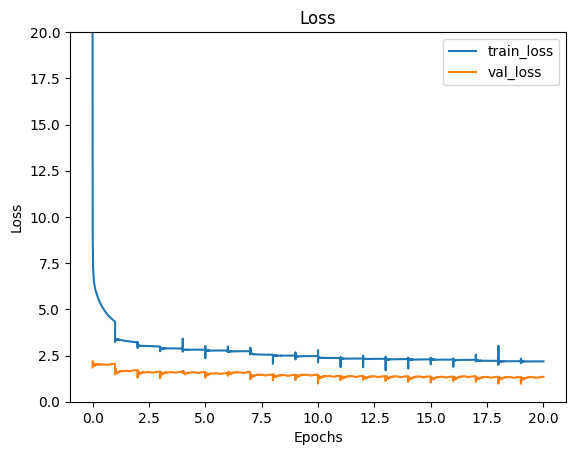

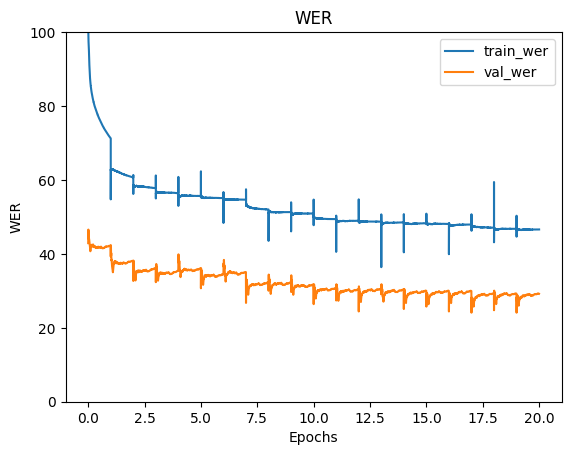

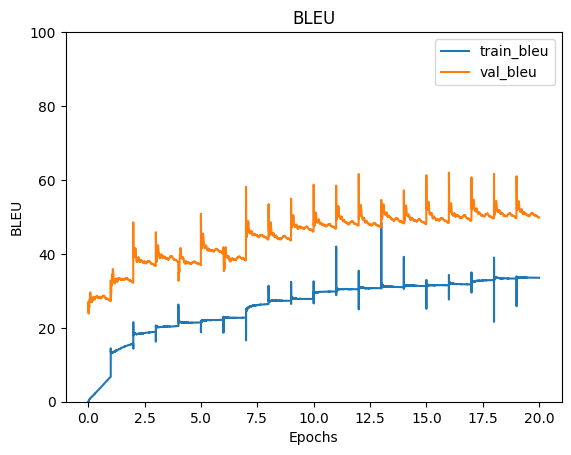

In [144]:
x = []
#print( len( history["train_loss"] ))
for i in range( len( history["train_loss"] )):
    x.append( i / 50000 )
    
v_x = []
#print( len( history["val_loss"]) )
for i in range( len( history["val_loss"]) ):
    v_x.append( i / 250 )

plt.title( "Loss")
plt.xlabel( "Epochs")
plt.ylabel( "Loss")
plt.plot(x, history["train_loss"], label="train_loss")
plt.plot( v_x, history["val_loss"], label="val_loss")
plt.ylim( 0, 20 )
plt.legend()
plt.show()

#plt.title( "Loss0")
#plt.xlabel( "Epochs")
#plt.ylabel( "Loss0")
#plt.plot(x, history["train_loss0"], label="train_loss0")
#plt.plot( v_x, history["val_loss0"], label="val_loss0")
#plt.ylim( 0, 10 )
#plt.legend()
#plt.show()

plt.title( "WER")
plt.xlabel( "Epochs")
plt.ylabel( "WER")
plt.plot(x, history["train_wer"], label="train_wer")
plt.plot( v_x, history["val_wer"], label="val_wer")
plt.ylim( 0, 100 )
plt.legend()
plt.show()

plt.title( "BLEU")
plt.xlabel( "Epochs")
plt.ylabel( "BLEU")
plt.plot(x, history["train_bleu"], label="train_bleu")
plt.plot( v_x, history["val_bleu"], label="val_bleu")
plt.ylim( 0, 100 )
plt.legend()
plt.show()

In [145]:
'''
test_text = "それは昭和初期の映画だと思います"
#日本語用のトークン変換関数を作成
j_t = Tokenizer()
def j_tokenizer(text): 
    return [tok for tok in j_t.tokenize(text, wakati=True)]

#test_text = "わたしは生きている"

test_text = j_tokenizer( test_text )

test_ids = [ idx_list[s] for s in test_text ]
test_ids.insert( 0, idx_list['<bos>'] )
test_ids.insert( 0, idx_list['<len>'] )
test_ids.append( idx_list['<eos>'])
'''
test_ids = [1, 6219, 64, 108, 8575, 9, 995, 628, 12749, 29, 5940, 133, 300, 42, 224, 46, 19, 2]

test_ids = torch.tensor( test_ids ).to( device )

sentence = [ token_list[str(i.item())] for i in test_ids ]

print( "sentence:", " ".join( sentence ))

test_ids = test_ids.unsqueeze( 0 )

#print( "test_ids:",test_ids )

# 正解の文字列を取得
caption = [1, 44, 4489, 6972, 1002, 32, 1513, 153, 15988, 11576, 13, 2]
reference = []
for m in caption:
    reference.append( token_list_en[str(m)])
    if m == idx_list_en['<eos>']:
        break    

print( "reference :", " ".join(reference))        

dec_input_lens = torch.ones( (test_ids.size(0) ) ) * test_ids.size(1)

#preds, lprobs, max_len, length_mask = inference( test_ids )
#preds, lprobs, max_len, length_mask = inference1( test_ids )
#preds, lprobs, max_len, length_mask = inference2( test_ids )
preds, _ = model( test_ids, dec_input_lens )

preds = torch.argmax( preds, dim = 2 )

#print( "preds:", preds )

#pred = preds.squeeze( 0 )

#print( "size of pred:", pred.size() )

#hypotheses = preds 

#bsz = test_ids.size(0)
#length_beam_size = 2

#hypotheses = hypotheses.view(bsz, length_beam_size, max_len)
#lprobs = lprobs.view(bsz, length_beam_size)
#tgt_lengths = (1 - length_mask).sum(-1)
#avg_log_prob = lprobs / tgt_lengths.float()
#best_lengths = avg_log_prob.max(-1)[1]
#hypotheses = torch.stack([hypotheses[b, l, :] for b, l in enumerate(best_lengths)], dim=0)

#print( "size of hypotheses:", hypotheses.size())
pred = torch.squeeze( preds, dim = 0 )

print( "size of pred:", pred.size())

#print( pred )

#sent = []
#for m in pred:
#    #print( m )
#    sent.append( token_list_en[str(int(m.item()))])
#    if token_list_en[str(int(m.item()))] == '<eos>':
#        break
        
sent = ctc_simple_decode( pred, token_list_en)
    
print( 'hypotheses:', ' '.join(sent) )

# 認識誤りを計算
(error, substitute, 
    delete, insert, ref_length) = \
    levenshtein.calculate_error(reference, sent)

#bleu = bleu_score.sentence_bleu( refs, sent, smoothing_function=fn)
#print( refs )
#print( hypotheses )
bleu = bleu_score.sentence_bleu( [reference], sent)
#bleu = bleu_score1( refs, sent )
#print( bleu )
#bleu = bleu_score.sentence_bleu( reference, sent)


print( "WER:", error / len( sent )  * 100, "BLEU:", bleu * 100 )

sentence: <bos> 完成 し た 石鹸 は 通気 性 包装 に 保管 する 必要 が あり ます 。 <eos>
reference : <bos> the finished soap must be stored in breathable packaging . <eos>
size of pred: torch.Size([36])
hypotheses: <bos> the finished soap should be stored in breathable packaging
WER: 30.0 BLEU: 53.875513386547794


In [91]:
test_dataset = SequenceDataset( "20240531_ntt_ids_test_auto.txt", pad_index_j=idx_list['<pad>'], pad_index_e=idx_list_en['<pad>'] )

test_loader = DataLoader(test_dataset,
                        #batch_size=10,
                        batch_size=1,
                        shuffle=False,
                        num_workers=0)

n: 0
n: 1
n: 2
n: 3
n: 4
n: 5
n: 6
n: 7
n: 8
n: 9
n: 10
n: 11
n: 12
n: 13
n: 14
n: 15
n: 16
n: 17
n: 18
n: 19
n: 20
n: 21
n: 22
n: 23
n: 24
n: 25
n: 26
n: 27
n: 28
n: 29
n: 30
n: 31
n: 32
n: 33
n: 34
n: 35
n: 36
n: 37
n: 38
n: 39
n: 40
n: 41
n: 42
n: 43
n: 44
n: 45
n: 46
n: 47
n: 48
n: 49
n: 50
n: 51
n: 52
n: 53
n: 54
n: 55
n: 56
n: 57
n: 58
n: 59
n: 60
n: 61
n: 62
n: 63
n: 64
n: 65
n: 66
n: 67
n: 68
n: 69
n: 70
n: 71
n: 72
n: 73
n: 74
n: 75
n: 76
n: 77
n: 78
n: 79
n: 80
n: 81
n: 82
n: 83
n: 84
n: 85
n: 86
n: 87
n: 88
n: 89
n: 90
n: 91
n: 92
n: 93
n: 94
n: 95
n: 96
n: 97
n: 98
n: 99
n: 100
n: 101
n: 102
n: 103
n: 104
n: 105
n: 106
n: 107
n: 108
n: 109
n: 110
n: 111
n: 112
n: 113
n: 114
n: 115
n: 116
n: 117
n: 118
n: 119
n: 120
n: 121
n: 122
n: 123
n: 124
n: 125
n: 126
n: 127
n: 128
n: 129
n: 130
n: 131
n: 132
n: 133
n: 134
n: 135
n: 136
n: 137
n: 138
n: 139
n: 140
n: 141
n: 142
n: 143
n: 144
n: 145
n: 146
n: 147
n: 148
n: 149
n: 150
n: 151
n: 152
n: 153
n: 154
n: 155
n: 156
n: 157
n: 1

n: 2236
n: 2237
n: 2238
n: 2239
n: 2240
n: 2241
n: 2242
n: 2243
n: 2244
n: 2245
n: 2246
n: 2247
n: 2248
n: 2249
n: 2250
n: 2251
n: 2252
n: 2253
n: 2254
n: 2255
n: 2256
n: 2257
n: 2258
n: 2259
n: 2260
n: 2261
n: 2262
n: 2263
n: 2264
n: 2265
n: 2266
n: 2267
n: 2268
n: 2269
n: 2270
n: 2271
n: 2272
n: 2273
n: 2274
n: 2275
n: 2276
n: 2277
n: 2278
n: 2279
n: 2280
n: 2281
n: 2282
n: 2283
n: 2284
n: 2285
n: 2286
n: 2287
n: 2288
n: 2289
n: 2290
n: 2291
n: 2292
n: 2293
n: 2294
n: 2295
n: 2296
n: 2297
n: 2298
n: 2299
n: 2300
n: 2301
n: 2302
n: 2303
n: 2304
n: 2305
n: 2306
n: 2307
n: 2308
n: 2309
n: 2310
n: 2311
n: 2312
n: 2313
n: 2314
n: 2315
n: 2316
n: 2317
n: 2318
n: 2319
n: 2320
n: 2321
n: 2322
n: 2323
n: 2324
n: 2325
n: 2326
n: 2327
n: 2328
n: 2329
n: 2330
n: 2331
n: 2332
n: 2333
n: 2334
n: 2335
n: 2336
n: 2337
n: 2338
n: 2339
n: 2340
n: 2341
n: 2342
n: 2343
n: 2344
n: 2345
n: 2346
n: 2347
n: 2348
n: 2349
n: 2350
n: 2351
n: 2352
n: 2353
n: 2354
n: 2355
n: 2356
n: 2357
n: 2358
n: 2359
n: 2360


In [146]:
model.eval()
print("Test")

n = 0
total_error0 = 0
total_token_length0 = 0
total_bleu0 = 0
for i, (text, label, text_len, target_len) in enumerate(test_loader):
    #if i > 100:
    #if i > 10:
    if i > 50:
    #if i > 4000:
        break
    text, label, text_len, target_len = text.to(device), label.to(device), text_len.to(device), target_len.to(device)
    #print( "val i:", i )

    with torch.no_grad():

        preds, _ = model( text, text_len )
        preds = torch.argmax( preds, dim = 2 )
        hypotheses = preds
  
    n2 = 0
    jap_sentence = []
    hypo_sentence = []
    ref_sentence = []
    total_error = 0
    total_token_length = 0
    test_loss = 0
    total_bleu = 0
    for hypo_id, caption, japa in zip( hypotheses, label, text):

        jap = []
        for m in japa:
            jap.append( token_list[str(m.item())])
            if m == idx_list['<eos>']:
                break
        #hypo = []
        #for m in hypo_id:
        #    #if token_list_en[str(int(m.item()))] != '<eos>':
        #    hypo.append(token_list_en[str(int(m.item()))])
        #    if m == idx_list_en['<eos>'] or m == idx_list_en['<pad>']:
        #    #if m == idx_list_en['<pad>']:
        #        break
        hypo = ctc_simple_decode( hypo_id, token_list_en)
        # 正解の文字列を取得
        reference = []
        for m in caption:
            reference.append( token_list_en[str(m.item())])
            if m == idx_list_en['<eos>']:
                break
                        
        # 認識誤りを計算
        (error, substitute, 
            delete, insert, ref_length) = \
            levenshtein.calculate_error(hypo,reference)

        bleu = bleu_score.sentence_bleu( [reference], hypo )

        
        total_bleu += bleu
        total_bleu0 += bleu
        total_error += error
        total_error0 += error
        total_token_length += ref_length
        total_token_length0 += ref_length

        jap_sentence.append( ''.join(jap))
        hypo_sentence.append( ' '.join(hypo) )
        ref_sentence.append( ' '.join(reference ) )
                    
        n2 += 1
        n += 1
        
       
    #if i % 200 == 199:
    print(f"index:{i+1}  WER: {total_error / total_token_length * 100:.10f}")
    print(f"index:{i+1}  BLEU:{total_bleu / n2 * 100: 10f}")
    for i2, (hypo_s, refe_s, jap_s ) in enumerate( zip( hypo_sentence, ref_sentence, jap_sentence ) ):
        print( "japa:", jap_s)
        print( "refe:", refe_s)
        print( "hypo:", hypo_s )

        
print(f"index:{i+1}  WER0: {total_error0 / total_token_length0 * 100:.10f}")
print(f"index:{i+1}  BLEU0:{total_bleu0 / n * 100: 10f}")


Test
index:1  WER: 8.3333333333
index:1  BLEU: 73.488892
japa: <bos>完成した石鹸は通気性包装に保管する必要があります。<eos>
refe: <bos> the finished soap must be stored in breathable packaging . <eos>
hypo: <bos> the finished soap should be stored in breathable packaging . <eos>
index:2  WER: 35.7142857143
index:2  BLEU: 25.400290
japa: <bos>そのような困難な仕事を占めた最初の会社はバッファローでした。<eos>
refe: <bos> the first company that occupied such a difficult task was buffalo . <eos>
hypo: <bos> the first company who occupied such difficult work was buffer low . <eos>
index:3  WER: 8.3333333333
index:3  BLEU: 73.488892
japa: <bos>最初の評議会は6月末にハッチングします。<eos>
refe: <bos> the first council hatches at the end of june . <eos>
hypo: <bos> the first council hatching at the end of june . <eos>
index:4  WER: 9.0909090909
index:4  BLEU: 81.761290
japa: <bos>最初に炭水化物、タンパク質、脂肪を含む。<eos>
refe: <bos> the first includes carbohydrates , proteins , fats . <eos>
hypo: <bos> first includes carbohydrates , proteins , fats . <eos>
index:5  WER: 20.000000000

index:31  WER: 28.5714285714
index:31  BLEU:  0.000000
japa: <bos>ネジ山の基礎は最も合理的なデザインです。<eos>
refe: <bos> the foundation on the screw piles is the most rational design . <eos>
hypo: <bos> the basis of the screw is the most reasonable design . <eos>
index:32  WER: 6.6666666667
index:32  BLEU: 81.535510
japa: <bos>フレームが内側にノックアウトされており、釘は外側に曲がっています。<eos>
refe: <bos> the frame is knocked out inside , and nails are bent outside . <eos>
hypo: <bos> the frame is knocked out inside , and the nails are bent outside . <eos>
index:33  WER: 13.3333333333
index:33  BLEU: 61.047358
japa: <bos>フレームワークはボードや木の杭の冬に設置されています。<eos>
refe: <bos> the framework is installed for the winter of boards or wooden piles . <eos>
hypo: <bos> the framework is installed in the winter of boards or wooden pile . <eos>
index:34  WER: 51.8518518519
index:34  BLEU: 21.909989
japa: <bos>無料版にはカレンダーモジュールを搭載したモダンなスキャナが含まれています。 これにより、疑わしいファイルを監視するための検疫モジュール、検証レポートのログ、および約500,000の署名を含む巨大なベースの検疫モジュールがあります。<eos>
refe: <bos> the free ve